<a href="https://colab.research.google.com/github/nattntn/OPG-SHAPer_WebApp/blob/main/OPG_SHAPer_Age_version1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SHAP

## Import data set (เรียกใช้ CSV)

In [1]:
import pandas as pd
import shutil

In [2]:
#เชื่อม google drive
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


## เลือกข้อมูล ทำ Background data ของ data train

In [3]:
dt_train = pd.read_csv (r'/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Model/Multi_task(Age)(7-25)/Table_train_Predict.csv')
dt_train

,Unnamed: 0,Age(year),Gender,Folder_type,Folder_name,Path_Name,Filename,Fold,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V1.jpg,2,0,Female,7.107492,7.0,0.000003,Female,0.0
1,1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV1.jpg,4,0,Female,7.020138,7.0,0.000025,Female,0.0
2,2,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V2.jpg,10,0,Female,6.975561,7.0,0.000808,Female,0.0
3,3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV2.jpg,9,0,Female,6.938187,7.0,0.000107,Female,0.0
4,4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V3.jpg,10,0,Female,6.916692,7.0,0.000014,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4184,4184,25,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J375.jpg,3,1,Male,25.299234,25.0,0.999988,Male,1.0
4185,4185,25,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J437.jpg,5,1,Male,24.729193,25.0,0.999987,Male,1.0
4186,4186,25,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J480.jpg,5,1,Male,24.564425,25.0,1.000000,Male,1.0
4187,4187,25,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J491.jpg,6,1,Male,24.113144,24.0,1.000000,Male,1.0


In [4]:
df = dt_train.drop(dt_train.columns[0], axis=1)
df

,Age(year),Gender,Folder_type,Folder_name,Path_Name,Filename,Fold,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V1.jpg,2,0,Female,7.107492,7.0,0.000003,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV1.jpg,4,0,Female,7.020138,7.0,0.000025,Female,0.0
2,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V2.jpg,10,0,Female,6.975561,7.0,0.000808,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV2.jpg,9,0,Female,6.938187,7.0,0.000107,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V3.jpg,10,0,Female,6.916692,7.0,0.000014,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4184,25,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J375.jpg,3,1,Male,25.299234,25.0,0.999988,Male,1.0
4185,25,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J437.jpg,5,1,Male,24.729193,25.0,0.999987,Male,1.0
4186,25,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J480.jpg,5,1,Male,24.564425,25.0,1.000000,Male,1.0
4187,25,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J491.jpg,6,1,Male,24.113144,24.0,1.000000,Male,1.0


In [5]:
# นับรูป
# Get unique age values
unique_ages = dt_train['Age(year)'].unique()

# Iterate through unique ages and calculate shape for 'M' gender
for age in unique_ages:
    shape = dt_train[(dt_train['Age(year)'] == age) & (dt_train['Gender'] == 'M')].shape
    print(f"Age {age}: {shape}")

# Get unique age values
unique_ages = dt_train['Age(year)'].unique()

# Iterate through unique ages and calculate shape for 'F' gender
for age in unique_ages:
    shape = dt_train[(dt_train['Age(year)'] == age) & (dt_train['Gender'] == 'F')].shape
    print(f"Age {age}: {shape}")

Age 7: (111, 15)
Age 8: (116, 15)
Age 9: (122, 15)
Age 10: (114, 15)
Age 11: (114, 15)
Age 12: (119, 15)
Age 13: (106, 15)
Age 14: (110, 15)
Age 15: (110, 15)
Age 16: (112, 15)
Age 17: (107, 15)
Age 18: (104, 15)
Age 19: (107, 15)
Age 20: (105, 15)
Age 21: (107, 15)
Age 22: (97, 15)
Age 23: (108, 15)
Age 24: (104, 15)
Age 25: (96, 15)
Age 7: (114, 15)
Age 8: (116, 15)
Age 9: (120, 15)
Age 10: (116, 15)
Age 11: (117, 15)
Age 12: (117, 15)
Age 13: (108, 15)
Age 14: (113, 15)
Age 15: (117, 15)
Age 16: (118, 15)
Age 17: (112, 15)
Age 18: (128, 15)
Age 19: (115, 15)
Age 20: (99, 15)
Age 21: (100, 15)
Age 22: (105, 15)
Age 23: (101, 15)
Age 24: (91, 15)
Age 25: (113, 15)


In [6]:
# เลือกรูปจาก train มาทำ bg data
import pandas as pd
import random

# Sample DataFrame (replace this with your actual DataFrame)
data = {
    'Age(year)': dt_train['Age(year)'],
    'Gender': dt_train['Gender'],
    'Folder_type': dt_train['Folder_type'],
    'Folder_name': dt_train['Folder_name'],
    'Path_Name': dt_train['Path_Name'],
    'Filename': dt_train['Filename'],
}

df = pd.DataFrame(data)

# Calculate the desired number of rows per unique age
desired_per_age = 2660 // (25 - 7 + 1)

# Initialize a list to store selected rows
selected_rows = []

# Iterate through unique age values
for age in range(7, 26):
    # Get all rows with the current age
    age_rows = df[df['Age(year)'] == age]

    # Randomly shuffle the rows for this age
    age_rows = age_rows.sample(frac=1, random_state=42)

    # Determine the number of rows to select for each gender
    rows_per_gender = desired_per_age // 2

    # Select rows for both "Male" and "Female" genders
    selected_male_rows = age_rows[age_rows['Gender'] == 'M'].head(rows_per_gender)
    selected_female_rows = age_rows[age_rows['Gender'] == 'F'].head(rows_per_gender)

    # Append the selected rows to the list
    selected_rows.extend([selected_male_rows, selected_female_rows])

# Concatenate the selected rows for each age into a final DataFrame
selected_dft = pd.concat(selected_rows)

# Now, selected_df contains 950 rows with an approximately even distribution of ages from 7 to 25
# and an equal number of "Male" and "Female" samples for each age.


In [7]:
selected_dft

,Age(year),Gender,Folder_type,Folder_name,Path_Name,Filename
184,7,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,VV116.jpg
120,7,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,VV13.jpg
207,7,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipVV244.jpg
148,7,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,VV50.jpg
214,7,M,Normal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipVV28.jpg
...,...,...,...,...,...,...
4050,25,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J245.jpg
4044,25,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J218.jpg
4024,25,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J148.jpg
4020,25,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J144.jpg


In [8]:
#selected_dft.to_csv('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Model/Multi_task(Age)(7-25)/Bg_train.csv')  # Setting index=False to avoid saving the row numbers as a column

In [9]:
# Get unique age values
unique_ages = selected_dft['Age(year)'].unique()

# Iterate through unique ages and calculate shape for 'M' gender
for age in unique_ages:
    shape = selected_dft[(selected_dft['Age(year)'] == age) & (selected_dft['Gender'] == 'M')].shape
    print(f"Age {age}: {shape}")

# Get unique age values
unique_ages = selected_dft['Age(year)'].unique()

# Iterate through unique ages and calculate shape for 'F' gender
for age in unique_ages:
    shape = selected_dft[(selected_dft['Age(year)'] == age) & (selected_dft['Gender'] == 'F')].shape
    print(f"Age {age}: {shape}")

Age 7: (70, 6)
Age 8: (70, 6)
Age 9: (70, 6)
Age 10: (70, 6)
Age 11: (70, 6)
Age 12: (70, 6)
Age 13: (70, 6)
Age 14: (70, 6)
Age 15: (70, 6)
Age 16: (70, 6)
Age 17: (70, 6)
Age 18: (70, 6)
Age 19: (70, 6)
Age 20: (70, 6)
Age 21: (70, 6)
Age 22: (70, 6)
Age 23: (70, 6)
Age 24: (70, 6)
Age 25: (70, 6)
Age 7: (70, 6)
Age 8: (70, 6)
Age 9: (70, 6)
Age 10: (70, 6)
Age 11: (70, 6)
Age 12: (70, 6)
Age 13: (70, 6)
Age 14: (70, 6)
Age 15: (70, 6)
Age 16: (70, 6)
Age 17: (70, 6)
Age 18: (70, 6)
Age 19: (70, 6)
Age 20: (70, 6)
Age 21: (70, 6)
Age 22: (70, 6)
Age 23: (70, 6)
Age 24: (70, 6)
Age 25: (70, 6)


## เลือกข้อมูล ทำ Background data ของ data test

In [10]:
df_test_age = pd.read_csv (r'/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Model/Multi_task(Age)(7-25)/Table_test_Predict.csv')
df_test_age = df_test_age.iloc[:,1:]
print(df_test_age.shape)
df_test_age

(943, 13)


,Age(year),Gender,Folder_type,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V69.jpg,0,Female,7.423399,7.0,5.141945e-03,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV69.jpg,0,Female,7.415316,7.0,4.618836e-02,Female,0.0
2,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V70.jpg,0,Female,7.548301,8.0,6.406498e-03,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV70.jpg,0,Female,7.492433,7.0,2.021052e-05,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V74.jpg,0,Female,7.343049,7.0,2.091009e-02,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
938,25,F,Abnormal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J132.jpg,0,Female,21.686228,22.0,1.800820e-05,Female,0.0
939,25,F,Abnormal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J145.jpg,0,Female,21.118502,21.0,1.193671e-01,Female,0.0
940,25,F,Abnormal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J149.jpg,0,Female,19.639433,20.0,1.212668e-03,Female,0.0
941,25,F,Abnormal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J158.jpg,0,Female,21.359797,21.0,3.044503e-09,Female,0.0


In [11]:
df_test_age['Age_predict_int'] = df_test_age['Age_predict_int'].astype(int)
df_test_age

,Age(year),Gender,Folder_type,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V69.jpg,0,Female,7.423399,7,5.141945e-03,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV69.jpg,0,Female,7.415316,7,4.618836e-02,Female,0.0
2,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V70.jpg,0,Female,7.548301,8,6.406498e-03,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV70.jpg,0,Female,7.492433,7,2.021052e-05,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V74.jpg,0,Female,7.343049,7,2.091009e-02,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
938,25,F,Abnormal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J132.jpg,0,Female,21.686228,22,1.800820e-05,Female,0.0
939,25,F,Abnormal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J145.jpg,0,Female,21.118502,21,1.193671e-01,Female,0.0
940,25,F,Abnormal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J149.jpg,0,Female,19.639433,20,1.212668e-03,Female,0.0
941,25,F,Abnormal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J158.jpg,0,Female,21.359797,21,3.044503e-09,Female,0.0


In [12]:
# เลือกที่อายุตรงกัน
e = df_test_age[df_test_age['Age(year)'] == df_test_age['Age_predict_int']]
e

,Age(year),Gender,Folder_type,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V69.jpg,0,Female,7.423399,7,0.005142,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV69.jpg,0,Female,7.415316,7,0.046188,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV70.jpg,0,Female,7.492433,7,0.000020,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V74.jpg,0,Female,7.343049,7,0.020910,Female,0.0
5,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV74.jpg,0,Female,7.095627,7,0.003455,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
921,12,M,Abnormal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,OO98.jpg,1,Male,12.105593,12,0.044166,Female,0.0
922,14,F,Abnormal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipY95.jpg,0,Female,14.101776,14,0.000650,Female,0.0
923,14,F,Abnormal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipY187.jpg,0,Female,13.616200,14,0.978944,Male,1.0
924,14,F,Abnormal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,Y100.jpg,0,Female,14.041607,14,0.000008,Female,0.0


In [13]:
e = e.sort_values(by='Age(year)', kind='mergesort')
e

,Age(year),Gender,Folder_type,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V69.jpg,0,Female,7.423399,7,0.005142,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV69.jpg,0,Female,7.415316,7,0.046188,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV70.jpg,0,Female,7.492433,7,0.000020,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V74.jpg,0,Female,7.343049,7,0.020910,Female,0.0
5,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV74.jpg,0,Female,7.095627,7,0.003455,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
760,22,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipU422.jpg,1,Male,22.010904,22,0.999999,Male,1.0
765,22,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,U292.jpg,1,Male,21.844440,22,0.999998,Male,1.0
809,23,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,E356.jpg,1,Male,22.836693,23,0.999958,Male,1.0
880,25,F,Normal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipJ71.jpg,0,Female,24.869873,25,1.000000,Male,1.0


In [14]:
e['Age(year)'].unique()

array([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
       25])

In [15]:
selected_test = e
selected_test

,Age(year),Gender,Folder_type,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V69.jpg,0,Female,7.423399,7,0.005142,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV69.jpg,0,Female,7.415316,7,0.046188,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV70.jpg,0,Female,7.492433,7,0.000020,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V74.jpg,0,Female,7.343049,7,0.020910,Female,0.0
5,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV74.jpg,0,Female,7.095627,7,0.003455,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
760,22,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipU422.jpg,1,Male,22.010904,22,0.999999,Male,1.0
765,22,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,U292.jpg,1,Male,21.844440,22,0.999998,Male,1.0
809,23,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,E356.jpg,1,Male,22.836693,23,0.999958,Male,1.0
880,25,F,Normal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipJ71.jpg,0,Female,24.869873,25,1.000000,Male,1.0


## Create background

In [16]:
def process_input(dt_train):
    # Initialize an empty list to store background data
    background_data = []

    # Ensure 'Path_Name' column exists in the DataFrame
    if 'Path_Name' not in dt_train.columns:
        raise ValueError("The 'Path_Name' column does not exist in the DataFrame.")

    # Loop to preprocess and create the background data
    for i in range(len(dt_train)):
        print(f"Processing image {i+1}/{len(dt_train)}")
        # Get the image path from the DataFrame
        image_path = dt_train['Path_Name'].iloc[i]  # Use .iloc to access rows by integer index
        # Load and preprocess the image
        image = load_img(image_path, target_size=(224, 224))  # Adjust target_size
        preprocessed_image = img_to_array(image) / 255.0  # Normalize pixel values

        # Add the preprocessed image to the background_data list
        background_data.append(preprocessed_image)

    return background_data

### data train

In [17]:
import pandas as pd
import numpy as np
import torch
from tensorflow.keras.preprocessing.image import load_img, img_to_array

In [18]:
sdf_train = selected_dft.sort_values(by='Age(year)', kind='mergesort')
sdf_train

,Age(year),Gender,Folder_type,Folder_name,Path_Name,Filename
184,7,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,VV116.jpg
120,7,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,VV13.jpg
207,7,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipVV244.jpg
148,7,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,VV50.jpg
214,7,M,Normal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipVV28.jpg
...,...,...,...,...,...,...
4050,25,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J245.jpg
4044,25,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J218.jpg
4024,25,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J148.jpg
4020,25,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,J144.jpg


In [19]:
sdf_train['Age(year)'].unique()

array([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
       24, 25])

In [20]:
background_train = process_input(sdf_train)

Processing image 1/2660
Processing image 2/2660
Processing image 3/2660
Processing image 4/2660
Processing image 5/2660
Processing image 6/2660
Processing image 7/2660
Processing image 8/2660
Processing image 9/2660
Processing image 10/2660
Processing image 11/2660
Processing image 12/2660
Processing image 13/2660
Processing image 14/2660
Processing image 15/2660
Processing image 16/2660
Processing image 17/2660
Processing image 18/2660
Processing image 19/2660
Processing image 20/2660
Processing image 21/2660
Processing image 22/2660
Processing image 23/2660
Processing image 24/2660
Processing image 25/2660
Processing image 26/2660
Processing image 27/2660
Processing image 28/2660
Processing image 29/2660
Processing image 30/2660
Processing image 31/2660
Processing image 32/2660
Processing image 33/2660
Processing image 34/2660
Processing image 35/2660
Processing image 36/2660
Processing image 37/2660
Processing image 38/2660
Processing image 39/2660
Processing image 40/2660
Processin

### data test

In [21]:
print(selected_test.shape)
selected_test.head()

(291, 13)


,Age(year),Gender,Folder_type,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V69.jpg,0,Female,7.423399,7,0.005142,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV69.jpg,0,Female,7.415316,7,0.046188,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV70.jpg,0,Female,7.492433,7,0.000020,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V74.jpg,0,Female,7.343049,7,0.020910,Female,0.0
5,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV74.jpg,0,Female,7.095627,7,0.003455,Female,0.0


In [22]:
sdf_test = selected_test.sort_values(by='Age(year)', kind='mergesort')
sdf_test

,Age(year),Gender,Folder_type,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V69.jpg,0,Female,7.423399,7,0.005142,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV69.jpg,0,Female,7.415316,7,0.046188,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV70.jpg,0,Female,7.492433,7,0.000020,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,V74.jpg,0,Female,7.343049,7,0.020910,Female,0.0
5,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipV74.jpg,0,Female,7.095627,7,0.003455,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
760,22,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipU422.jpg,1,Male,22.010904,22,0.999999,Male,1.0
765,22,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,U292.jpg,1,Male,21.844440,22,0.999998,Male,1.0
809,23,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,E356.jpg,1,Male,22.836693,23,0.999958,Male,1.0
880,25,F,Normal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipJ71.jpg,0,Female,24.869873,25,1.000000,Male,1.0


In [23]:
sdf_test = sdf_test.reset_index().iloc[:,1:]

In [24]:
sdf_test['Age(year)'].unique()

array([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
       25])

In [25]:
background_test = process_input(sdf_test)

Processing image 1/291
Processing image 2/291
Processing image 3/291
Processing image 4/291
Processing image 5/291
Processing image 6/291
Processing image 7/291
Processing image 8/291
Processing image 9/291
Processing image 10/291
Processing image 11/291
Processing image 12/291
Processing image 13/291
Processing image 14/291
Processing image 15/291
Processing image 16/291
Processing image 17/291
Processing image 18/291
Processing image 19/291
Processing image 20/291
Processing image 21/291
Processing image 22/291
Processing image 23/291
Processing image 24/291
Processing image 25/291
Processing image 26/291
Processing image 27/291
Processing image 28/291
Processing image 29/291
Processing image 30/291
Processing image 31/291
Processing image 32/291
Processing image 33/291
Processing image 34/291
Processing image 35/291
Processing image 36/291
Processing image 37/291
Processing image 38/291
Processing image 39/291
Processing image 40/291
Processing image 41/291
Processing image 42/291
P

In [26]:
print(type(background_test))

<class 'list'>


##**แปลง Bg dataเป็น array เพื่อใช้ในการคำนวณค่า SHAP**

In [27]:
background_train_array = np.array(background_train)
background_test_array = np.array(background_test)

In [28]:
print(len(background_train_array))
print(background_train_array.shape)
print(background_test_array.shape)

2660
(2660, 224, 224, 3)
(291, 224, 224, 3)


# คำนวณ SHAP Values

## load model

### Import

In [29]:
import os
import numpy as np
import pandas as pd
#import efficientnet.tfkeras
import tensorflow as tf
from tensorflow.keras.applications import EfficientNetB0

### กำหนดค่าพารามิเตอร์ (ตามที่กำหนดใน Model)


In [30]:
batch_size = 16
width = 224
height = 224
epochs = 250 # รอบในการเทรน
dropout_rate = 0.2
input_shape = (height, width, 3)

### Clone Efficient

In [31]:
#ดึงข้อมูลใน Github มาใช้
import os
%cd /content
if not os.path.isdir("efficientnet_keras_transfer_learning"):
 !git clone https://github.com/Wanita-8943/efficientnet_keras_transfer_learning
%cd efficientnet_keras_transfer_learning/


/content
Cloning into 'efficientnet_keras_transfer_learning'...
remote: Enumerating objects: 1100, done.
remote: Counting objects: 100% (263/263), done.
remote: Compressing objects: 100% (142/142), done.
remote: Total 1100 (delta 133), reused 241 (delta 121), pack-reused 837
Receiving objects: 100% (1100/1100), 14.10 MiB | 13.61 MiB/s, done.
Resolving deltas: 100% (630/630), done.
/content/efficientnet_keras_transfer_learning


### Load Model

In [32]:
import sys
sys.path.append('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Model/Multi_task(Age)(7-25)/16_Multi_8e-6_250_Unfreeze.h5')

from efficientnet.layers import Swish, DropConnect
from efficientnet.model import ConvKernalInitializer
from tensorflow.keras.utils import get_custom_objects

get_custom_objects().update({
    'ConvKernalInitializer': ConvKernalInitializer,
    'Swish': Swish,
    'DropConnect':DropConnect
})


In [33]:
from tensorflow.keras.models import load_model
model = tf.keras.models.load_model("/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Model/Multi_task(Age)(7-25)/16_Multi_8e-6_250_Unfreeze.h5")
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 112, 112, 32)         864       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 112, 112, 32)         128       ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 swish (Swish)               (None, 112, 112, 32)         0         ['batch_normalization[0][0

In [34]:
height = width = model.input_shape[1]
print(f"height: {height}, width: {width}")

height: 224, width: 224


In [35]:
# Check the number of output units in the final layer
num_output_units = model.layers[-1].output_shape[-1]

# Check if it's a binary classification model (2 output units) or not
if num_output_units == 2:
    print("This is a binary classification model.")
else:
    print("This is not a binary classification model.")

This is not a binary classification model.


## SHAP & YOLO

### SHAP

In [36]:
!pip install shap==0.44.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 535.7/535.7 kB 5.3 MB/s eta 0:00:00


In [37]:
import shap

In [38]:
print(background_test_array.shape)
print(background_test_array[[10]].shape) # ภาพที่ 10

(291, 224, 224, 3)
(1, 224, 224, 3)


In [39]:
model.output_names

['prediction_layer', 'prediction_layer2']

In [40]:
model.output_names[0] # age estimation

'prediction_layer'

In [41]:
model.output_names[1] # gender prediction

'prediction_layer2'

เลือกเฉพาะ Output layer ไปทำการหาความสำคัญ

In [42]:
import shap
import tensorflow as tf

# Create separate models for each output you want to explain
#AGE
model_layer1 = tf.keras.Model(inputs=model.input, outputs=model.get_layer('prediction_layer').output)
#Gender
model_layer2 = tf.keras.Model(inputs=model.input, outputs=model.get_layer('prediction_layer2').output)


In [43]:
# Define your explainer for the first output layer (prediction_layer)
#AGE
explainer_layer1 = shap.GradientExplainer(model_layer1, background_train_array)

In [44]:
# Define your explainer for the second output layer (prediction_layer2)
#Gender
explainer_layer2 = shap.GradientExplainer(model_layer2, background_train_array)

### yolo

In [45]:
# load YOLO ที่Train มา
# Replace with code to load your trained YOLO model
weights_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/papers/gpt/Yolo_v5/best.pt'

# Load YOLOv5 model from Google Drive
yolo_model = torch.hub.load('ultralytics/yolov5', 'custom', path=weights_path)

You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip


requirements: Ultralytics requirements ['gitpython>=3.1.30', 'pillow>=10.3.0'] not found, attempting AutoUpdate...
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 4.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 77.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 139.7 MB/s eta 0:00:00
  Attempting uninstall: pillow
    Found existing installation: Pillow 9.4.0
    Uninstalling Pillow-9.4.0:
      Successfully uninstalled Pillow-9.4.0

requirements: AutoUpdate success ✅ 17.6s, installed 2 packages: ['gitpython>=3.1.30', 'pillow>=10.3.0']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



YOLOv5 🚀 2024-5-7 Python-3.10.12 torch-2.2.1+cu121 CPU

Fusing layers... 
Model summary: 157 layers, 7064065 parameters, 0 gradients, 15.9 GFLOPs
Adding AutoShape... 


#### ทํา non maximum suppression

In [93]:
# import pandas as pd

# def compute_iou(boxA, boxB):
#     # Determine the coordinates of the intersection rectangle
#     xA = max(boxA[0], boxB[0])
#     yA = max(boxA[1], boxB[1])
#     xB = min(boxA[2], boxB[2])
#     yB = min(boxA[3], boxB[3])

#     # Compute the area of intersection
#     interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)

#     # Compute the area of both the prediction and ground-truth rectangles
#     boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
#     boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)

#     # Compute the intersection over union by taking the intersection
#     # area and dividing it by the sum of prediction + ground-truth
#     # areas - the interesection area
#     iou = interArea / float(boxAArea + boxBArea - interArea)

#     return iou

# def nms_per_class(df, iou_threshold=0.5):
#     # Initialize an empty DataFrame to store NMS results
#     df_nms = pd.DataFrame()

#     # Get unique class IDs
#     class_ids = df['class'].unique()

#     for class_id in class_ids:
#         # Filter detections by class
#         df_class = df[df['class'] == class_id].copy()

#         # Apply NMS
#         df_class_sorted = df_class.sort_values(by='confidence', ascending=False).reset_index(drop=True)
#         suppressed_indices = set()

#         for i in range(len(df_class_sorted)):
#             if i in suppressed_indices:
#                 continue

#             for j in range(i+1, len(df_class_sorted)):
#                 if j in suppressed_indices:
#                     continue

#                 boxA = df_class_sorted.iloc[i][['xmin', 'ymin', 'xmax', 'ymax']]
#                 boxB = df_class_sorted.iloc[j][['xmin', 'ymin', 'xmax', 'ymax']]

#                 if compute_iou(boxA, boxB) > iou_threshold:
#                     suppressed_indices.add(j)

#         # Filter out suppressed detections
#         df_nms_class = df_class_sorted.drop(index=list(suppressed_indices)).reset_index(drop=True)

#         # Append results for this class to the main DataFrame
#         df_nms = pd.concat([df_nms, df_nms_class], ignore_index=True)

#     return df_nms

In [227]:
# import pandas as pd

# def compute_iou(boxA, boxB):
#     # Determine the coordinates of the intersection rectangle
#     xA = max(boxA[0], boxB[0])
#     yA = max(boxA[1], boxB[1])
#     xB = min(boxA[2], boxB[2])
#     yB = min(boxA[3], boxB[3])

#     # Compute the area of intersection
#     interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)

#     # Compute the area of both the prediction and ground-truth rectangles
#     boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
#     boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)

#     # Compute the intersection over union (IoU)
#     iou = interArea / float(boxAArea + boxBArea - interArea)

#     return iou

# def nms_per_class(df, iou_threshold=0.5):
#     # Initialize an empty DataFrame to store NMS results and IoU values
#     df_nms = pd.DataFrame()

#     # Get unique class IDs
#     class_ids = df['class'].unique()

#     for class_id in class_ids:
#         # Filter detections by class
#         df_class = df[df['class'] == class_id].copy()

#         # Apply NMS
#         df_class_sorted = df_class.sort_values(by='confidence', ascending=False).reset_index(drop=True)
#         retained_indices = []
#         iou_values = []

#         # Collect IoU values and determine retained detections
#         for i in range(len(df_class_sorted)):
#             if i in retained_indices:
#                 continue

#             retained_indices.append(i)
#             iou_values.append(1.0)  # Default IoU value, replace with actual value

#             for j in range(i + 1, len(df_class_sorted)):
#                 if j in retained_indices:
#                     continue

#                 boxA = df_class_sorted.iloc[i][['xmin', 'ymin', 'xmax', 'ymax']]
#                 boxB = df_class_sorted.iloc[j][['xmin', 'ymin', 'xmax', 'ymax']]
#                 iou_value = compute_iou(boxA, boxB)

#                 if iou_value > iou_threshold:
#                     retained_indices.append(j)
#                     iou_values.append(iou_value)

#         # Filter out suppressed detections based on retained indices
#         df_nms_class = df_class_sorted.iloc[retained_indices].reset_index(drop=True)

#         # Add IoU values as a new column to the DataFrame
#         df_nms_class['iou'] = iou_values

#         # Append results for this class to the main DataFrame
#         df_nms = pd.concat([df_nms, df_nms_class], ignore_index=True)

#     return df_nms


In [241]:
import pandas as pd

def compute_iou(boxA, boxB):
    # Determine the coordinates of the intersection rectangle
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    # Compute the area of intersection
    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)

    # Compute the area of both the prediction and ground-truth rectangles
    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)

    # Compute the intersection over union (IoU)
    iou = interArea / float(boxAArea + boxBArea - interArea)

    return iou

def nms_per_class(df, iou_threshold=0.5):
    # Initialize an empty DataFrame to store NMS results and IoU values
    df_nms = pd.DataFrame()

    # Get unique class IDs
    class_ids = df['class'].unique()

    for class_id in class_ids:
        # Filter detections by class
        df_class = df[df['class'] == class_id].copy()

        # Apply NMS
        df_class_sorted = df_class.sort_values(by='confidence', ascending=False).reset_index(drop=True)
        retained_indices = []
        iou_values = []

        # Collect IoU values and determine retained detections
        for i in range(len(df_class_sorted)):
            if i in retained_indices:
                continue

            retained_indices.append(i)

            boxA = df_class_sorted.iloc[i][['xmin', 'ymin', 'xmax', 'ymax']]  # Predicted box
            iou_values.append(1.0)  # Placeholder for the first box (use 0.0 as the initial value)

            for j in range(i + 1, len(df_class_sorted)):
                if j in retained_indices:
                    continue

                boxB = df_class_sorted.iloc[j][['xmin', 'ymin', 'xmax', 'ymax']]  # Ground truth box
                iou_value = compute_iou(boxA, boxB)

                if iou_value > iou_threshold:
                    retained_indices.append(j)
                    iou_values.append(iou_value)

        # Filter out suppressed detections based on retained indices
        df_nms_class = df_class_sorted.iloc[retained_indices].reset_index(drop=True)

        # Add IoU values as a new column to the DataFrame
        df_nms_class['iou'] = iou_values

        # Append results for this class to the main DataFrame
        df_nms = pd.concat([df_nms, df_nms_class], ignore_index=True)

    return df_nms


#### def map box ที่ detectกับ SHAP value

##### pos img

In [224]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import pandas as pd
from PIL import Image
import numpy as np

def plot_bboxes_on_image_pos(image_path, df, grayscale_image):
    selected_bboxes = []  #สร้าง list ว่าง มาเก็บกล่องที่มีค่า SHAP เกิน IoU ที่ 0.1

    # Load the original image
    img = Image.open(image_path) #  เปิดภาพจาก path
    img_array = np.array(img)

    # Get the image dimensions
    image_width, image_height = img.size

    # Create figure and axes
    fig, ax = plt.subplots()

    # Display the original image
    ax.imshow(img)

    # Overlay the grayscale image with transparency // plot จากสีเทา ให้เป้นน สีแดง ทับลงไป
    ax.imshow(grayscale_image, cmap='Reds', alpha=0.6, extent=[0, image_width, image_height, 0])

    # Iterate over rows in the DataFrame
    for index, row in df.iterrows():  #df ที่ตัวแบบทนายมาทั้งหมด  จะทำการ loop เก็บค่าตห.จากตาราง
        xmin, ymin, xmax, ymax = row['xmin'], row['ymin'], row['xmax'], row['ymax']
        confidence, class_label,class_name,IoU = row['confidence'], row['class'],row['name'],row['iou']

        # Convert coordinates to absolute values // เปลี่ยนจากตห.ของกล่อง ให้ตามขนาดภาพที่ใส่เข้าไป (ม้้ง)
        abs_xmin = xmin * image_width
        abs_ymin = ymin * image_height
        abs_width = (xmax - xmin) * image_width
        abs_height = (ymax - ymin) * image_height

        # Map bounding box to the grayscale image //คำนวณบริเวณที่สินใจ
        # Calculate the region of interest in the grayscale image
        roi_xmin = int(xmin * grayscale_image.shape[1]) # แปลงพิกัดกรอบสีเหลี่ยมให้เข้ากับขนาดรูปภาพ โดย *พิกัด กับขนาดของ grayscale_image
        roi_ymin = int(ymin * grayscale_image.shape[0])
        roi_xmax = int(xmax * grayscale_image.shape[1])
        roi_ymax = int(ymax * grayscale_image.shape[0])

        # Extract the region of interest from the grayscale image
        roi = grayscale_image[roi_ymin:roi_ymax, roi_xmin:roi_xmax] # เลือก roi บริเวณที่สนใจ  จากgrayscale_image โดยตัด roi ออกมาเป็น nparray

        # Calculate the percentage of nonzero pixels
        nonzero_percentage = np.count_nonzero(roi) / (roi.shape[0] * roi.shape[1]) #Calculate the percentage ของ pixels ที่ไม่เป็น 0 แล้วหารด้วย pixels ทั้งหมด

        # If the percentage of nonzero pixels exceeds 10%, collect the bounding box
        if nonzero_percentage > 0.1:
            # Add bounding box information to the selected_bboxes list
            selected_bboxes.append({'xmin': abs_xmin, 'ymin': abs_ymin,'xmax': abs_xmin + abs_width, 'ymax': abs_ymin + abs_height,
                                    'confidence': confidence, 'class': class_label,'name':class_name, 'iou':IoU})

            # Create a rectangle patch //สร้างกล่อง
            rect = patches.Rectangle(
                (abs_xmin, abs_ymin), #abs แปลงเป็นพิกัดในหน่วย  pixel ให้ตรงกับขนาดภาพจริง
                abs_width,
                abs_height,
                linewidth=2,
                edgecolor='r', # เปลี่ยนสีกล่อง
                facecolor='none'  # Set facecolor to 'none' for an unfilled rectangle
            )

            # Add the rectangle to the axes
            ax.add_patch(rect)
            # Add confidence and class label as text
            text = f'Class: {class_label}' # ข้อความที่จะ Plot บนกล่อง
            #\nConfidence: {confidence:.2f}'
            plt.text(abs_xmin, abs_ymin - 10, text, color='black', fontsize=8, bbox=dict(facecolor='white', alpha=0.5)) # ตห + สีของตัวอักษร ขนาด front


    # Show the plot
    plt.show()

    return selected_bboxes

##### neg img

In [225]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import pandas as pd
from PIL import Image
import numpy as np

def plot_bboxes_on_image_neg(image_path, df, grayscale_image):
    selected_bboxes = []

    # Load the original image
    img = Image.open(image_path)
    img_array = np.array(img)

    # Get the image dimensions
    image_width, image_height = img.size

    # Create figure and axes
    fig, ax = plt.subplots()

    # Display the original image
    ax.imshow(img)

    # Overlay the grayscale image with transparency
    ax.imshow(grayscale_image, cmap='Blues', alpha=0.6, extent=[0, image_width, image_height, 0])

    # Iterate over rows in the DataFrame
    for index, row in df.iterrows():
        xmin, ymin, xmax, ymax = row['xmin'], row['ymin'], row['xmax'], row['ymax']
        confidence, class_label,class_name,IoU = row['confidence'], row['class'],row['name'],row['iou']

        # Convert coordinates to absolute values
        abs_xmin = xmin * image_width
        abs_ymin = ymin * image_height
        abs_width = (xmax - xmin) * image_width
        abs_height = (ymax - ymin) * image_height

        # Map bounding box to the grayscale image
        # Calculate the region of interest in the grayscale image
        roi_xmin = int(xmin * grayscale_image.shape[1])
        roi_ymin = int(ymin * grayscale_image.shape[0])
        roi_xmax = int(xmax * grayscale_image.shape[1])
        roi_ymax = int(ymax * grayscale_image.shape[0])

        # Extract the region of interest from the grayscale image
        roi = grayscale_image[roi_ymin:roi_ymax, roi_xmin:roi_xmax]

        # Calculate the percentage of nonzero pixels
        nonzero_percentage = np.count_nonzero(roi) / (roi.shape[0] * roi.shape[1])

        # If the percentage of nonzero pixels exceeds 10%, collect the bounding box#เลือกกล่องที่มีค่า shap ในกล่องมากกว่า 10% ของทั้งหมด
        if nonzero_percentage > 0.1:
            # Add bounding box information to the selected_bboxes list
            selected_bboxes.append({'xmin': abs_xmin, 'ymin': abs_ymin,'xmax': abs_xmin + abs_width, 'ymax': abs_ymin + abs_height,
                                    'confidence': confidence, 'class': class_label,'name':class_name, 'iou':IoU})

            # Create a rectangle patch
            rect = patches.Rectangle(
                (abs_xmin, abs_ymin),
                abs_width,
                abs_height,
                linewidth=2,
                edgecolor='b',
                facecolor='none'  # Set facecolor to 'none' for an unfilled rectangle
            )

            # Add the rectangle to the axes
            ax.add_patch(rect)
            # Add confidence and class label as text
            text = f'Class: {class_label}'
            #\nConfidence: {confidence:.2f}'
            plt.text(abs_xmin, abs_ymin - 10, text, color='black', fontsize=8, bbox=dict(facecolor='white', alpha=0.5))


    # Show the plot
    plt.show()

    return selected_bboxes

# หลายภาพ

In [96]:
from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import io

In [97]:
sdf_test[['Path_Name']]

,Path_Name
0,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
1,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
2,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
3,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
4,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
...,...
286,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
287,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
288,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
289,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...


In [98]:
file_paths = pd.Series([
    '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/V69.jpg',
    '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/FlipV69.jpg',
    '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/FlipV70.jpg',
    '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/V74.jpg',
    '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/FlipV74.jpg'
])

In [99]:
# Iterate over each file path in the Series
for index, file_path in file_paths.items():
    print(f"Processing image {index}: {file_path}")

Processing image 0: /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/V69.jpg
Processing image 1: /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/FlipV69.jpg
Processing image 2: /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/FlipV70.jpg
Processing image 3: /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/V74.jpg
Processing image 4: /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/FlipV74.jpg


Processing image 0: /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/V69.jpg


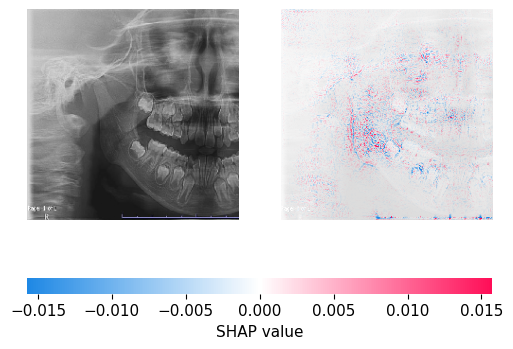

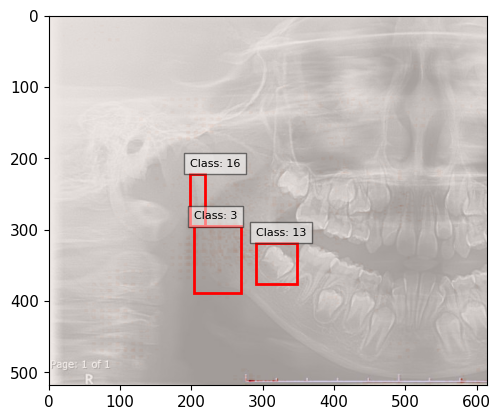

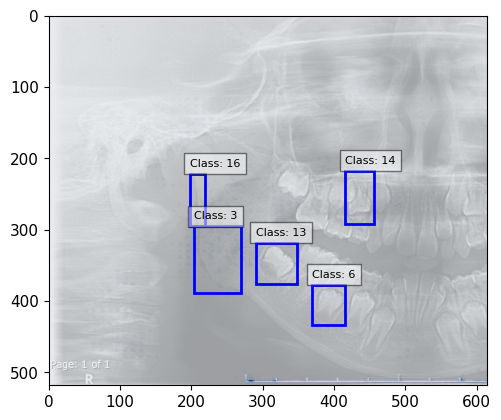

Processing image 1: /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/FlipV69.jpg


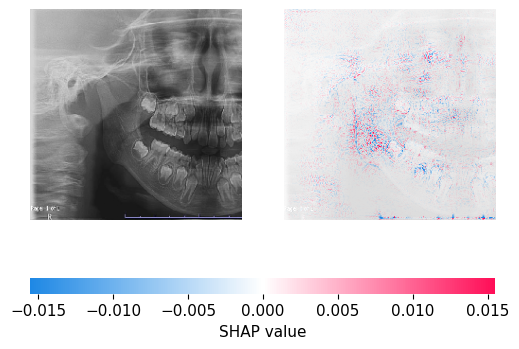

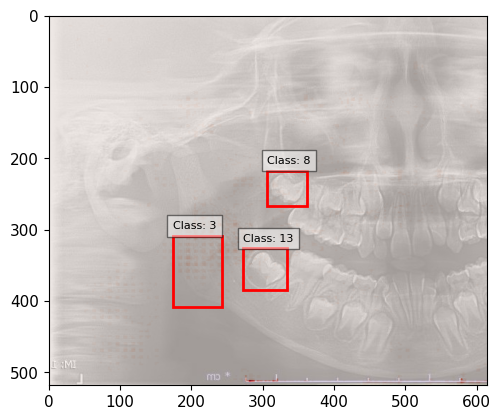

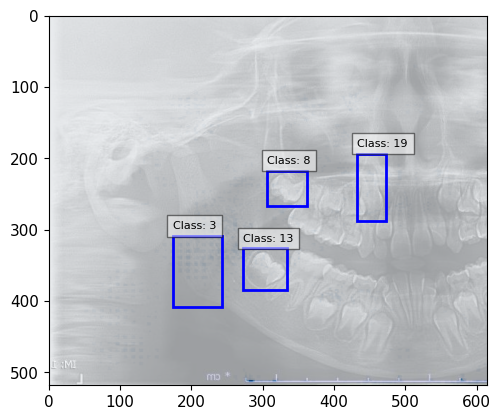

Processing image 2: /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/FlipV70.jpg


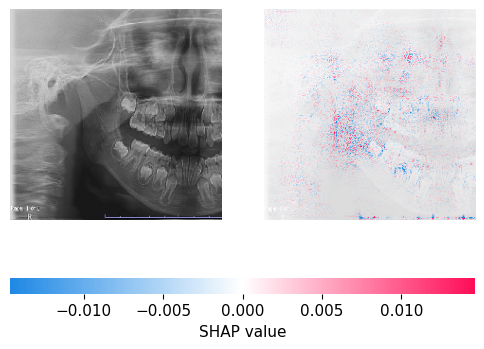

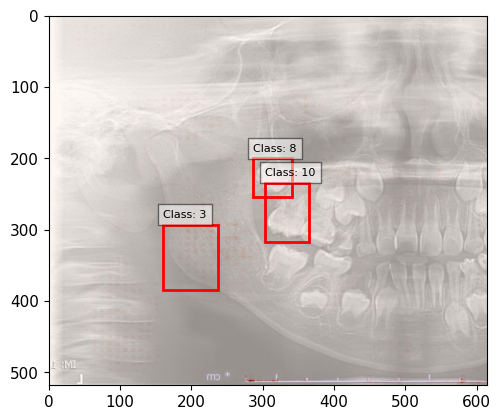

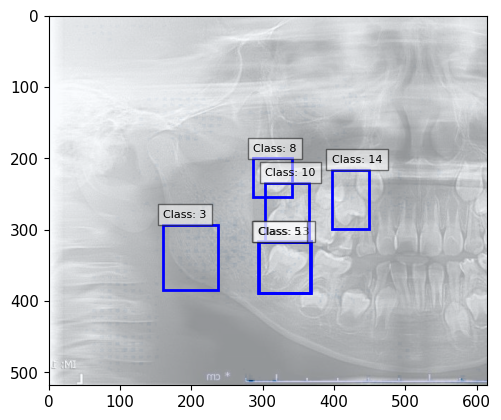

Processing image 3: /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/V74.jpg


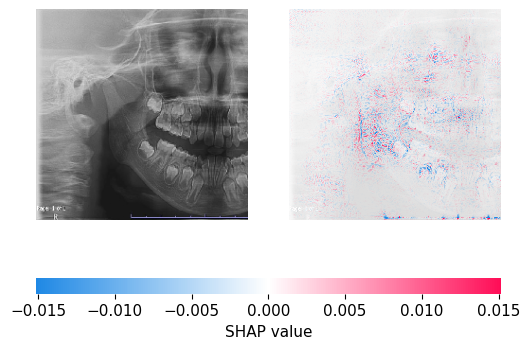

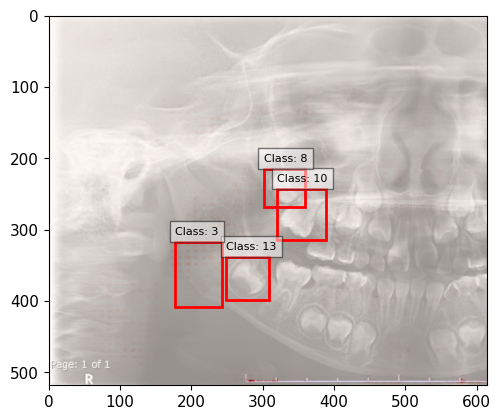

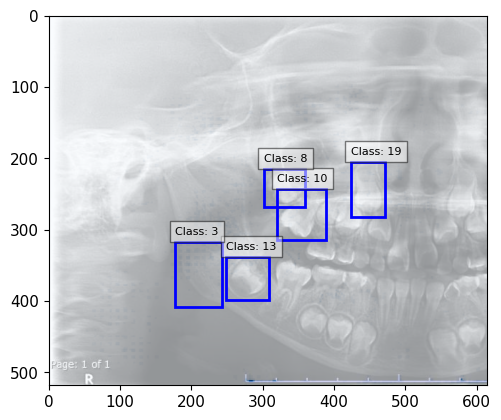

Processing image 4: /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/FlipV74.jpg


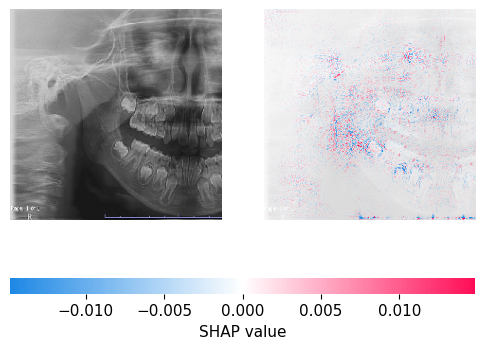

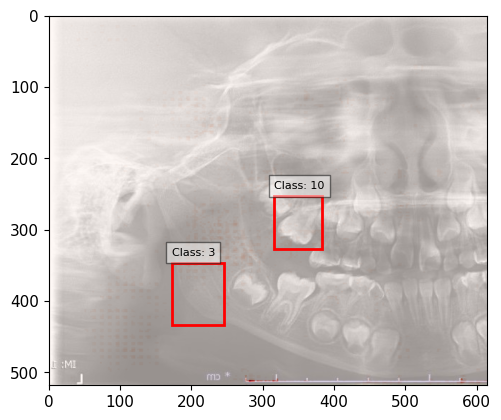

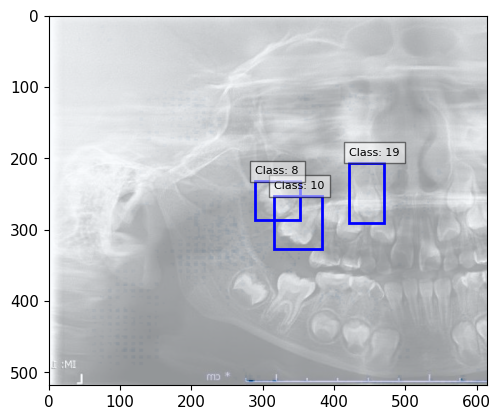

In [100]:
# Iterate over each file path in the Series
dataframe_neg = []
dataframe_pos = []
list_neg = []
list_pos = []

for index, file_path in file_paths.items():
    filename = file_path.split("/")[-1]
    print(f"Processing image {index}: {file_path}")

    try:
        # Load the image
        image = Image.open(file_path)

        # Perform your existing image processing steps
        results = yolo_model(image)  # Assuming yolo_model is defined
        df = results.pandas().xyxyn[0]  # Assuming results has a pandas method
        df_filtered_nms = nms_per_class(df, iou_threshold=0.5)  # Assuming nms_per_class is defined
        shap_values = explainer_layer1.shap_values(background_test_array[[0]])  # Assuming explainer_layer1 and background_test_array are defined

        # Processing for SHAP values
        data = [np.array(shap_values)]
        image_array = data[0]
        positive = np.where(image_array >= 0, image_array, 0)
        negative = np.where(image_array < 0, image_array, 0)
        negative_aps = np.abs(negative)

        flattened_array_pos = positive.flatten()
        flattened_array_neg = negative_aps.flatten()

        normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
        normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

        normalized_positive = normalized_array_pos.reshape(positive.shape)
        normalized_neg = normalized_array_neg.reshape(negative_aps.shape)

        grayscale_image_pos = normalized_positive / 3.0
        grayscale_image_neg = normalized_neg / 3.0

        grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
        grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

        grayscale_image_positive = grayscale_image_positive.squeeze()
        grayscale_image_negative = grayscale_image_negative.squeeze()

        percentile_95_pos = np.percentile(grayscale_image_positive, 95)
        percentile_95_neg = np.percentile(grayscale_image_negative, 95)

        grayscale_pos_thresholded = grayscale_image_positive
        grayscale_neg_thresholded = grayscale_image_negative

        grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0
        grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0
        # Example: Display or save processed results
        %matplotlib inline
        shap.image_plot(shap_values, background_test_array[[0]])

        # Assuming plot_bboxes_on_image_pos and plot_bboxes_on_image_neg are defined
        selected_bboxes_pos = plot_bboxes_on_image_pos(file_path, df_filtered_nms, grayscale_pos_thresholded)

        # # Save the figure
        # image_path = f"/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/OPG-SHAPer/Images/pos_image_{filename}.png"
        # plt.savefig(image_path, bbox_inches='tight')

        dataframe_pos.append(pd.DataFrame(selected_bboxes_pos)) # เก็บค่า ทำเป็น dataframe ก่อน
        list_pos.append(selected_bboxes_pos) # เก็บค่า list
        # print(type(selected_bboxes_pos))

        selected_bboxes_neg = plot_bboxes_on_image_neg(file_path, df_filtered_nms, grayscale_neg_thresholded)
        dataframe_neg.append(pd.DataFrame(selected_bboxes_neg))
        list_neg.append(selected_bboxes_neg)

    except Exception as e:
        print(f"Error processing image {index}: {file_path}")
        print(e)


In [101]:
selected_bboxes_pos

[{'xmin': 315.9257403612137,
  'ymin': 252.85705357789993,
  'xmax': 382.98643493652344,
  'ymax': 326.6576107740402,
  'confidence': 0.9158684611320496,
  'class': 10,
  'name': 'Upper First Molar'},
 {'xmin': 172.13094729185104,
  'ymin': 346.0725578069687,
  'xmax': 245.46801567077637,
  'ymax': 433.7881535291672,
  'confidence': 0.8946183323860168,
  'class': 3,
  'name': 'Mandibular angle'}]

In [102]:
type(selected_bboxes_neg)

list

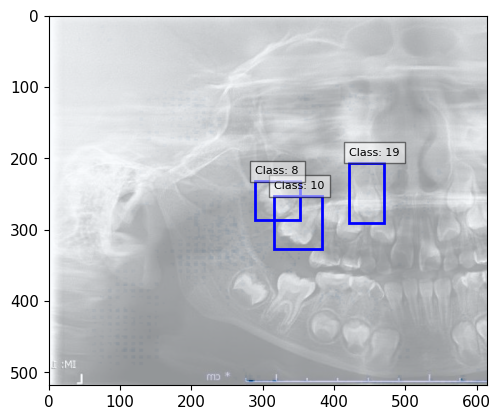

In [103]:
selected_bboxes_neg = plot_bboxes_on_image_neg(file_path, df_filtered_nms, grayscale_neg_thresholded)

In [105]:
list_pos

[[{'xmin': 290.4410427212715,
   'ymin': 318.5757477283478,
   'xmax': 347.5015199184418,
   'ymax': 375.6916677951813,
   'confidence': 0.9495601058006287,
   'class': 13,
   'name': 'Lower Second Molar'},
  {'xmin': 203.51100474596024,
   'ymin': 295.1675559282303,
   'xmax': 268.92041301727295,
   'ymax': 389.24350583553314,
   'confidence': 0.9019549489021301,
   'class': 3,
   'name': 'Mandibular angle'},
  {'xmin': 197.70931559801102,
   'ymin': 221.77830278873444,
   'xmax': 218.69383215904236,
   'ymax': 295.30776023864746,
   'confidence': 0.8087021112442017,
   'class': 16,
   'name': 'Posterior border of Ramus'}],
 [{'xmin': 272.6987864971161,
   'ymin': 326.28395903110504,
   'xmax': 334.6449053287506,
   'ymax': 384.78324270248413,
   'confidence': 0.948096513748169,
   'class': 13,
   'name': 'Lower Second Molar'},
  {'xmin': 306.3341130018234,
   'ymin': 217.3789255619049,
   'xmax': 362.1623058319092,
   'ymax': 267.18402910232544,
   'confidence': 0.9187877774238586,
 

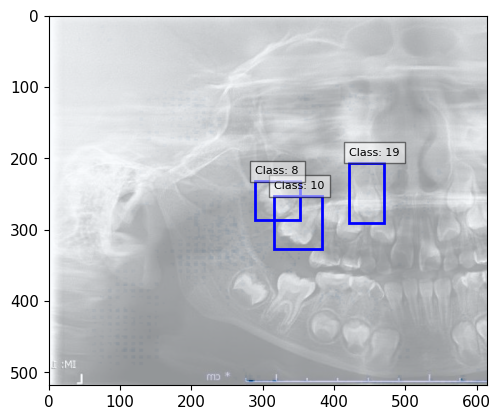

[{'xmin': 315.9257403612137,
  'ymin': 252.85705357789993,
  'xmax': 382.98643493652344,
  'ymax': 326.6576107740402,
  'confidence': 0.9158684611320496,
  'class': 10,
  'name': 'Upper First Molar'},
 {'xmin': 421.2552297115326,
  'ymin': 205.78831148147583,
  'xmax': 469.4094545841217,
  'ymax': 290.2622267007828,
  'confidence': 0.9033734202384949,
  'class': 19,
  'name': 'Upper Canine'},
 {'xmin': 289.77202665805817,
  'ymin': 231.97863721847534,
  'xmax': 352.06578278541565,
  'ymax': 287.05938720703125,
  'confidence': 0.9000732898712158,
  'class': 8,
  'name': 'Upper Second Molar'}]

In [106]:
plot_bboxes_on_image_neg(file_path, df_filtered_nms, grayscale_neg_thresholded)

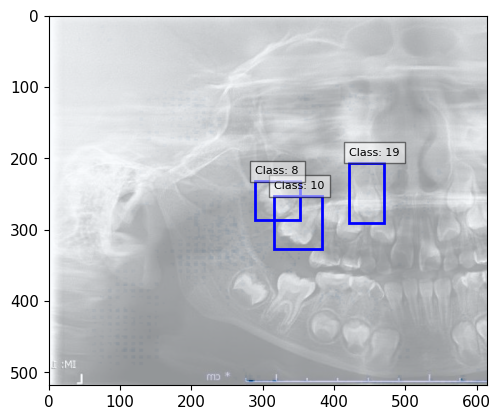

In [107]:
plot_bboxes_on_image_neg(file_path, df_filtered_nms, grayscale_neg_thresholded)
%matplotlib inline


In [108]:
name_count_pos = {}

# Iterate over each list of dictionaries
for sublist in list_pos:
    # Iterate over each dictionary in the sublist
    for item in sublist:
        # Get the name value from the dictionary
        name = item['name']
        # Update the count for the name in the dictionary
        if name in name_count_pos:
            name_count_pos[name] += 1
        else:
            name_count_pos[name] = 1

# Print the name counts
for name, count in name_count_pos.items():
    print(f"{name}: {count}/{len(list_pos)}")

Lower Second Molar: 3/5
Mandibular angle: 5/5
Posterior border of Ramus: 1/5
Upper Second Molar: 3/5
Upper First Molar: 3/5


In [109]:
name_count_neg = {}

# Iterate over each list of dictionaries
for sublist in list_neg:
    # Iterate over each dictionary in the sublist
    for item in sublist:
        # Get the name value from the dictionary
        name = item['name']
        # Update the count for the name in the dictionary
        if name in name_count_neg:
            name_count_neg[name] += 1
        else:
            name_count_neg[name] = 1

# Print the name counts
for name, count in name_count_neg.items():
    print(f"{name}: {count}/{len(list_neg)}")

Lower Second Molar: 4/5
Lower Second Premolar: 1/5
Mandibular angle: 4/5
Upper First Premolar: 2/5
Posterior border of Ramus: 1/5
Upper Second Molar: 4/5
Upper Canine: 3/5
Upper First Molar: 3/5
Lower First Molar: 1/5


In [110]:
dataframe_pos

[         xmin        ymin        xmax        ymax  confidence  class  \
 0  290.441043  318.575748  347.501520  375.691668    0.949560     13   
 1  203.511005  295.167556  268.920413  389.243506    0.901955      3   
 2  197.709316  221.778303  218.693832  295.307760    0.808702     16   
 
                         name  
 0         Lower Second Molar  
 1           Mandibular angle  
 2  Posterior border of Ramus  ,
          xmin        ymin        xmax        ymax  confidence  class  \
 0  272.698786  326.283959  334.644905  384.783243    0.948097     13   
 1  306.334113  217.378926  362.162306  267.184029    0.918788      8   
 2  173.991753  308.951112  242.764686  407.734420    0.896737      3   
 
                  name  
 0  Lower Second Molar  
 1  Upper Second Molar  
 2    Mandibular angle  ,
          xmin        ymin        xmax        ymax  confidence  class  \
 0  303.625678  233.997042  365.072227  317.314866    0.930909     10   
 1  286.679175  200.022027  341.2691

In [ ]:
type(dataframe_neg)

list

In [113]:
dataframe_neg

[         xmin        ymin        xmax        ymax  confidence  class  \
 0  290.441043  318.575748  347.501520  375.691668    0.949560     13   
 1  369.278275  377.189208  415.869944  432.946866    0.921958      6   
 2  203.511005  295.167556  268.920413  389.243506    0.901955      3   
 3  415.481574  217.678554  455.198303  291.415601    0.888440     14   
 4  197.709316  221.778303  218.693832  295.307760    0.808702     16   
 
                         name  
 0         Lower Second Molar  
 1      Lower Second Premolar  
 2           Mandibular angle  
 3       Upper First Premolar  
 4  Posterior border of Ramus  ,
          xmin        ymin        xmax        ymax  confidence  class  \
 0  272.698786  326.283959  334.644905  384.783243    0.948097     13   
 1  306.334113  217.378926  362.162306  267.184029    0.918788      8   
 2  173.991753  308.951112  242.764686  407.734420    0.896737      3   
 3  432.724406  193.263198  472.651422  287.645275    0.890207     19   
 


### 7 Year

#### เลือกรูปที่ต้องการหาค่า SHAP Value

In [193]:
sdf_test

,Age(year),Gender,Folder_type,Folder_name,Path_Name,...,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.423399,7,0.005142,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.415316,7,0.046188,Female,0.0
2,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.492433,7,0.000020,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.343049,7,0.020910,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.095627,7,0.003455,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...
286,22,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.010904,22,0.999999,Male,1.0
287,22,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,21.844440,22,0.999998,Male,1.0
288,23,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.836693,23,0.999958,Male,1.0
289,25,F,Normal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,24.869873,25,1.000000,Male,1.0


In [194]:
from PIL import Image
Image_V69_7Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/V69.jpg')
Image_V69_7Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/V69.jpg'

Image_FlipV69_7Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/FlipV69.jpg')
Image_FlipV69_7Y_F
Image_FlipV69_7Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/FlipV69.jpg'

Image_FlipV70_7Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/FlipV70.jpg')
Image_FlipV70_7Y_F
Image_FlipV70_7Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/F/Both/FlipV70.jpg'

Image_VV85_7Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/M/Both/VV85.jpg')
Image_VV85_7Y_M
Image_VV85_7Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/M/Both/VV85.jpg'

Image_FlipVV85_7Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/M/Both/FlipVV85.jpg')
Image_FlipVV85_7Y_M
Image_FlipVV85_7Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/7Y/M/Both/FlipVV85.jpg'

In [195]:
sdf_test.reset_index().iloc[0]

index                                                                 0
Age(year)                                                             7
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                        V69.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                    7.423399
Age_predict_int                                                       7
Gender_predict                                                 0.005142
Gender_predict_str                                               Female
Gender_predict_int                                              

In [196]:
sdf_test.reset_index().iloc[1]

index                                                                 1
Age(year)                                                             7
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                    FlipV69.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                    7.415316
Age_predict_int                                                       7
Gender_predict                                                 0.046188
Gender_predict_str                                               Female
Gender_predict_int                                              

In [197]:
sdf_test.reset_index().iloc[2] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                                 2
Age(year)                                                             7
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                    FlipV70.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                    7.492433
Age_predict_int                                                       7
Gender_predict                                                  0.00002
Gender_predict_str                                               Female
Gender_predict_int                                              

In [198]:
sdf_test.reset_index().iloc[18] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                                18
Age(year)                                                             7
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                       VV85.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                     7.47642
Age_predict_int                                                       7
Gender_predict                                                 0.987605
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [199]:
sdf_test.reset_index().iloc[19] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                                19
Age(year)                                                             7
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                   FlipVV85.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                    7.107091
Age_predict_int                                                       7
Gender_predict                                                 0.988593
Gender_predict_str                                                 Male
Gender_predict_int                                              

#### YOLO (detect ตห)

In [200]:
# YOLO detect ตำแหน่ง
#ภาพ1
results_V69_7Y_F = yolo_model(Image_V69_7Y_F) # results = ผลจากการทำนาย
df_V69_7Y_F = results_V69_7Y_F.pandas().xyxyn[0] #.pandas ทำให้เป็น dataframe // .xyxy ตห.กล่อง ///  n normalization ค่าให้มีค่าอยู่ระหว่าง 0-1 //[0]= index
#ภาพ2
results_FlipV69_7Y_F = yolo_model(Image_FlipV69_7Y_F)
df_FlipV69_7Y_F = results_FlipV69_7Y_F.pandas().xyxyn[0]
#ภาพ3
results_FlipV70_7Y_F = yolo_model(Image_FlipV70_7Y_F)
df_FlipV70_7Y_F = results_FlipV70_7Y_F.pandas().xyxyn[0]
#ภาพ4
results_VV85_7Y_M = yolo_model(Image_VV85_7Y_M)
df_VV85_7Y_M = results_VV85_7Y_M.pandas().xyxyn[0]
#ภาพ5
results_FlipVV85_7Y_M = yolo_model(Image_FlipVV85_7Y_M)
df_FlipVV85_7Y_M= results_FlipVV85_7Y_M.pandas().xyxyn[0]

In [222]:
results_V69_7Y_F

YOLOv5 <class 'models.common.Detections'> instance
image 1/1: 518x614 1 Condyle, 1 Upper Lateral Incisor, 1 Lower Lateral Incisor, 1 Mandibular angle, 2 Lower Central Incisors, 1 Lower First Molar, 1 Lower Second Premolar, 1 Nasal, 1 Upper Second Molar, 1 Lower Canine, 1 Upper First Molar, 1 Lower First Premolar, 1 Lower Second Molar, 1 Upper First Premolar, 1 Upper Third Molar, 1 Posterior border of Ramus, 1 Upper Central Incisor, 1 Upper Second Premolar, 1 Upper Canine
Speed: 45.9ms pre-process, 713.2ms inference, 1.9ms NMS per image at shape (1, 3, 544, 640)

In [202]:
results_FlipV69_7Y_F

YOLOv5 <class 'models.common.Detections'> instance
image 1/1: 518x614 1 Condyle, 1 Upper Lateral Incisor, 1 Lower Lateral Incisor, 1 Mandibular angle, 1 Lower Central Incisor, 1 Lower First Molar, 1 Lower Second Premolar, 1 Nasal, 1 Upper Second Molar, 1 Lower Canine, 1 Upper First Molar, 1 Lower First Premolar, 1 Lower Second Molar, 1 Upper First Premolar, 1 Posterior border of Ramus, 2 Upper Central Incisors, 3 Upper Second Premolars, 1 Upper Canine
Speed: 10.5ms pre-process, 767.5ms inference, 2.3ms NMS per image at shape (1, 3, 544, 640)

In [203]:
results_FlipVV85_7Y_M

YOLOv5 <class 'models.common.Detections'> instance
image 1/1: 518x614 1 Condyle, 1 Upper Lateral Incisor, 1 Lower Lateral Incisor, 1 Mandibular angle, 1 Lower Central Incisor, 1 Lower First Molar, 1 Lower Second Premolar, 1 Nasal, 1 Upper Second Molar, 1 Lower Canine, 1 Upper First Molar, 1 Lower First Premolar, 1 Lower Second Molar, 2 Upper First Premolars, 1 Upper Third Molar, 1 Posterior border of Ramus, 1 Upper Central Incisor, 2 Upper Second Premolars, 1 Upper Canine
Speed: 9.1ms pre-process, 470.5ms inference, 1.8ms NMS per image at shape (1, 3, 544, 640)

##### NMS

In [242]:
df_V69_7Y_F_filtered_nms = nms_per_class(df_V69_7Y_F,iou_threshold=0.5)
df_FlipV69_7Y_F_filtered_nms = nms_per_class(df_FlipV69_7Y_F,iou_threshold=0.5)
df_FlipV70_7Y_F_filtered_nms = nms_per_class(df_FlipV70_7Y_F,iou_threshold=0.5)
df_VV85_7Y_M_filtered_nms = nms_per_class(df_VV85_7Y_M,iou_threshold=0.5)
df_FlipVV85_7Y_M_filtered_nms = nms_per_class(df_FlipVV85_7Y_M,iou_threshold=0.5)

In [243]:
df_V69_7Y_F

,xmin,ymin,xmax,ymax,confidence,class,name
0,0.473031,0.615011,0.565963,0.725273,0.949560,13,Lower Second Molar
1,0.516368,0.611447,0.669636,0.789594,0.944441,5,Lower First Molar
2,0.763511,0.055511,0.929887,0.432768,0.935649,7,Nasal
3,0.513413,0.400233,0.602164,0.504332,0.928218,8,Upper Second Molar
4,0.631682,0.407176,0.706163,0.533568,0.923084,18,Upper Second Premolar
5,0.601430,0.728164,0.677313,0.835805,0.921958,6,Lower Second Premolar
6,0.667730,0.733540,0.750514,0.869000,0.918067,12,Lower First Premolar
7,0.558074,0.430709,0.648889,0.587324,0.916236,10,Upper First Molar
8,0.720266,0.367530,0.784213,0.536205,0.903446,19,Upper Canine
9,0.331451,0.569822,0.437981,0.751435,0.901955,3,Mandibular angle


In [244]:
df_V69_7Y_F_filtered_nms

,xmin,ymin,xmax,ymax,confidence,class,name,iou
0,0.473031,0.615011,0.565963,0.725273,0.949560,13,Lower Second Molar,1.000000
1,0.516368,0.611447,0.669636,0.789594,0.944441,5,Lower First Molar,1.000000
2,0.763511,0.055511,0.929887,0.432768,0.935649,7,Nasal,1.000000
3,0.513413,0.400233,0.602164,0.504332,0.928218,8,Upper Second Molar,1.000000
4,0.631682,0.407176,0.706163,0.533568,0.923084,18,Upper Second Premolar,1.000000
5,0.601430,0.728164,0.677313,0.835805,0.921958,6,Lower Second Premolar,1.000000
6,0.667730,0.733540,0.750514,0.869000,0.918067,12,Lower First Premolar,1.000000
7,0.558074,0.430709,0.648889,0.587324,0.916236,10,Upper First Molar,1.000000
8,0.720266,0.367530,0.784213,0.536205,0.903446,19,Upper Canine,1.000000
9,0.331451,0.569822,0.437981,0.751435,0.901955,3,Mandibular angle,1.000000


In [235]:
df_FlipV70_7Y_F_filtered_nms

,xmin,ymin,xmax,ymax,confidence,class,name,iou
0,0.728762,0.024134,0.941033,0.409951,0.936252,7,Nasal,1.00000
1,0.494504,0.451732,0.594580,0.612577,0.930909,10,Upper First Molar,1.00000
2,0.783396,0.447151,0.848808,0.657896,0.920286,17,Upper Central Incisor,1.00000
3,0.562982,0.731742,0.644445,0.817959,0.916598,6,Lower Second Premolar,1.00000
4,0.466904,0.386143,0.555813,0.489912,0.914341,8,Upper Second Molar,1.00000
5,0.733297,0.726139,0.803527,0.890729,0.910602,9,Lower Canine,1.00000
6,0.655655,0.731397,0.788501,0.859703,0.301881,9,Lower Canine,0.89251
7,0.645706,0.416595,0.730968,0.576749,0.910480,14,Upper First Premolar,1.00000
8,0.693107,0.367222,0.770868,0.516766,0.896498,19,Upper Canine,1.00000
9,0.652773,0.730883,0.740994,0.856294,0.893156,12,Lower First Premolar,1.00000


#### SHAP values

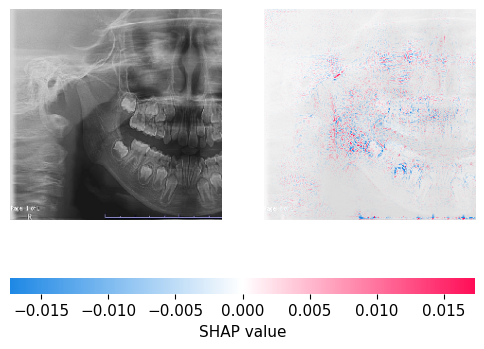

In [206]:
shap_values_V69_7Y_F = explainer_layer1.shap_values(background_test_array[[0]])
%matplotlib inline
shap.image_plot(shap_values_V69_7Y_F, background_test_array[[0]])

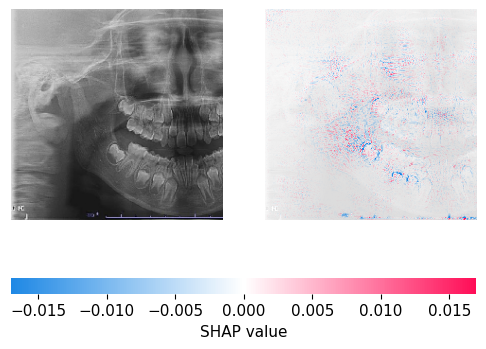

In [207]:
shap_values_FlipV69_7Y_F = explainer_layer1.shap_values(background_test_array[[1]])
%matplotlib inline
shap.image_plot(shap_values_FlipV69_7Y_F, background_test_array[[1]])

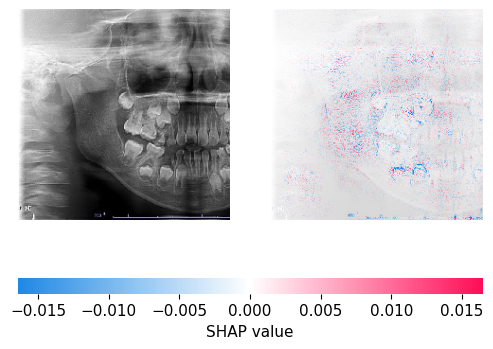

In [208]:
shap_values_FlipV70_7Y_F = explainer_layer1.shap_values(background_test_array[[2]])
%matplotlib inline
shap.image_plot(shap_values_FlipV70_7Y_F, background_test_array[[2]])

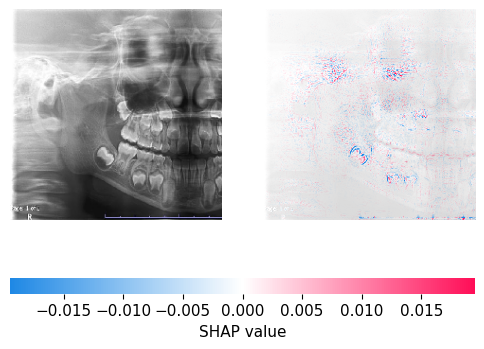

In [209]:
shap_values_VV85_7Y_M = explainer_layer1.shap_values(background_test_array[[18]])
%matplotlib inline
shap.image_plot(shap_values_VV85_7Y_M, background_test_array[[18]])

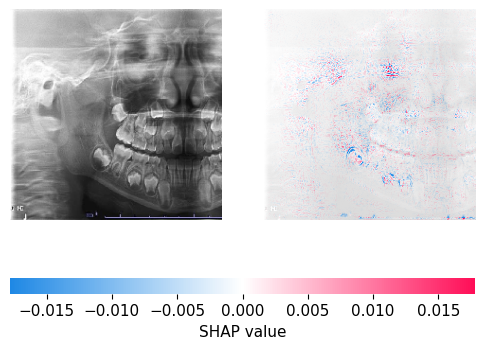

In [210]:
shap_values_FlipVV85_7Y_M = explainer_layer1.shap_values(background_test_array[[19]])
%matplotlib inline
shap.image_plot(shap_values_FlipVV85_7Y_M, background_test_array[[19]])

#### convert shap value from RGB to grayscale image

In [211]:
type(shap_values_VV85_7Y_M)

list

#### V69_7Y_F

In [212]:
#V69_7Y_F
data= [np.array(shap_values_V69_7Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [213]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

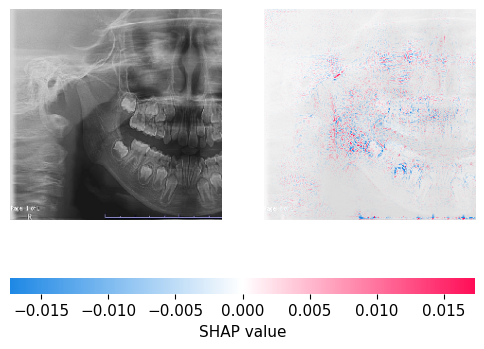

In [214]:
shap.image_plot(shap_values_V69_7Y_F, background_test_array[[0]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

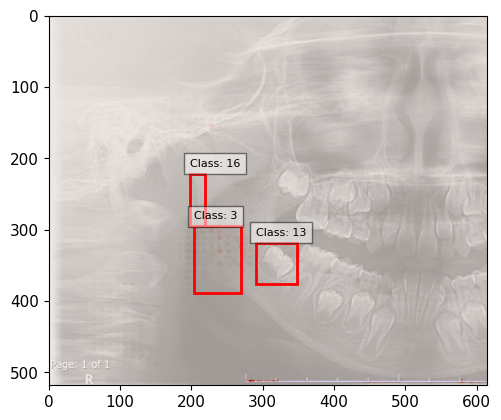

In [215]:
selected_bboxes_V69_7Y_F_pos = plot_bboxes_on_image_pos(Image_V69_7Y_F_path, df_V69_7Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [216]:
pd.DataFrame(selected_bboxes_V69_7Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name,iou
0,290.441043,318.575748,347.501520,375.691668,0.949560,13,Lower Second Molar,1.0
1,203.511005,295.167556,268.920413,389.243506,0.901955,3,Mandibular angle,1.0
2,197.709316,221.778303,218.693832,295.307760,0.808702,16,Posterior border of Ramus,1.0


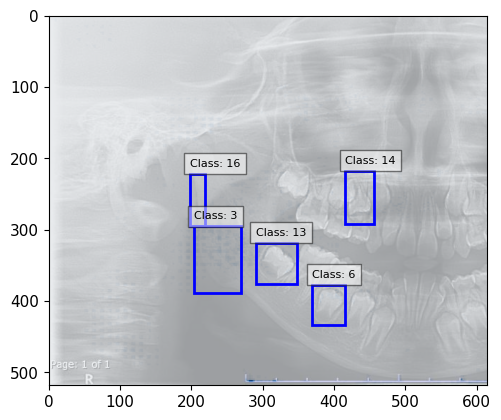

In [217]:
selected_bboxes_V69_7Y_F_neg = plot_bboxes_on_image_neg(Image_V69_7Y_F_path, df_V69_7Y_F_filtered_nms, grayscale_neg_thresholded)

In [218]:
pd.DataFrame(selected_bboxes_V69_7Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name,iou
0,290.441043,318.575748,347.501520,375.691668,0.949560,13,Lower Second Molar,1.0
1,369.278275,377.189208,415.869944,432.946866,0.921958,6,Lower Second Premolar,1.0
2,203.511005,295.167556,268.920413,389.243506,0.901955,3,Mandibular angle,1.0
3,415.481574,217.678554,455.198303,291.415601,0.888440,14,Upper First Premolar,1.0
4,197.709316,221.778303,218.693832,295.307760,0.808702,16,Posterior border of Ramus,1.0


#### FlipV69_7Y_F

In [159]:
#FlipV69_7Y_F
data= [np.array(shap_values_FlipV69_7Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [160]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

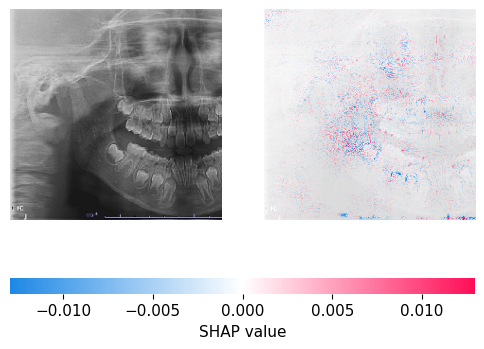

In [161]:
shap.image_plot(shap_values_FlipV69_7Y_F, background_test_array[[1]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

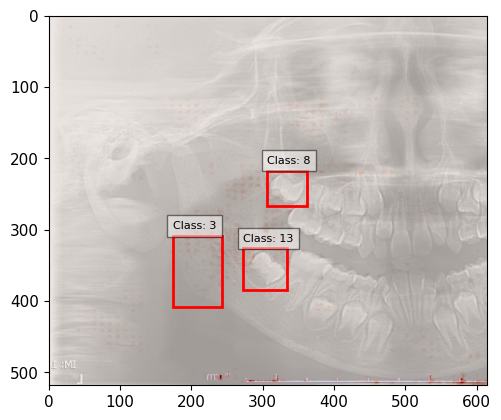

In [162]:
selected_bboxes_FlipV69_7Y_F_pos = plot_bboxes_on_image_pos(Image_FlipV69_7Y_F_path, df_FlipV69_7Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [163]:
pd.DataFrame(selected_bboxes_FlipV69_7Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name,iou
0,272.698786,326.283959,334.644905,384.783243,0.948097,13,Lower Second Molar,1.0
1,306.334113,217.378926,362.162306,267.184029,0.918788,8,Upper Second Molar,1.0
2,173.991753,308.951112,242.764686,407.734420,0.896737,3,Mandibular angle,1.0


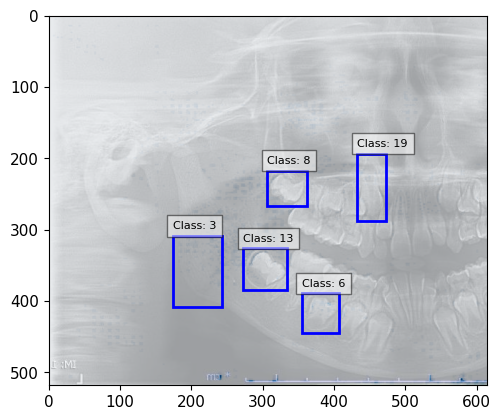

In [164]:
selected_bboxes_FlipV69_7Y_F_neg = plot_bboxes_on_image_neg(Image_FlipV69_7Y_F_path, df_FlipV69_7Y_F_filtered_nms, grayscale_neg_thresholded)

In [165]:
pd.DataFrame(selected_bboxes_FlipV69_7Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name,iou
0,272.698786,326.283959,334.644905,384.783243,0.948097,13,Lower Second Molar,1.0
1,354.402115,389.197378,406.943838,444.047954,0.934295,6,Lower Second Premolar,1.0
2,306.334113,217.378926,362.162306,267.184029,0.918788,8,Upper Second Molar,1.0
3,173.991753,308.951112,242.764686,407.734420,0.896737,3,Mandibular angle,1.0
4,432.724406,193.263198,472.651422,287.645275,0.890207,19,Upper Canine,1.0


#### FlipV70_7Y_F

In [166]:
#FlipV70_7Y_F
data= [np.array(shap_values_FlipV70_7Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [167]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

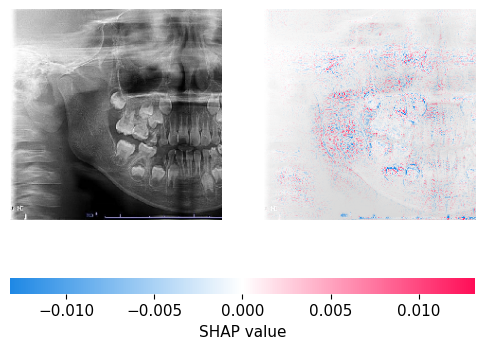

In [168]:
shap.image_plot(shap_values_FlipV70_7Y_F, background_test_array[[2]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

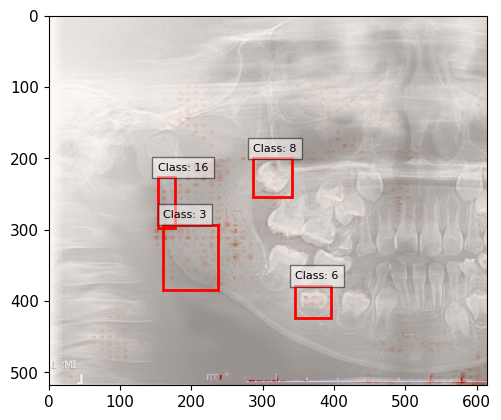

In [169]:
selected_bboxes_FlipV70_7Y_F_pos = plot_bboxes_on_image_pos(Image_FlipV70_7Y_F_path, df_FlipV70_7Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [170]:
pd.DataFrame(selected_bboxes_FlipV70_7Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name,iou
0,345.671255,379.042400,395.689048,423.702582,0.916598,6,Lower Second Premolar,1.0
1,286.679175,200.022027,341.269154,253.774572,0.914341,8,Upper Second Molar,1.0
2,160.386651,293.247458,236.824257,384.865927,0.890333,3,Mandibular angle,1.0
3,152.949522,226.535678,176.447227,297.256264,0.826957,16,Posterior border of Ramus,1.0


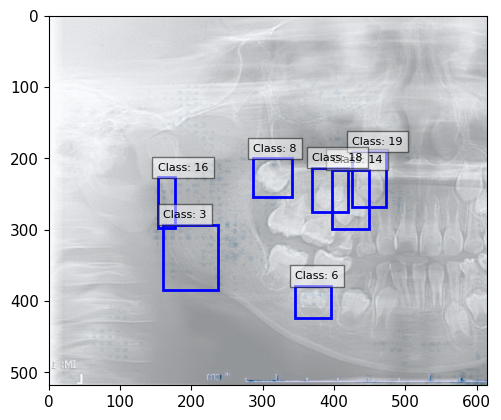

In [171]:
selected_bboxes_FlipV70_7Y_F_neg = plot_bboxes_on_image_neg(Image_FlipV70_7Y_F_path, df_FlipV70_7Y_F_filtered_nms, grayscale_neg_thresholded)

In [172]:
pd.DataFrame(selected_bboxes_FlipV70_7Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name,iou
0,345.671255,379.042400,395.689048,423.702582,0.916598,6,Lower Second Premolar,1.0
1,286.679175,200.022027,341.269154,253.774572,0.914341,8,Upper Second Molar,1.0
2,396.463373,215.796016,448.814131,298.756150,0.910480,14,Upper First Premolar,1.0
3,425.567777,190.220955,473.313027,267.684547,0.896498,19,Upper Canine,1.0
4,160.386651,293.247458,236.824257,384.865927,0.890333,3,Mandibular angle,1.0
5,369.301954,212.987499,419.544967,275.271882,0.888187,18,Upper Second Premolar,1.0
6,152.949522,226.535678,176.447227,297.256264,0.826957,16,Posterior border of Ramus,1.0


#### VV85_7Y_M

In [173]:
#VV85_7Y_M
data= [np.array(shap_values_VV85_7Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [174]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

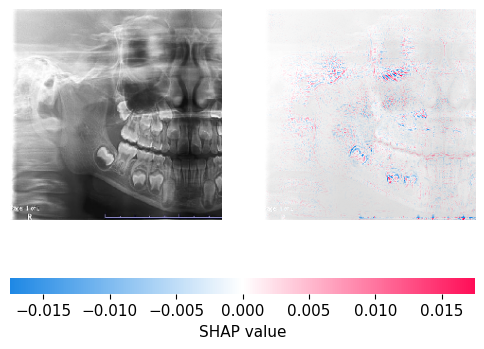

In [175]:
shap.image_plot(shap_values_VV85_7Y_M, background_test_array[[18]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

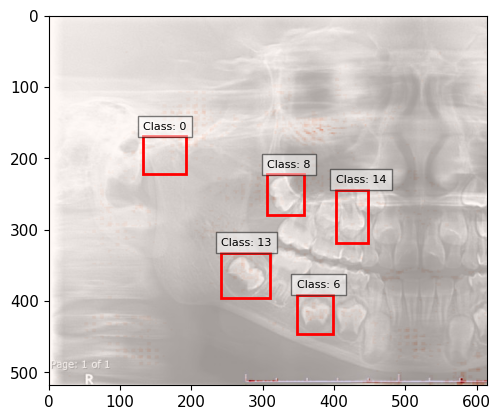

In [176]:
selected_bboxes_VV85_7Y_M_pos = plot_bboxes_on_image_pos(Image_VV85_7Y_M_path, df_VV85_7Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [177]:
pd.DataFrame(selected_bboxes_VV85_7Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name,iou
0,242.071352,332.193103,309.532200,395.292082,0.927893,13,Lower Second Molar,1.0
1,347.964585,391.438115,398.115666,446.633258,0.918505,6,Lower Second Premolar,1.0
2,306.333747,222.574219,358.414967,278.899441,0.903327,8,Upper Second Molar,1.0
3,401.972357,244.288597,447.118068,318.690943,0.883407,14,Upper First Premolar,1.0
4,132.365297,169.298557,193.013870,221.200427,0.862862,0,Condyle,1.0


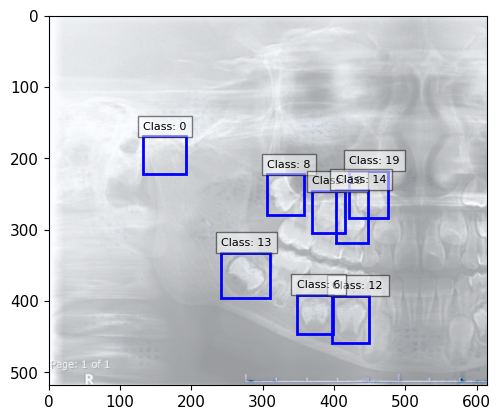

In [178]:
selected_bboxes_VV85_7Y_M_neg = plot_bboxes_on_image_neg(Image_VV85_7Y_M_path, df_VV85_7Y_M_filtered_nms, grayscale_neg_thresholded)

In [179]:
pd.DataFrame(selected_bboxes_VV85_7Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name,iou
0,397.653076,392.299287,449.521447,458.949563,0.930489,12,Lower First Premolar,1.0
1,420.957731,217.097421,475.436619,284.053254,0.928607,19,Upper Canine,1.0
2,242.071352,332.193103,309.532200,395.292082,0.927893,13,Lower Second Molar,1.0
3,347.964585,391.438115,398.115666,446.633258,0.918505,6,Lower Second Premolar,1.0
4,306.333747,222.574219,358.414967,278.899441,0.903327,8,Upper Second Molar,1.0
5,369.301295,246.014290,415.838397,304.596103,0.893503,18,Upper Second Premolar,1.0
6,401.972357,244.288597,447.118068,318.690943,0.883407,14,Upper First Premolar,1.0
7,132.365297,169.298557,193.013870,221.200427,0.862862,0,Condyle,1.0


#### FlipVV85_7Y_M

In [182]:
#FlipVV85_7Y_M
data= [np.array(shap_values_FlipVV85_7Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [183]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

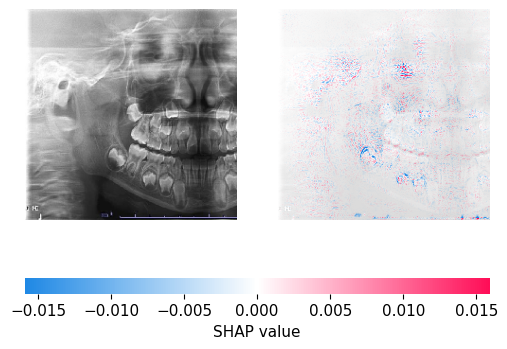

In [184]:
shap.image_plot(shap_values_FlipVV85_7Y_M, background_test_array[[19]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

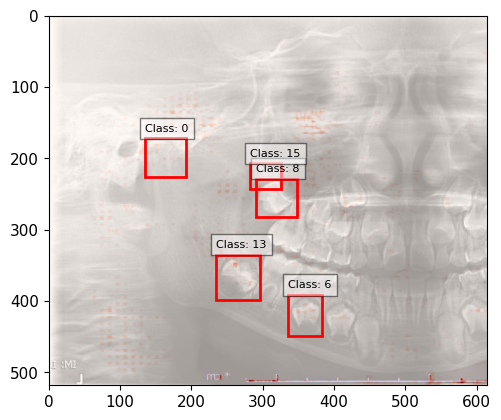

In [186]:
selected_bboxes_FlipVV85_7Y_M_pos = plot_bboxes_on_image_pos(Image_FlipVV85_7Y_M_path, df_FlipVV85_7Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [187]:
pd.DataFrame(selected_bboxes_FlipVV85_7Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name,iou
0,234.558027,335.396683,296.791197,398.208647,0.947646,13,Lower Second Molar,1.0
1,290.618338,228.791050,347.855855,282.153842,0.943234,8,Upper Second Molar,1.0
2,335.715302,391.619229,383.579896,449.522066,0.910473,6,Lower Second Premolar,1.0
3,135.384479,172.097194,192.811597,226.236281,0.867973,0,Condyle,1.0
4,282.638820,207.103611,325.708149,242.747662,0.604832,15,Upper Third Molar,1.0


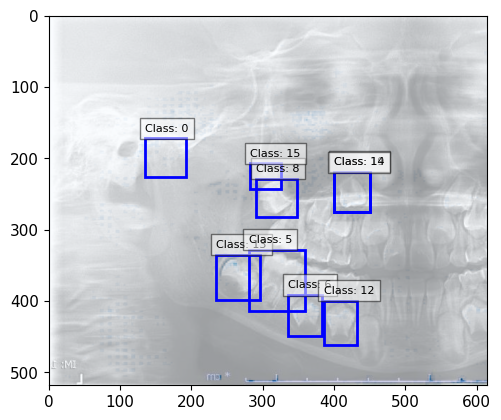

In [188]:
selected_bboxes_FlipVV85_7Y_M_neg = plot_bboxes_on_image_neg(Image_FlipVV85_7Y_M_path, df_FlipVV85_7Y_M_filtered_nms, grayscale_neg_thresholded)

In [189]:
pd.DataFrame(selected_bboxes_FlipVV85_7Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name,iou
0,234.558027,335.396683,296.791197,398.208647,0.947646,13,Lower Second Molar,1.000000
1,280.022208,327.792275,359.737372,414.164058,0.943842,5,Lower First Molar,1.000000
2,290.618338,228.791050,347.855855,282.153842,0.943234,8,Upper Second Molar,1.000000
3,335.715302,391.619229,383.579896,449.522066,0.910473,6,Lower Second Premolar,1.000000
4,399.958045,218.678741,450.471621,274.975881,0.879686,19,Upper Canine,1.000000
5,385.520612,399.636131,432.402057,462.194238,0.879563,12,Lower First Premolar,1.000000
6,399.270455,219.425195,450.094743,275.183548,0.489607,14,Upper First Premolar,0.835033
7,135.384479,172.097194,192.811597,226.236281,0.867973,0,Condyle,1.000000
8,282.638820,207.103611,325.708149,242.747662,0.604832,15,Upper Third Molar,1.000000


### 8 Year

#### เลือกรูปที่ต้องการหาค่า SHAP Value

In [ ]:
sdf_test

,Age(year),Gender,Folder_type,Folder_name,Path_Name,...,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.423399,7,0.005142,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.415316,7,0.046188,Female,0.0
2,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.492433,7,0.000020,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.343049,7,0.020910,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.095627,7,0.003455,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...
286,22,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.010904,22,0.999999,Male,1.0
287,22,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,21.844440,22,0.999998,Male,1.0
288,23,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.836693,23,0.999958,Male,1.0
289,25,F,Normal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,24.869873,25,1.000000,Male,1.0


In [ ]:
from PIL import Image
Image_P70_8Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/8Y/F/Both/P70.jpg')
Image_P70_8Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/8Y/F/Both/P70.jpg'

Image_P72_8Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/8Y/F/Both/P72.jpg')
Image_P72_8Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/8Y/F/Both/P72.jpg'

Image_FlipP72_8Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/8Y/F/Both/FlipP72.jpg')
Image_FlipP72_8Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/8Y/F/Both/FlipP72.jpg'

Image_PP75_8Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/8Y/M/Both/PP75.jpg')
Image_PP75_8Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/8Y/M/Both/PP75.jpg'

Image_FlipPP75_8Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/8Y/M/Both/FlipPP75.jpg')
Image_FlipPP75_8Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/8Y/M/Both/FlipPP75.jpg'

In [ ]:
sdf_test.reset_index().iloc[35]

index                                                                35
Age(year)                                                             8
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                        P70.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                    8.448954
Age_predict_int                                                       8
Gender_predict                                                 0.000004
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[36]

index                                                                36
Age(year)                                                             8
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                        P72.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                    7.828675
Age_predict_int                                                       8
Gender_predict                                                 0.285624
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[37] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                                37
Age(year)                                                             8
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                    FlipP72.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                    7.957682
Age_predict_int                                                       8
Gender_predict                                                 0.008646
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[55] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                                55
Age(year)                                                             8
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                       PP75.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                    7.602394
Age_predict_int                                                       8
Gender_predict                                                 0.999999
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[56] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                                56
Age(year)                                                             8
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                   FlipPP75.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                    7.606698
Age_predict_int                                                       8
Gender_predict                                                 0.999887
Gender_predict_str                                                 Male
Gender_predict_int                                              

#### YOLO (detect ตห)

In [ ]:
# YOLO detect ตำแหน่ง
#ภาพ1
results_P70_8Y_F = yolo_model(Image_P70_8Y_F) # results = ผลจากการทำนาย
df_P70_8Y_F = results_P70_8Y_F.pandas().xyxyn[0] #.pandas ทำให้เป็น dataframe // .xyxy ตห.กล่อง ///  n normalization ค่าให้มีค่าอยู่ระหว่าง 0-1 //[0]= index
#ภาพ2
results_P72_8Y_F = yolo_model(Image_P72_8Y_F)
df_P72_8Y_F = results_P72_8Y_F.pandas().xyxyn[0]
#ภาพ3
results_FlipP72_8Y_F = yolo_model(Image_FlipP72_8Y_F)
df_FlipP72_8Y_F = results_FlipP72_8Y_F.pandas().xyxyn[0]
#ภาพ4
results_PP75_8Y_M = yolo_model(Image_PP75_8Y_M)
df_PP75_8Y_M = results_PP75_8Y_M.pandas().xyxyn[0]
#ภาพ5
results_FlipPP75_8Y_M = yolo_model(Image_FlipPP75_8Y_M)
df_FlipPP75_8Y_M= results_FlipPP75_8Y_M.pandas().xyxyn[0]

##### NMS

In [ ]:
df_P70_8Y_F_filtered_nms = nms_per_class(df_P70_8Y_F,iou_threshold=0.5)
df_P72_8Y_F_filtered_nms = nms_per_class(df_P72_8Y_F,iou_threshold=0.5)
df_FlipP72_8Y_F_filtered_nms = nms_per_class(df_FlipP72_8Y_F,iou_threshold=0.5)
df_PP75_8Y_M_filtered_nms = nms_per_class(df_PP75_8Y_M,iou_threshold=0.5)
df_FlipPP75_8Y_M_filtered_nms = nms_per_class(df_FlipPP75_8Y_M,iou_threshold=0.5)

#### SHAP values

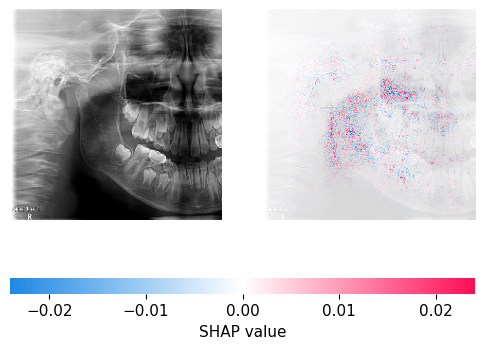

In [ ]:
shap_values_P70_8Y_F = explainer_layer1.shap_values(background_test_array[[35]])
%matplotlib inline
shap.image_plot(shap_values_P70_8Y_F, background_test_array[[35]])

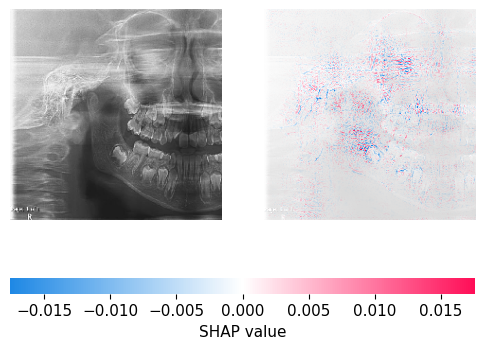

In [ ]:
shap_values_P72_8Y_F = explainer_layer1.shap_values(background_test_array[[36]])
%matplotlib inline
shap.image_plot(shap_values_P72_8Y_F, background_test_array[[36]])

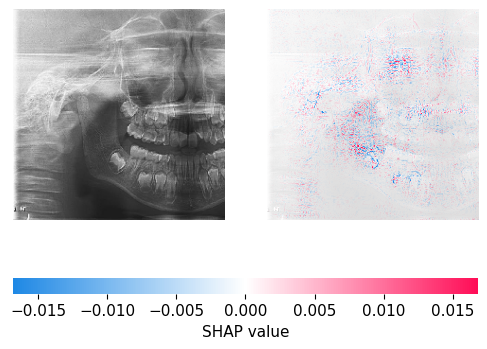

In [ ]:
shap_values_FlipP72_8Y_F = explainer_layer1.shap_values(background_test_array[[37]])
%matplotlib inline
shap.image_plot(shap_values_FlipP72_8Y_F, background_test_array[[37]])

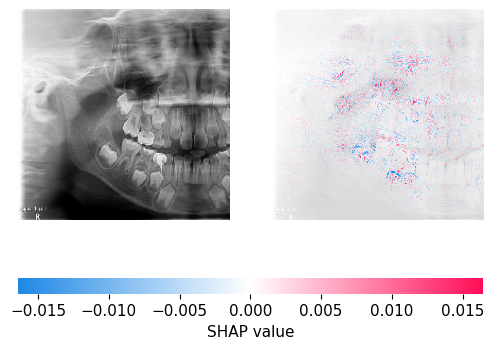

In [ ]:
shap_values_PP75_8Y_M = explainer_layer1.shap_values(background_test_array[[55]])
%matplotlib inline
shap.image_plot(shap_values_PP75_8Y_M, background_test_array[[55]])

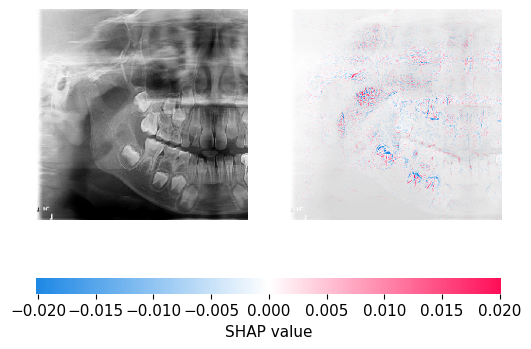

In [ ]:
shap_values_FlipPP75_8Y_M = explainer_layer1.shap_values(background_test_array[[56]])
%matplotlib inline
shap.image_plot(shap_values_FlipPP75_8Y_M, background_test_array[[56]])

#### convert shap value from RGB to grayscale image

In [ ]:
type(shap_values_FlipPP75_8Y_M)

list

#### P70_8Y_F

In [ ]:
#P70_8Y_F
data= [np.array(shap_values_P70_8Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

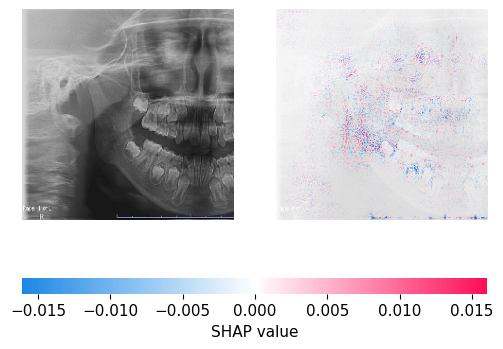

In [ ]:
shap.image_plot(shap_values_P70_8Y_F, background_test_array[[35]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

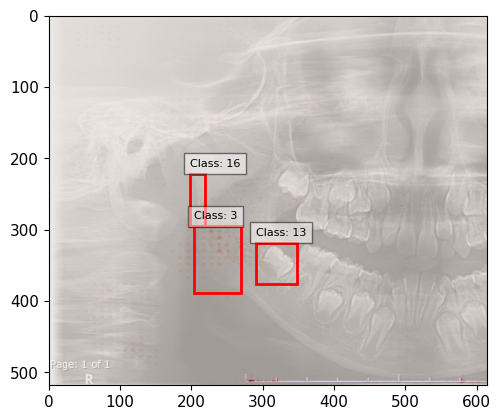

In [ ]:
selected_bboxes_P70_8Y_F_pos = plot_bboxes_on_image_pos(Image_P70_8Y_F_path, df_P70_8Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_P70_8Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,290.441006,318.575717,347.501520,375.691668,0.949560,13,Lower Second Molar
1,203.511023,295.167587,268.920413,389.243537,0.901955,3,Mandibular angle
2,197.709297,221.778334,218.693814,295.307760,0.808703,16,Posterior border of Ramus


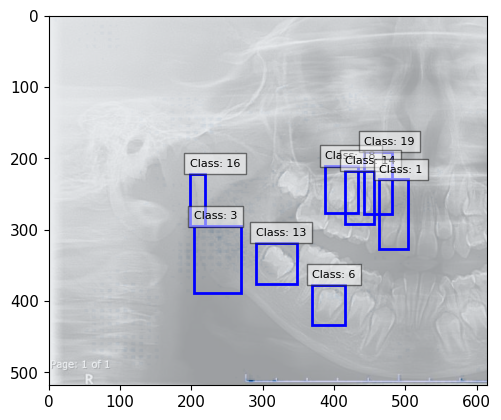

In [ ]:
selected_bboxes_P70_8Y_F_neg = plot_bboxes_on_image_neg(Image_P70_8Y_F_path, df_P70_8Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_P70_8Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,290.441006,318.575717,347.501520,375.691668,0.949560,13,Lower Second Molar
1,387.852442,210.917224,433.583892,276.388144,0.923084,18,Upper Second Premolar
2,369.278275,377.189239,415.869944,432.946804,0.921959,6,Lower Second Premolar
3,442.243241,190.380302,481.506713,277.754403,0.903446,19,Upper Canine
4,203.511023,295.167587,268.920413,389.243537,0.901955,3,Mandibular angle
5,415.481574,217.678585,455.198303,291.415632,0.888440,14,Upper First Premolar
6,463.243440,229.484183,503.849152,327.621257,0.876810,1,Upper Lateral Incisor
7,197.709297,221.778334,218.693814,295.307760,0.808703,16,Posterior border of Ramus


#### P72_8Y_F

In [ ]:
#P72_8Y_F
data= [np.array(shap_values_P72_8Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

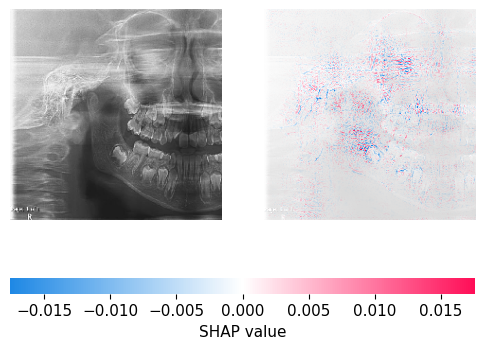

In [ ]:
shap.image_plot(shap_values_P72_8Y_F, background_test_array[[36]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

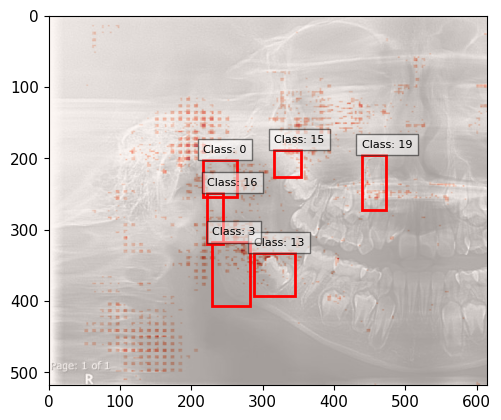

In [ ]:
selected_bboxes_P72_8Y_F_pos = plot_bboxes_on_image_pos(Image_P72_8Y_F_path, df_P72_8Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_P72_8Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,287.376059,332.029835,344.845072,392.208174,0.922872,13,Lower Second Molar
1,438.417218,194.792555,472.549499,272.839441,0.911954,19,Upper Canine
2,228.927394,317.327062,282.293397,406.479744,0.907569,3,Mandibular angle
3,316.418047,188.053639,353.024777,226.266045,0.834962,15,Upper Third Molar
4,222.358772,248.492179,243.752483,320.519959,0.798242,16,Posterior border of Ramus
5,216.567093,202.067834,264.289671,254.505975,0.796155,0,Condyle


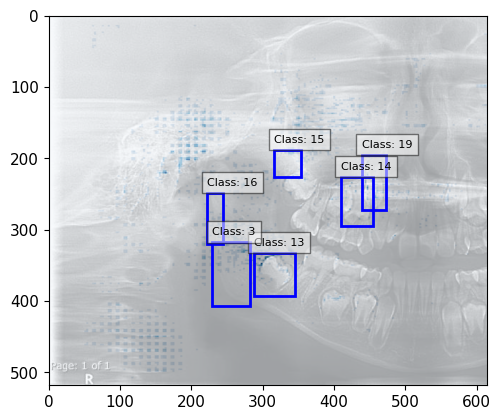

In [ ]:
selected_bboxes_P72_8Y_F_neg = plot_bboxes_on_image_neg(Image_P72_8Y_F_path, df_P72_8Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_P72_8Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,287.376059,332.029835,344.845072,392.208174,0.922872,13,Lower Second Molar
1,438.417218,194.792555,472.549499,272.839441,0.911954,19,Upper Canine
2,228.927394,317.327062,282.293397,406.479744,0.907569,3,Mandibular angle
3,409.133268,225.731719,453.809473,295.255025,0.892015,14,Upper First Premolar
4,316.418047,188.053639,353.024777,226.266045,0.834962,15,Upper Third Molar
5,222.358772,248.492179,243.752483,320.519959,0.798242,16,Posterior border of Ramus


#### FlipP72_8Y_F

In [ ]:
#FlipP72_8Y_F
data= [np.array(shap_values_FlipP72_8Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

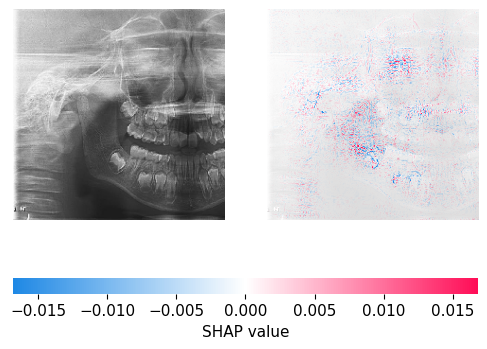

In [ ]:
shap.image_plot(shap_values_FlipP72_8Y_F, background_test_array[[37]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

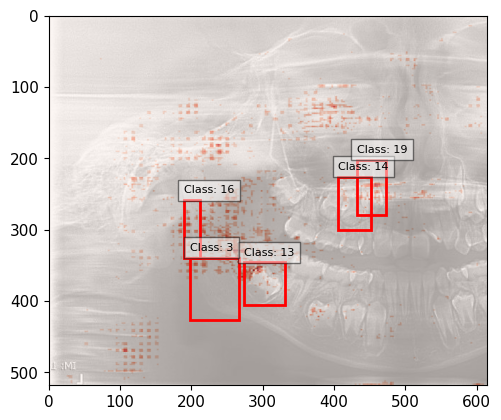

In [ ]:
selected_bboxes_FlipP72_8Y_F_pos = plot_bboxes_on_image_pos(Image_FlipP72_8Y_F_path, df_FlipP72_8Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_FlipP72_8Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,273.326393,345.885516,330.970578,405.281817,0.929849,13,Lower Second Molar
1,405.636511,226.132587,451.237858,299.732671,0.910776,14,Upper First Premolar
2,431.793555,201.644010,472.951483,279.913691,0.896964,19,Upper Canine
3,197.789043,339.015258,266.906686,427.060168,0.884693,3,Mandibular angle
4,189.108083,258.618537,211.902810,339.815265,0.805988,16,Posterior border of Ramus


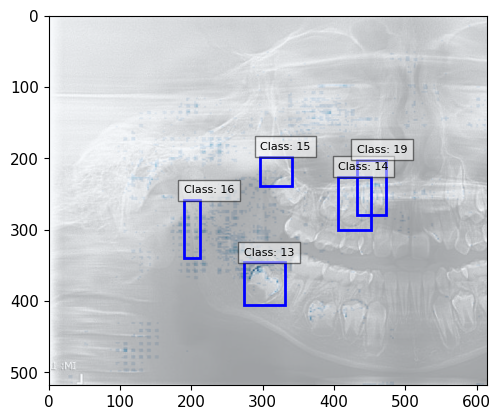

In [ ]:
selected_bboxes_FlipP72_8Y_F_neg = plot_bboxes_on_image_neg(Image_FlipP72_8Y_F_path, df_FlipP72_8Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_FlipP72_8Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,273.326393,345.885516,330.970578,405.281817,0.929849,13,Lower Second Molar
1,405.636511,226.132587,451.237858,299.732671,0.910776,14,Upper First Premolar
2,431.793555,201.644010,472.951483,279.913691,0.896964,19,Upper Canine
3,189.108083,258.618537,211.902810,339.815265,0.805988,16,Posterior border of Ramus
4,296.751196,197.858216,341.506817,238.370453,0.263403,15,Upper Third Molar


#### PP75_8Y_M

In [ ]:
#PP75_8Y_M
data= [np.array(shap_values_PP75_8Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

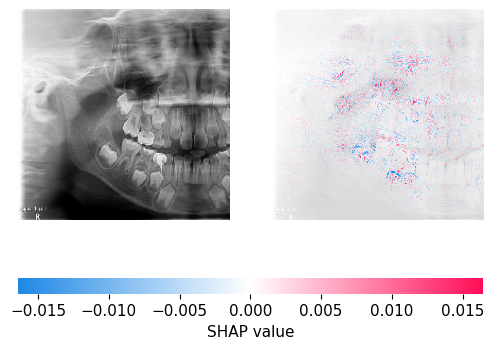

In [ ]:
shap.image_plot(shap_values_PP75_8Y_M, background_test_array[[55]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

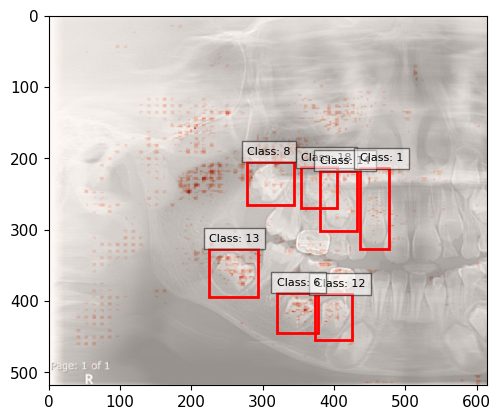

In [ ]:
selected_bboxes_PP75_8Y_M_pos = plot_bboxes_on_image_pos(Image_PP75_8Y_M_path, df_PP75_8Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_PP75_8Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,225.183641,326.979794,293.234401,394.389754,0.947002,13,Lower Second Molar
1,372.899427,390.245684,425.357818,454.841185,0.939154,12,Lower First Premolar
2,319.614597,388.595003,377.391044,445.099810,0.932475,6,Lower Second Premolar
3,278.299374,205.148253,343.986354,265.489814,0.919843,8,Upper Second Molar
4,353.876395,212.680630,404.516708,269.883387,0.911675,18,Upper Second Premolar
5,380.261843,217.773711,431.480465,302.455031,0.904119,14,Upper First Premolar
6,435.889080,213.776437,476.565242,327.152108,0.891169,1,Upper Lateral Incisor


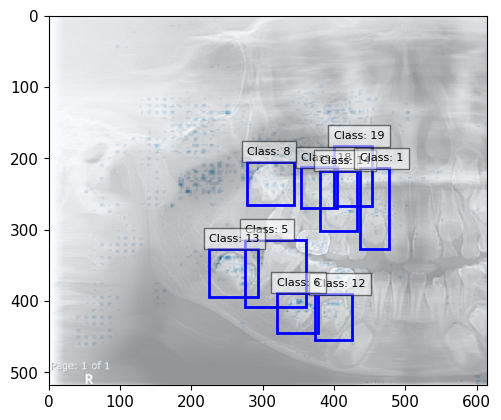

In [ ]:
selected_bboxes_PP75_8Y_M_neg = plot_bboxes_on_image_neg(Image_PP75_8Y_M_path, df_PP75_8Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_PP75_8Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,275.582851,314.480430,361.052750,408.420559,0.949752,5,Lower First Molar
1,225.183641,326.979794,293.234401,394.389754,0.947002,13,Lower Second Molar
2,372.899427,390.245684,425.357818,454.841185,0.939154,12,Lower First Premolar
3,319.614597,388.595003,377.391044,445.099810,0.932475,6,Lower Second Premolar
4,278.299374,205.148253,343.986354,265.489814,0.919843,8,Upper Second Molar
5,353.876395,212.680630,404.516708,269.883387,0.911675,18,Upper Second Premolar
6,399.682394,182.850843,452.553712,266.718030,0.910107,19,Upper Canine
7,380.261843,217.773711,431.480465,302.455031,0.904119,14,Upper First Premolar
8,435.889080,213.776437,476.565242,327.152108,0.891169,1,Upper Lateral Incisor


#### FlipPP75_8Y_M

In [ ]:
#FlipPP75_8Y_M
data= [np.array(shap_values_FlipPP75_8Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

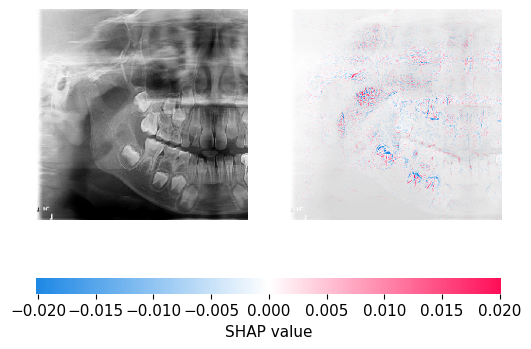

In [ ]:
shap.image_plot(shap_values_FlipPP75_8Y_M, background_test_array[[56]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

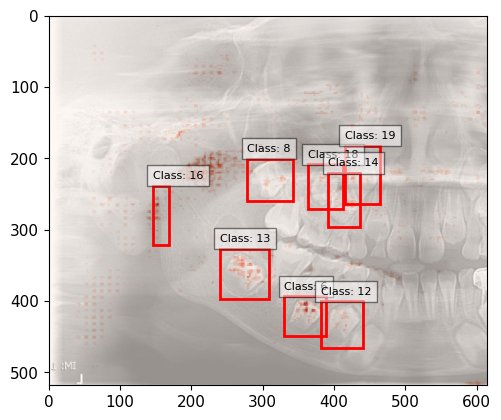

In [ ]:
selected_bboxes_FlipPP75_8Y_M_pos = plot_bboxes_on_image_pos(Image_FlipPP75_8Y_M_path, df_FlipPP75_8Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_FlipPP75_8Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,239.502023,326.753540,308.290675,397.187882,0.961944,13,Lower Second Molar
1,278.496670,200.707071,342.231589,260.019870,0.939108,8,Upper Second Molar
2,363.047264,208.507105,412.739562,271.584271,0.923798,18,Upper Second Premolar
3,414.982424,182.696081,464.161848,263.970352,0.914458,19,Upper Canine
4,329.842541,393.364234,388.350128,448.770841,0.907402,6,Lower Second Premolar
5,381.173261,400.583784,441.076814,466.116902,0.878680,12,Lower First Premolar
6,391.504226,220.727264,436.577950,295.570076,0.872852,14,Upper First Premolar
7,145.862492,238.803663,169.123257,321.667992,0.787251,16,Posterior border of Ramus


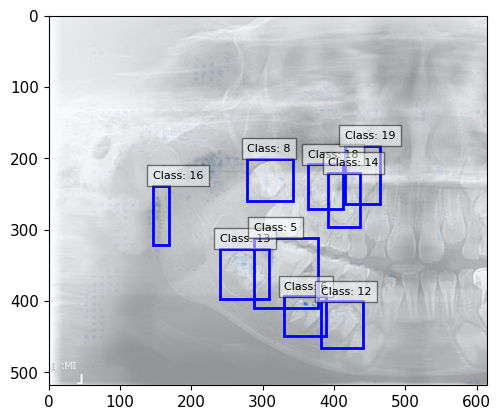

In [ ]:
selected_bboxes_FlipPP75_8Y_M_neg = plot_bboxes_on_image_neg(Image_FlipPP75_8Y_M_path, df_FlipPP75_8Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_FlipPP75_8Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,239.502023,326.753540,308.290675,397.187882,0.961944,13,Lower Second Molar
1,287.167053,311.500046,377.788783,409.434470,0.945569,5,Lower First Molar
2,278.496670,200.707071,342.231589,260.019870,0.939108,8,Upper Second Molar
3,363.047264,208.507105,412.739562,271.584271,0.923798,18,Upper Second Premolar
4,414.982424,182.696081,464.161848,263.970352,0.914458,19,Upper Canine
5,329.842541,393.364234,388.350128,448.770841,0.907402,6,Lower Second Premolar
6,381.173261,400.583784,441.076814,466.116902,0.878680,12,Lower First Premolar
7,391.504226,220.727264,436.577950,295.570076,0.872852,14,Upper First Premolar
8,145.862492,238.803663,169.123257,321.667992,0.787251,16,Posterior border of Ramus


### 9 Year

#### เลือกรูปที่ต้องการหาค่า SHAP Value

In [ ]:
sdf_test

,Age(year),Gender,Folder_type,Folder_name,Path_Name,...,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.423399,7,0.005142,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.415316,7,0.046188,Female,0.0
2,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.492433,7,0.000020,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.343049,7,0.020910,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.095627,7,0.003455,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...
286,22,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.010904,22,0.999999,Male,1.0
287,22,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,21.844440,22,0.999998,Male,1.0
288,23,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.836693,23,0.999958,Male,1.0
289,25,F,Normal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,24.869873,25,1.000000,Male,1.0


In [ ]:
from PIL import Image
Image_W84_9Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/9Y/F/Both/W84.jpg')
Image_W84_9Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/9Y/F/Both/W84.jpg'

Image_W91_9Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/9Y/F/Both/W91.jpg')
Image_W91_9Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/9Y/F/Both/W91.jpg'

Image_FlipW91_9Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/9Y/F/Both/FlipW91.jpg')
Image_FlipW91_9Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/9Y/F/Both/FlipW91.jpg'

Image_WW75_9Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/9Y/M/Both/WW75.jpg')
Image_WW75_9Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/9Y/M/Both/WW75.jpg'

Image_FlipWW75_9Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/9Y/M/Both/FlipWW75.jpg')
Image_FlipWW75_9Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/9Y/M/Both/FlipWW75.jpg'

In [ ]:
sdf_test.reset_index().iloc[69]

index                                                                69
Age(year)                                                             9
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                        W84.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                    8.614925
Age_predict_int                                                       9
Gender_predict                                                 0.879889
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[71]

index                                                                71
Age(year)                                                             9
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                        W91.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                    9.110678
Age_predict_int                                                       9
Gender_predict                                                 0.999966
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[72] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                                72
Age(year)                                                             9
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                    FlipW91.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                    9.030347
Age_predict_int                                                       9
Gender_predict                                                 0.999971
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[83] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                                83
Age(year)                                                             9
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                       WW75.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                    8.584053
Age_predict_int                                                       9
Gender_predict                                                 0.999999
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[84] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                                84
Age(year)                                                             9
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                   FlipWW75.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                    8.569002
Age_predict_int                                                       9
Gender_predict                                                 0.999999
Gender_predict_str                                                 Male
Gender_predict_int                                              

#### YOLO (detect ตห)

In [ ]:
# YOLO detect ตำแหน่ง
#ภาพ1
results_W84_9Y_F = yolo_model(Image_W84_9Y_F) # results = ผลจากการทำนาย
df_W84_9Y_F = results_W84_9Y_F.pandas().xyxyn[0] #.pandas ทำให้เป็น dataframe // .xyxy ตห.กล่อง ///  n normalization ค่าให้มีค่าอยู่ระหว่าง 0-1 //[0]= index
#ภาพ2
results_W91_9Y_F = yolo_model(Image_W91_9Y_F)
df_W91_9Y_F = results_W91_9Y_F.pandas().xyxyn[0]
#ภาพ3
results_FlipW91_9Y_F = yolo_model(Image_FlipW91_9Y_F)
df_FlipW91_9Y_F = results_FlipW91_9Y_F.pandas().xyxyn[0]
#ภาพ4
results_WW75_9Y_M = yolo_model(Image_WW75_9Y_M)
df_WW75_9Y_M = results_WW75_9Y_M.pandas().xyxyn[0]
#ภาพ5
results_FlipWW75_9Y_M = yolo_model(Image_FlipWW75_9Y_M)
df_FlipWW75_9Y_M= results_FlipWW75_9Y_M.pandas().xyxyn[0]

##### NMS

In [ ]:
df_W84_9Y_F_filtered_nms = nms_per_class(df_W84_9Y_F,iou_threshold=0.5)
df_W91_9Y_F_filtered_nms = nms_per_class(df_W91_9Y_F,iou_threshold=0.5)
df_FlipW91_9Y_F_filtered_nms = nms_per_class(df_FlipW91_9Y_F,iou_threshold=0.5)
df_WW75_9Y_M_filtered_nms = nms_per_class(df_WW75_9Y_M,iou_threshold=0.5)
df_FlipWW75_9Y_M_filtered_nms = nms_per_class(df_FlipWW75_9Y_M,iou_threshold=0.5)

#### SHAP values

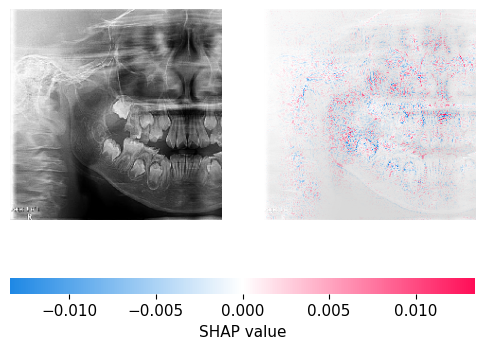

In [ ]:
shap_values_W84_9Y_F = explainer_layer1.shap_values(background_test_array[[69]])
%matplotlib inline
shap.image_plot(shap_values_W84_9Y_F, background_test_array[[69]])

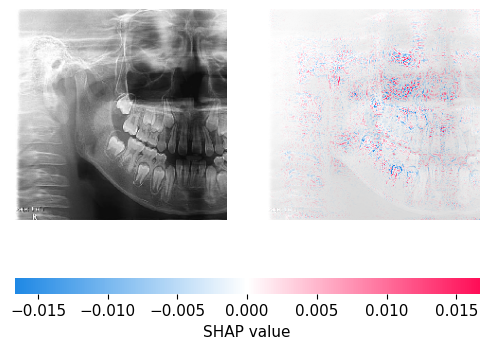

In [ ]:
shap_values_W91_9Y_F = explainer_layer1.shap_values(background_test_array[[71]])
%matplotlib inline
shap.image_plot(shap_values_W91_9Y_F, background_test_array[[71]])

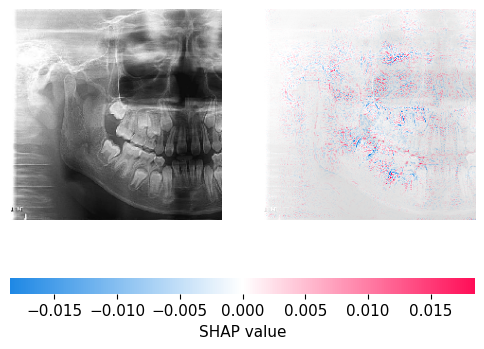

In [ ]:
shap_values_FlipW91_9Y_F = explainer_layer1.shap_values(background_test_array[[72]])
%matplotlib inline
shap.image_plot(shap_values_FlipW91_9Y_F, background_test_array[[72]])

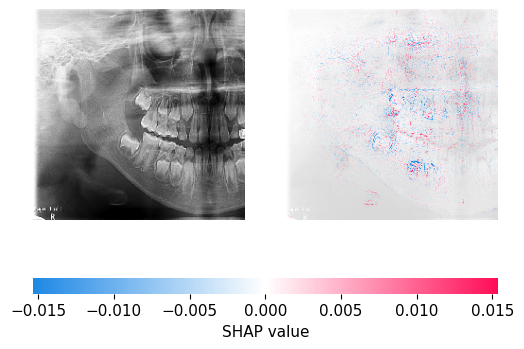

In [ ]:
shap_values_WW75_9Y_M = explainer_layer1.shap_values(background_test_array[[83]])
%matplotlib inline
shap.image_plot(shap_values_WW75_9Y_M, background_test_array[[83]])

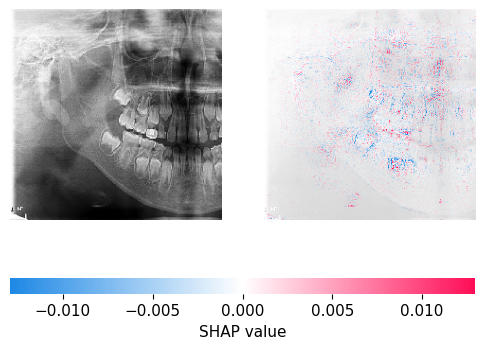

In [ ]:
shap_values_FlipWW75_9Y_M = explainer_layer1.shap_values(background_test_array[[84]])
%matplotlib inline
shap.image_plot(shap_values_FlipWW75_9Y_M, background_test_array[[84]])

#### convert shap value from RGB to grayscale image

In [ ]:
type(shap_values_FlipWW75_9Y_M)

list

#### W84_9Y_F

In [ ]:
#W84_9Y_F
data= [np.array(shap_values_W84_9Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

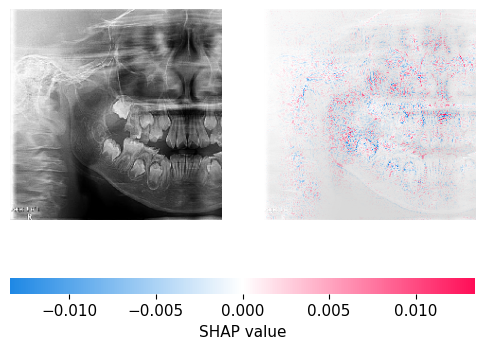

In [ ]:
shap.image_plot(shap_values_W84_9Y_F, background_test_array[[69]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

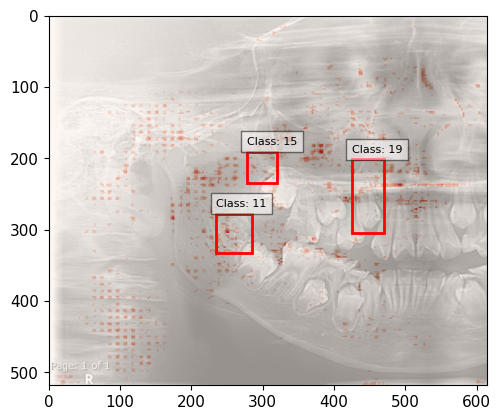

In [ ]:
selected_bboxes_W84_9Y_F_pos = plot_bboxes_on_image_pos(Image_W84_9Y_F_path, df_W84_9Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_W84_9Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,425.112836,201.387962,469.904908,304.437682,0.917683,19,Upper Canine
1,234.615174,277.815474,285.325204,332.315832,0.869084,11,Lower Third Molar
2,277.690981,190.704924,320.194261,234.075882,0.699372,15,Upper Third Molar


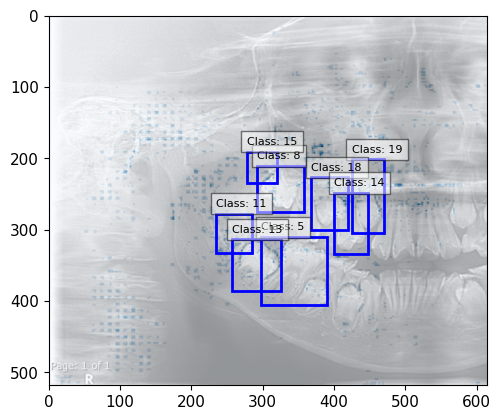

In [ ]:
selected_bboxes_W84_9Y_F_neg = plot_bboxes_on_image_neg(Image_W84_9Y_F_path, df_W84_9Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_W84_9Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,297.844063,310.617416,389.812188,405.284318,0.951626,5,Lower First Molar
1,257.433707,313.472261,324.973386,386.081792,0.920765,13,Lower Second Molar
2,292.123345,210.907343,357.728951,275.321190,0.917743,8,Upper Second Molar
3,425.112836,201.387962,469.904908,304.437682,0.917683,19,Upper Canine
4,368.233278,226.646628,419.960785,299.903442,0.908246,18,Upper Second Premolar
5,400.013233,248.734272,447.243670,334.624649,0.891690,14,Upper First Premolar
6,234.615174,277.815474,285.325204,332.315832,0.869084,11,Lower Third Molar
7,277.690981,190.704924,320.194261,234.075882,0.699372,15,Upper Third Molar


#### W91_9Y_F

In [ ]:
#W91_9Y_F
data= [np.array(shap_values_W91_9Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

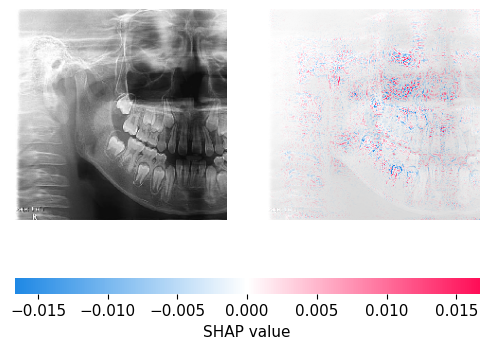

In [ ]:
shap.image_plot(shap_values_W91_9Y_F, background_test_array[[71]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

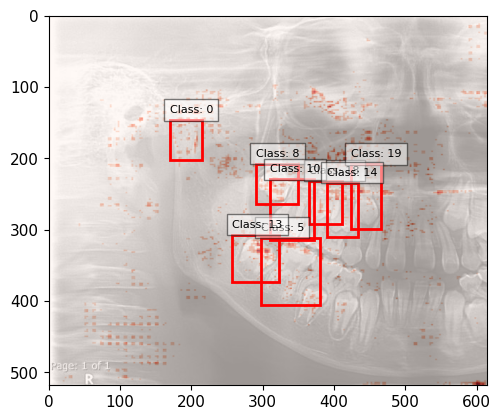

In [ ]:
selected_bboxes_W91_9Y_F_pos = plot_bboxes_on_image_pos(Image_W91_9Y_F_path, df_W91_9Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_W91_9Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,296.851710,311.183112,380.588107,405.693754,0.948658,5,Lower First Molar
1,290.485142,207.311926,349.985522,264.491588,0.943336,8,Upper Second Molar
2,257.196685,307.070411,323.377929,373.275189,0.940455,13,Lower Second Molar
3,365.115558,231.401580,411.166721,292.244538,0.919088,18,Upper Second Premolar
4,423.611361,207.993434,465.957309,299.005437,0.914038,19,Upper Canine
5,309.729350,229.298129,371.458667,313.883951,0.903949,10,Upper First Molar
6,389.944561,234.263773,434.128459,310.582250,0.891004,14,Upper First Premolar
7,169.307268,146.392443,215.182875,201.902991,0.871561,0,Condyle


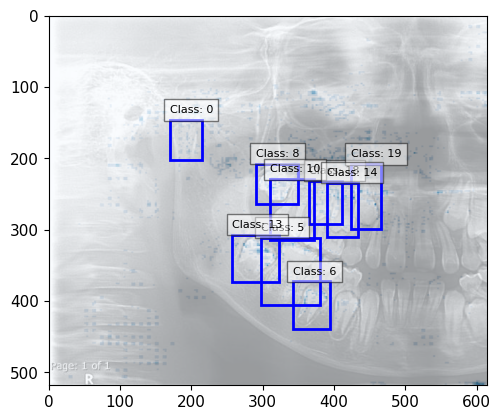

In [ ]:
selected_bboxes_W91_9Y_F_neg = plot_bboxes_on_image_neg(Image_W91_9Y_F_path, df_W91_9Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_W91_9Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,296.851710,311.183112,380.588107,405.693754,0.948658,5,Lower First Molar
1,290.485142,207.311926,349.985522,264.491588,0.943336,8,Upper Second Molar
2,257.196685,307.070411,323.377929,373.275189,0.940455,13,Lower Second Molar
3,365.115558,231.401580,411.166721,292.244538,0.919088,18,Upper Second Premolar
4,342.136802,372.552061,394.523975,439.039779,0.918365,6,Lower Second Premolar
5,423.611361,207.993434,465.957309,299.005437,0.914038,19,Upper Canine
6,309.729350,229.298129,371.458667,313.883951,0.903949,10,Upper First Molar
7,389.944561,234.263773,434.128459,310.582250,0.891004,14,Upper First Premolar
8,169.307268,146.392443,215.182875,201.902991,0.871561,0,Condyle


#### FlipW91_9Y_F

In [ ]:
#FlipW91_9Y_F
data= [np.array(shap_values_FlipW91_9Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

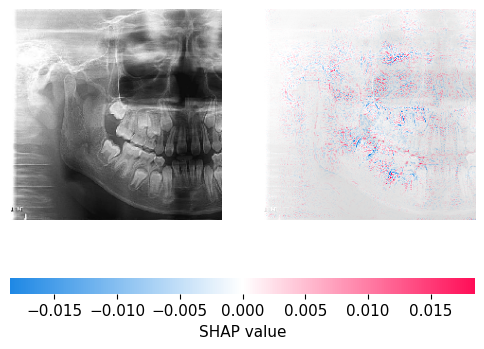

In [ ]:
shap.image_plot(shap_values_FlipW91_9Y_F, background_test_array[[72]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

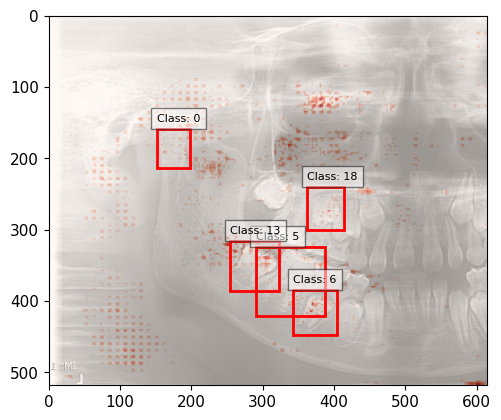

In [ ]:
selected_bboxes_FlipW91_9Y_F_pos = plot_bboxes_on_image_pos(Image_FlipW91_9Y_F_path, df_FlipW91_9Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_FlipW91_9Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,290.105098,324.012964,387.332468,421.136297,0.953262,5,Lower First Molar
1,254.303873,315.121708,323.115380,385.423718,0.937795,13,Lower Second Molar
2,342.918702,384.546337,404.314069,447.725252,0.914924,6,Lower Second Premolar
3,362.345475,240.124427,413.142753,300.089527,0.900912,18,Upper Second Premolar
4,151.218966,158.496203,198.040173,213.530208,0.865926,0,Condyle


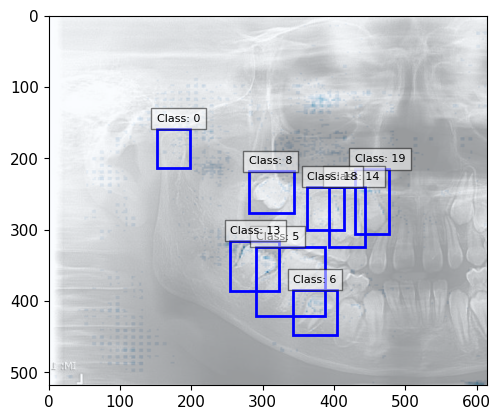

In [ ]:
selected_bboxes_FlipW91_9Y_F_neg = plot_bboxes_on_image_neg(Image_FlipW91_9Y_F_path, df_FlipW91_9Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_FlipW91_9Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,290.105098,324.012964,387.332468,421.136297,0.953262,5,Lower First Molar
1,254.303873,315.121708,323.115380,385.423718,0.937795,13,Lower Second Molar
2,280.623354,218.072938,344.082934,275.858881,0.934090,8,Upper Second Molar
3,428.652449,215.130223,477.324855,305.972118,0.916163,19,Upper Canine
4,342.918702,384.546337,404.314069,447.725252,0.914924,6,Lower Second Premolar
5,392.258934,239.478873,443.256473,324.280405,0.905662,14,Upper First Premolar
6,362.345475,240.124427,413.142753,300.089527,0.900912,18,Upper Second Premolar
7,151.218966,158.496203,198.040173,213.530208,0.865926,0,Condyle


#### WW75_9Y_M

In [ ]:
#WW75_9Y_M
data= [np.array(shap_values_WW75_9Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

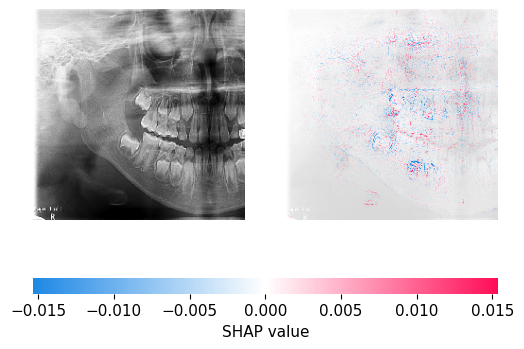

In [ ]:
shap.image_plot(shap_values_WW75_9Y_M, background_test_array[[83]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

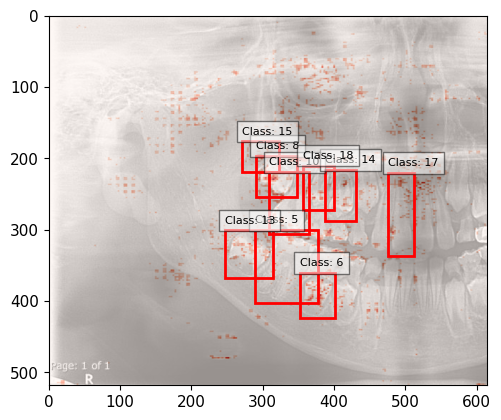

In [ ]:
selected_bboxes_WW75_9Y_M_pos = plot_bboxes_on_image_pos(Image_WW75_9Y_M_path, df_WW75_9Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_WW75_9Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,288.797021,300.666615,377.375088,402.125599,0.947565,5,Lower First Molar
1,289.963815,196.884303,347.958546,254.770946,0.938429,8,Upper Second Molar
2,246.404521,300.860450,313.937668,368.045330,0.933576,13,Lower Second Molar
3,476.086989,220.671427,512.134770,336.503621,0.923758,17,Upper Central Incisor
4,309.017533,219.415423,365.137845,305.861585,0.922747,10,Upper First Molar
5,387.651560,216.501190,430.328969,287.930531,0.903605,14,Upper First Premolar
6,351.834488,360.836433,400.815555,424.185285,0.900487,6,Lower Second Premolar
7,355.878777,210.464084,399.892572,271.966784,0.888687,18,Upper Second Premolar
8,271.135736,176.292424,323.007345,219.042729,0.674605,15,Upper Third Molar


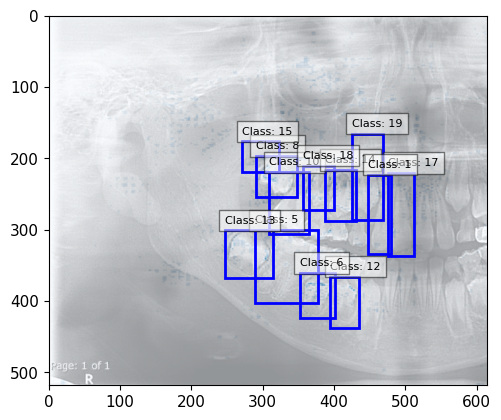

In [ ]:
selected_bboxes_WW75_9Y_M_neg = plot_bboxes_on_image_neg(Image_WW75_9Y_M_path, df_WW75_9Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_WW75_9Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,288.797021,300.666615,377.375088,402.125599,0.947565,5,Lower First Molar
1,289.963815,196.884303,347.958546,254.770946,0.938429,8,Upper Second Molar
2,246.404521,300.860450,313.937668,368.045330,0.933576,13,Lower Second Molar
3,476.086989,220.671427,512.134770,336.503621,0.923758,17,Upper Central Incisor
4,309.017533,219.415423,365.137845,305.861585,0.922747,10,Upper First Molar
5,394.730822,365.717834,435.229707,437.734653,0.911257,12,Lower First Premolar
6,387.651560,216.501190,430.328969,287.930531,0.903605,14,Upper First Premolar
7,351.834488,360.836433,400.815555,424.185285,0.900487,6,Lower Second Premolar
8,355.878777,210.464084,399.892572,271.966784,0.888687,18,Upper Second Premolar
9,448.032963,223.187432,480.303761,333.371702,0.882075,1,Upper Lateral Incisor


#### FlipWW75_9Y_M

In [ ]:
#FlipWW75_9Y_M
data= [np.array(shap_values_FlipWW75_9Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

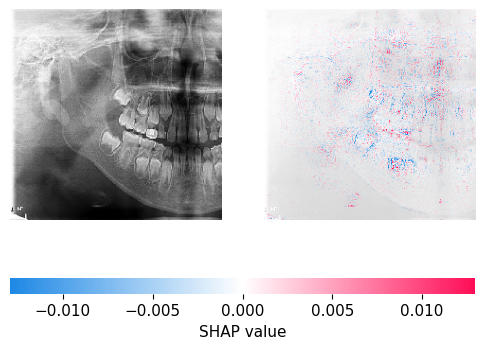

In [ ]:
shap.image_plot(shap_values_FlipWW75_9Y_M, background_test_array[[84]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

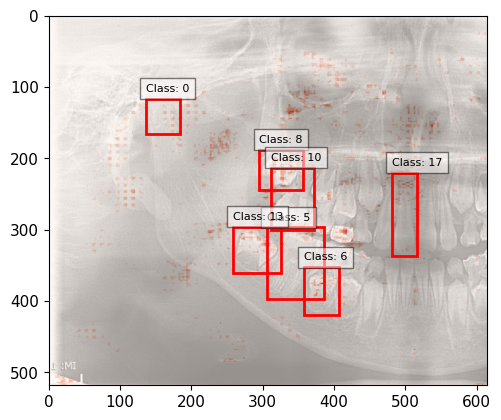

In [ ]:
selected_bboxes_FlipWW75_9Y_M_pos = plot_bboxes_on_image_pos(Image_FlipWW75_9Y_M_path, df_FlipWW75_9Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_FlipWW75_9Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,305.741823,296.769392,385.684311,397.019210,0.944077,5,Lower First Molar
1,257.645422,296.210737,325.273484,360.527959,0.940331,13,Lower Second Molar
2,295.286446,188.046739,356.442887,243.791584,0.939538,8,Upper Second Molar
3,480.788748,220.546012,515.649716,337.345465,0.919901,17,Upper Central Incisor
4,311.545891,212.969498,371.803083,299.778150,0.918500,10,Upper First Molar
5,357.553028,352.669076,407.271164,420.104293,0.914474,6,Lower Second Premolar
6,135.844799,116.785737,183.770502,166.025724,0.844313,0,Condyle


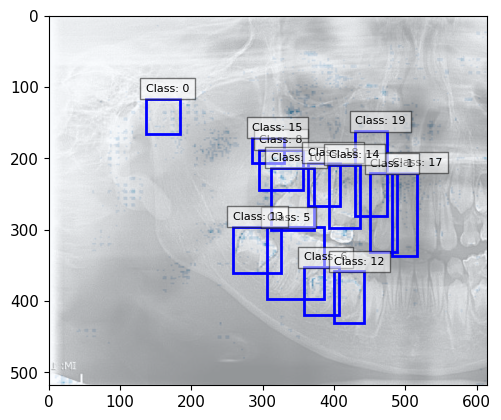

In [ ]:
selected_bboxes_FlipWW75_9Y_M_neg = plot_bboxes_on_image_neg(Image_FlipWW75_9Y_M_path, df_FlipWW75_9Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_FlipWW75_9Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,305.741823,296.769392,385.684311,397.019210,0.944077,5,Lower First Molar
1,257.645422,296.210737,325.273484,360.527959,0.940331,13,Lower Second Molar
2,295.286446,188.046739,356.442887,243.791584,0.939538,8,Upper Second Molar
3,480.788748,220.546012,515.649716,337.345465,0.919901,17,Upper Central Incisor
4,311.545891,212.969498,371.803083,299.778150,0.918500,10,Upper First Molar
5,357.553028,352.669076,407.271164,420.104293,0.914474,6,Lower Second Premolar
6,400.122659,358.510696,442.141391,431.141284,0.914151,12,Lower First Premolar
7,429.405840,162.022877,473.898547,280.919050,0.885536,19,Upper Canine
8,450.896186,221.162080,488.599736,331.903123,0.878186,1,Upper Lateral Incisor
9,363.339383,205.887220,408.204467,266.685765,0.871541,18,Upper Second Premolar


### 10 Year

#### เลือกรูปที่ต้องการหาค่า SHAP Value

In [ ]:
sdf_test

,Age(year),Gender,Folder_type,Folder_name,Path_Name,...,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.423399,7,0.005142,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.415316,7,0.046188,Female,0.0
2,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.492433,7,0.000020,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.343049,7,0.020910,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.095627,7,0.003455,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...
286,22,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.010904,22,0.999999,Male,1.0
287,22,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,21.844440,22,0.999998,Male,1.0
288,23,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.836693,23,0.999958,Male,1.0
289,25,F,Normal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,24.869873,25,1.000000,Male,1.0


In [ ]:
from PIL import Image
Image_H79_10Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/10Y/F/Both/H79.jpg')
Image_H79_10Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/10Y/F/Both/H79.jpg'

Image_H83_10Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/10Y/F/Both/H83.jpg')
Image_H83_10Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/10Y/F/Both/H83.jpg'

Image_FlipH83_10Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/10Y/F/Both/FlipH83.jpg')
Image_FlipH83_10Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/10Y/F/Both/FlipH83.jpg'

Image_HH82_10Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/10Y/M/Both/HH82.jpg')
Image_HH82_10Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/10Y/M/Both/HH82.jpg'

Image_FlipHH82_10Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/10Y/M/Both/FlipHH82.jpg')
Image_FlipHH82_10Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/10Y/M/Both/FlipHH82.jpg'

In [ ]:
sdf_test.reset_index().iloc[101]

index                                                               101
Age(year)                                                            10
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                        H79.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                    9.830461
Age_predict_int                                                      10
Gender_predict                                                 0.974702
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[103]

index                                                               103
Age(year)                                                            10
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                        H83.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                    10.26381
Age_predict_int                                                      10
Gender_predict                                                 0.444675
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[104] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               104
Age(year)                                                            10
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                    FlipH83.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   10.085037
Age_predict_int                                                      10
Gender_predict                                                 0.544921
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[111] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               111
Age(year)                                                            10
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                       HH82.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                     9.92433
Age_predict_int                                                      10
Gender_predict                                                 0.999993
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[112] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               112
Age(year)                                                            10
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                   FlipHH82.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                   10.126051
Age_predict_int                                                      10
Gender_predict                                                 0.999994
Gender_predict_str                                                 Male
Gender_predict_int                                              

#### YOLO (detect ตห)

In [ ]:
# YOLO detect ตำแหน่ง
#ภาพ1
results_H79_10Y_F = yolo_model(Image_H79_10Y_F) # results = ผลจากการทำนาย
df_H79_10Y_F = results_H79_10Y_F.pandas().xyxyn[0] #.pandas ทำให้เป็น dataframe // .xyxy ตห.กล่อง ///  n normalization ค่าให้มีค่าอยู่ระหว่าง 0-1 //[0]= index
#ภาพ2
results_H83_10Y_F = yolo_model(Image_H83_10Y_F)
df_H83_10Y_F = results_H83_10Y_F.pandas().xyxyn[0]
#ภาพ3
results_FlipH83_10Y_F = yolo_model(Image_FlipH83_10Y_F)
df_FlipH83_10Y_F = results_FlipH83_10Y_F.pandas().xyxyn[0]
#ภาพ4
results_HH82_10Y_M = yolo_model(Image_HH82_10Y_M)
df_HH82_10Y_M = results_HH82_10Y_M.pandas().xyxyn[0]
#ภาพ5
results_FlipHH82_10Y_M = yolo_model(Image_FlipHH82_10Y_M)
df_FlipHH82_10Y_M= results_FlipHH82_10Y_M.pandas().xyxyn[0]

##### NMS

In [ ]:
df_H79_10Y_F_filtered_nms = nms_per_class(df_H79_10Y_F,iou_threshold=0.5)
df_H83_10Y_F_filtered_nms = nms_per_class(df_H83_10Y_F,iou_threshold=0.5)
df_FlipH83_10Y_F_filtered_nms = nms_per_class(df_FlipH83_10Y_F,iou_threshold=0.5)
df_HH82_10Y_M_filtered_nms = nms_per_class(df_HH82_10Y_M,iou_threshold=0.5)
df_FlipHH82_10Y_M_filtered_nms = nms_per_class(df_FlipHH82_10Y_M,iou_threshold=0.5)

#### SHAP values

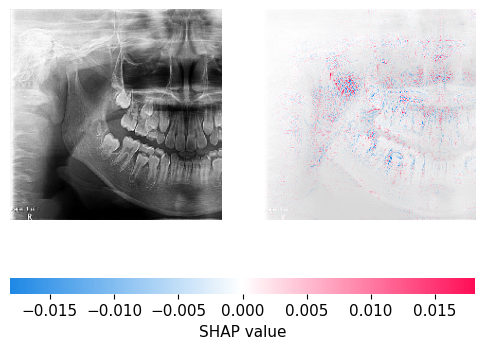

In [ ]:
shap_values_H79_10Y_F = explainer_layer1.shap_values(background_test_array[[101]])
%matplotlib inline
shap.image_plot(shap_values_H79_10Y_F, background_test_array[[101]])

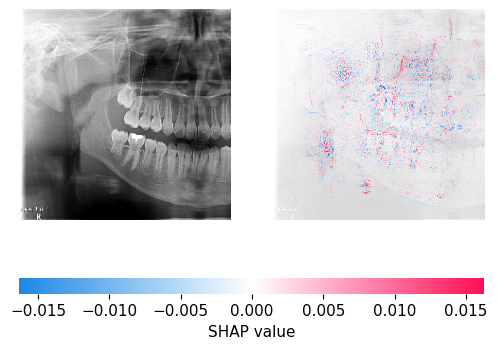

In [ ]:
shap_values_H83_10Y_F = explainer_layer1.shap_values(background_test_array[[103]])
%matplotlib inline
shap.image_plot(shap_values_H83_10Y_F, background_test_array[[103]])

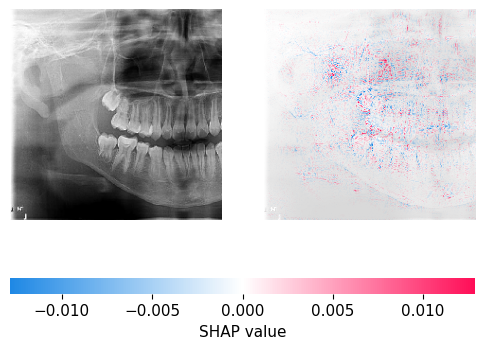

In [ ]:
shap_values_FlipH83_10Y_F = explainer_layer1.shap_values(background_test_array[[104]])
%matplotlib inline
shap.image_plot(shap_values_FlipH83_10Y_F, background_test_array[[104]])

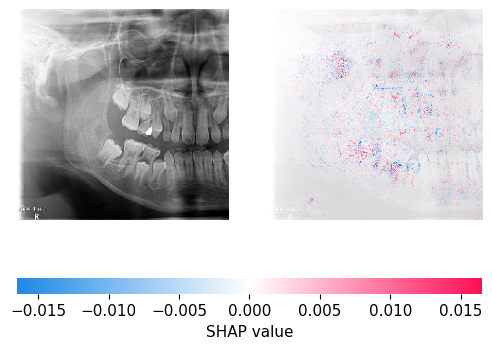

In [ ]:
shap_values_HH82_10Y_M = explainer_layer1.shap_values(background_test_array[[111]])
%matplotlib inline
shap.image_plot(shap_values_HH82_10Y_M, background_test_array[[111]])

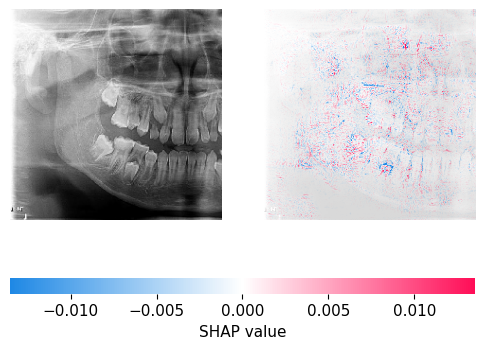

In [ ]:
shap_values_FlipHH82_10Y_M = explainer_layer1.shap_values(background_test_array[[112]])
%matplotlib inline
shap.image_plot(shap_values_FlipHH82_10Y_M, background_test_array[[112]])

#### convert shap value from RGB to grayscale image

In [ ]:
type(shap_values_FlipHH82_10Y_M)

list

#### H79_10Y_F

In [ ]:
#H79_10Y_F
data= [np.array(shap_values_H79_10Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

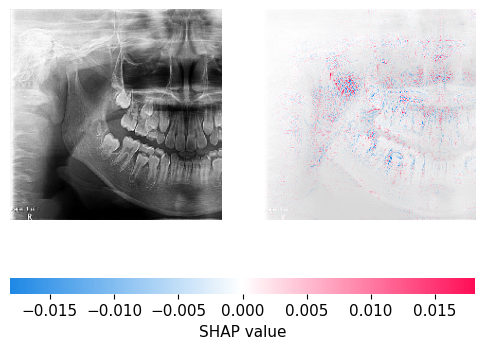

In [ ]:
shap.image_plot(shap_values_H79_10Y_F, background_test_array[[101]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

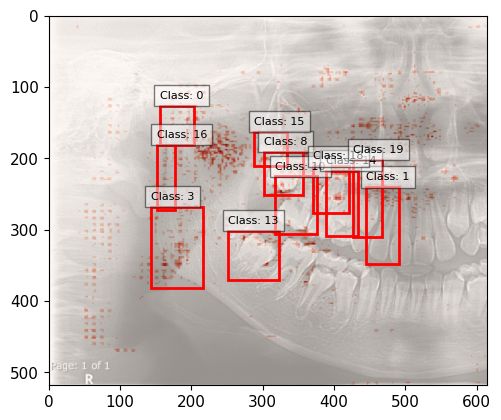

In [ ]:
selected_bboxes_H79_10Y_F_pos = plot_bboxes_on_image_pos(Image_H79_10Y_F_path, df_H79_10Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_H79_10Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,251.397502,301.793838,322.677201,370.866491,0.936583,13,Lower Second Molar
1,317.327488,225.138544,375.493331,305.754757,0.918973,10,Upper First Molar
2,301.291561,190.605398,356.518204,251.487615,0.912697,8,Upper Second Molar
3,445.330695,240.240117,491.081652,347.814846,0.902838,1,Upper Lateral Incisor
4,388.166630,217.547211,434.122640,308.441486,0.882802,14,Upper First Premolar
5,142.882305,268.027138,215.973485,381.037648,0.876989,3,Mandibular angle
6,287.797971,162.822545,333.544755,210.677478,0.876057,15,Upper Third Molar
7,370.681158,211.040122,421.139912,276.877300,0.871443,18,Upper Second Premolar
8,155.539126,125.948356,204.302731,180.632490,0.862068,0,Condyle
9,427.028519,201.943885,466.657488,310.843732,0.833434,19,Upper Canine


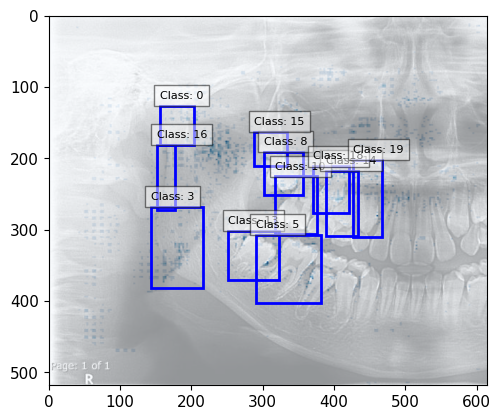

In [ ]:
selected_bboxes_H79_10Y_F_neg = plot_bboxes_on_image_neg(Image_H79_10Y_F_path, df_H79_10Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_H79_10Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,251.397502,301.793838,322.677201,370.866491,0.936583,13,Lower Second Molar
1,289.914298,307.380738,381.555702,403.187335,0.933023,5,Lower First Molar
2,317.327488,225.138544,375.493331,305.754757,0.918973,10,Upper First Molar
3,301.291561,190.605398,356.518204,251.487615,0.912697,8,Upper Second Molar
4,388.166630,217.547211,434.122640,308.441486,0.882802,14,Upper First Premolar
5,142.882305,268.027138,215.973485,381.037648,0.876989,3,Mandibular angle
6,287.797971,162.822545,333.544755,210.677478,0.876057,15,Upper Third Molar
7,370.681158,211.040122,421.139912,276.877300,0.871443,18,Upper Second Premolar
8,155.539126,125.948356,204.302731,180.632490,0.862068,0,Condyle
9,427.028519,201.943885,466.657488,310.843732,0.833434,19,Upper Canine


#### H83_10Y_F

In [ ]:
#H83_10Y_F
data= [np.array(shap_values_H83_10Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

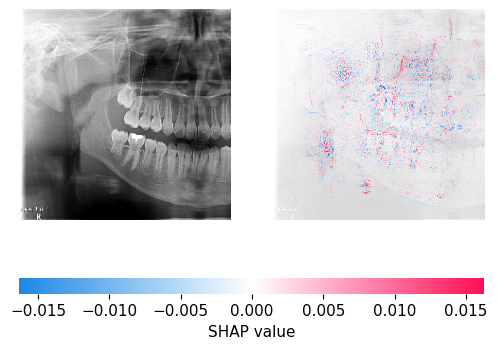

In [ ]:
shap.image_plot(shap_values_H83_10Y_F, background_test_array[[103]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

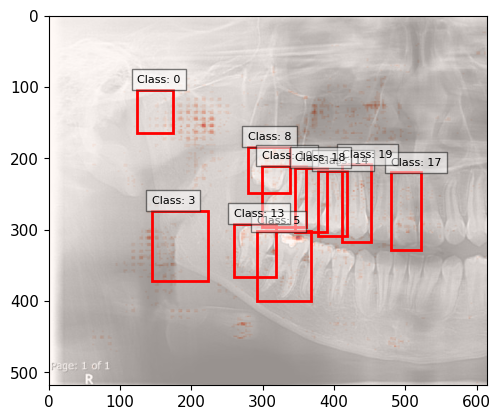

In [ ]:
selected_bboxes_H83_10Y_F_pos = plot_bboxes_on_image_pos(Image_H83_10Y_F_path, df_H83_10Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_H83_10Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,291.771005,302.050936,367.119001,399.961309,0.925295,5,Lower First Molar
1,279.097633,183.859335,338.055110,249.205350,0.923831,8,Upper Second Molar
2,298.964927,210.069576,360.119045,296.481049,0.918117,10,Upper First Molar
3,259.449685,291.479852,318.353126,365.952979,0.917052,13,Lower Second Molar
4,377.361803,217.595484,417.783761,308.969730,0.900763,14,Upper First Premolar
5,479.714070,219.641862,521.198116,328.480298,0.871323,17,Upper Central Incisor
6,411.621772,208.427524,452.187117,317.660205,0.870166,19,Upper Canine
7,123.838952,104.239165,174.469201,164.560942,0.850607,0,Condyle
8,144.056747,273.805649,222.761104,371.738592,0.814155,3,Mandibular angle
9,345.369657,213.329905,389.936216,302.908155,0.776410,18,Upper Second Premolar


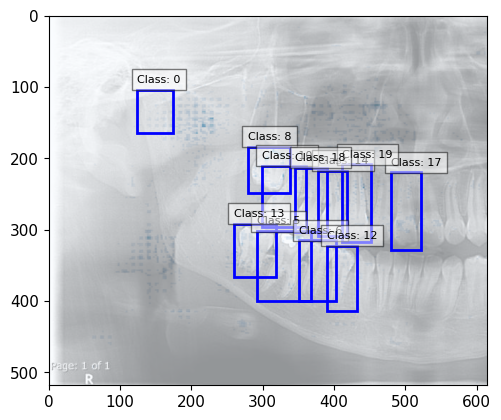

In [ ]:
selected_bboxes_H83_10Y_F_neg = plot_bboxes_on_image_neg(Image_H83_10Y_F_path, df_H83_10Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_H83_10Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,291.771005,302.050936,367.119001,399.961309,0.925295,5,Lower First Molar
1,279.097633,183.859335,338.055110,249.205350,0.923831,8,Upper Second Molar
2,298.964927,210.069576,360.119045,296.481049,0.918117,10,Upper First Molar
3,259.449685,291.479852,318.353126,365.952979,0.917052,13,Lower Second Molar
4,350.303698,314.862232,402.409694,400.014229,0.908183,6,Lower Second Premolar
5,377.361803,217.595484,417.783761,308.969730,0.900763,14,Upper First Premolar
6,479.714070,219.641862,521.198116,328.480298,0.871323,17,Upper Central Incisor
7,411.621772,208.427524,452.187117,317.660205,0.870166,19,Upper Canine
8,389.355784,322.518110,431.600614,413.291339,0.867797,12,Lower First Premolar
9,123.838952,104.239165,174.469201,164.560942,0.850607,0,Condyle


#### FlipH83_10Y_F

In [ ]:
#FlipH83_10Y_F
data= [np.array(shap_values_FlipH83_10Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

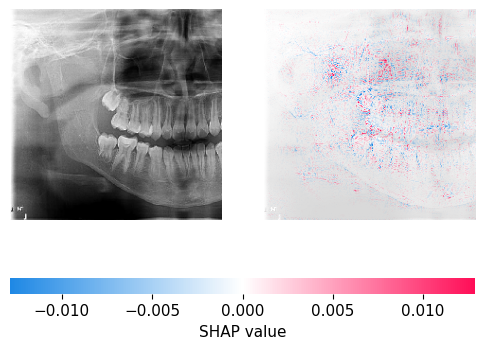

In [ ]:
shap.image_plot(shap_values_FlipH83_10Y_F, background_test_array[[104]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

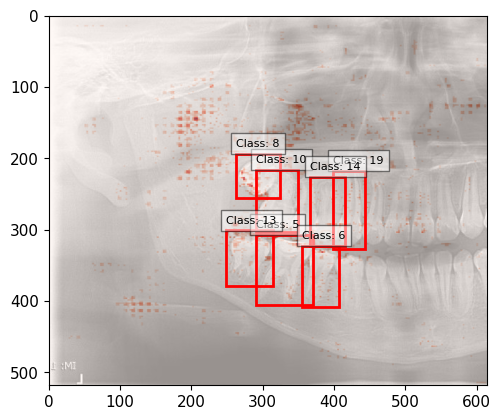

In [ ]:
selected_bboxes_FlipH83_10Y_F_pos = plot_bboxes_on_image_pos(Image_FlipH83_10Y_F_path, df_FlipH83_10Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_FlipH83_10Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,290.149802,307.470060,369.802934,405.449809,0.929257,5,Lower First Molar
1,249.088307,300.887250,314.342543,379.240958,0.925621,13,Lower Second Molar
2,291.080470,215.860853,349.086620,303.742650,0.922614,10,Upper First Molar
3,262.569436,193.300865,324.663041,256.024448,0.898522,8,Upper Second Molar
4,355.622816,322.418723,406.979081,408.340376,0.892322,6,Lower Second Premolar
5,398.858736,217.715836,442.840472,327.689769,0.865393,19,Upper Canine
6,366.646494,225.540941,415.092143,322.231835,0.847821,14,Upper First Premolar


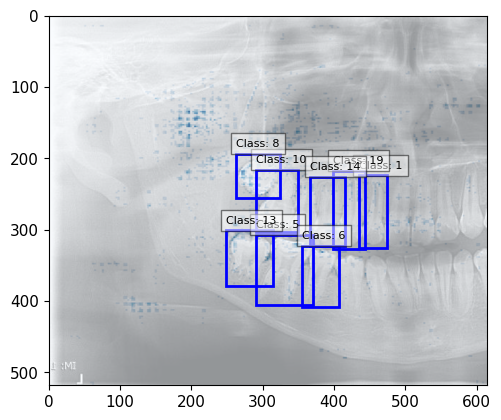

In [ ]:
selected_bboxes_FlipH83_10Y_F_neg = plot_bboxes_on_image_neg(Image_FlipH83_10Y_F_path, df_FlipH83_10Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_FlipH83_10Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,290.149802,307.470060,369.802934,405.449809,0.929257,5,Lower First Molar
1,249.088307,300.887250,314.342543,379.240958,0.925621,13,Lower Second Molar
2,291.080470,215.860853,349.086620,303.742650,0.922614,10,Upper First Molar
3,262.569436,193.300865,324.663041,256.024448,0.898522,8,Upper Second Molar
4,355.622816,322.418723,406.979081,408.340376,0.892322,6,Lower Second Premolar
5,434.899820,223.875686,473.948539,326.095960,0.873530,1,Upper Lateral Incisor
6,398.858736,217.715836,442.840472,327.689769,0.865393,19,Upper Canine
7,366.646494,225.540941,415.092143,322.231835,0.847821,14,Upper First Premolar


#### HH82_10Y_M

In [ ]:
#HH82_10Y_M
data= [np.array(shap_values_HH82_10Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

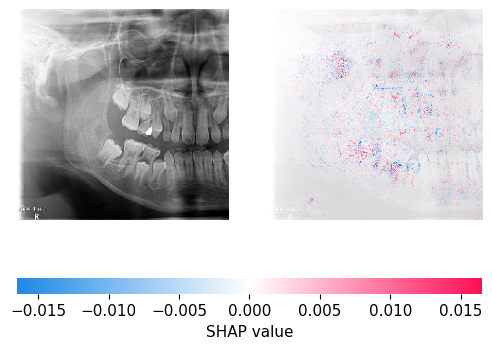

In [ ]:
shap.image_plot(shap_values_HH82_10Y_M, background_test_array[[111]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

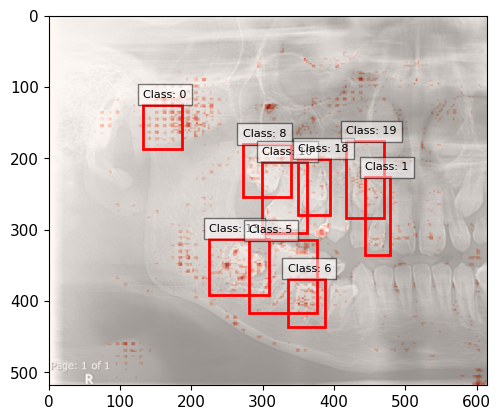

In [ ]:
selected_bboxes_HH82_10Y_M_pos = plot_bboxes_on_image_pos(Image_HH82_10Y_M_path, df_HH82_10Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_HH82_10Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,225.030610,312.806005,308.546527,391.662949,0.946571,13,Lower Second Molar
1,280.985264,314.760622,376.555017,417.154538,0.941846,5,Lower First Molar
2,271.961004,180.024295,339.542093,254.430238,0.941280,8,Upper Second Molar
3,299.442832,204.887172,361.732874,305.068524,0.937539,10,Upper First Molar
4,349.521395,200.500269,394.740338,279.846507,0.902191,18,Upper Second Premolar
5,334.744816,368.717947,387.013231,436.431874,0.896336,6,Lower Second Premolar
6,417.231874,176.009654,469.674236,284.042633,0.871917,19,Upper Canine
7,443.731359,226.485830,478.381490,335.203528,0.861701,1,Upper Lateral Incisor
8,132.711809,124.650956,186.545049,187.310921,0.856117,0,Condyle


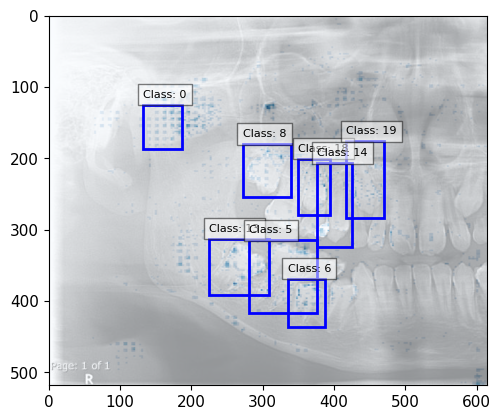

In [ ]:
selected_bboxes_HH82_10Y_M_neg = plot_bboxes_on_image_neg(Image_HH82_10Y_M_path, df_HH82_10Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_HH82_10Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,225.030610,312.806005,308.546527,391.662949,0.946571,13,Lower Second Molar
1,280.985264,314.760622,376.555017,417.154538,0.941846,5,Lower First Molar
2,271.961004,180.024295,339.542093,254.430238,0.941280,8,Upper Second Molar
3,349.521395,200.500269,394.740338,279.846507,0.902191,18,Upper Second Premolar
4,334.744816,368.717947,387.013231,436.431874,0.896336,6,Lower Second Premolar
5,417.231874,176.009654,469.674236,284.042633,0.871917,19,Upper Canine
6,376.131916,206.723027,425.079020,324.175646,0.870502,14,Upper First Premolar
7,132.711809,124.650956,186.545049,187.310921,0.856117,0,Condyle


#### FlipHH82_10Y_M

In [ ]:
#FlipHH82_10Y_M
data= [np.array(shap_values_FlipHH82_10Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

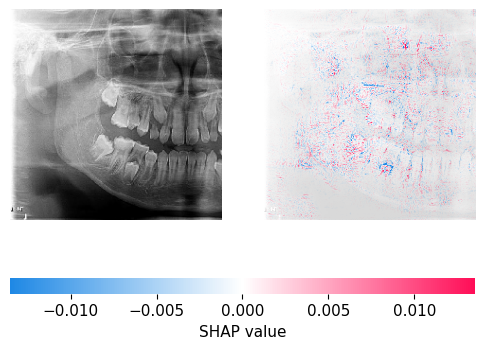

In [ ]:
shap.image_plot(shap_values_FlipHH82_10Y_M, background_test_array[[112]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

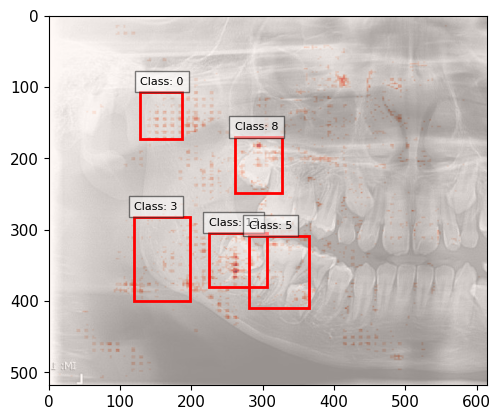

In [ ]:
selected_bboxes_FlipHH82_10Y_M_pos = plot_bboxes_on_image_pos(Image_FlipHH82_10Y_M_path, df_FlipHH82_10Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_FlipHH82_10Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,223.973187,304.316744,305.541380,379.810729,0.947796,13,Lower Second Molar
1,280.097415,308.649215,364.873430,409.380470,0.941930,5,Lower First Molar
2,260.700981,170.263253,326.942318,248.016794,0.929595,8,Upper Second Molar
3,128.031597,106.998351,186.673378,173.253285,0.854707,0,Condyle
4,119.678458,281.550108,197.698153,399.489659,0.841181,3,Mandibular angle


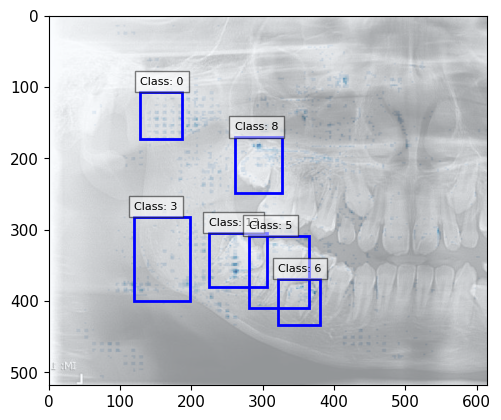

In [ ]:
selected_bboxes_FlipHH82_10Y_M_neg = plot_bboxes_on_image_neg(Image_FlipHH82_10Y_M_path, df_FlipHH82_10Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_FlipHH82_10Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,223.973187,304.316744,305.541380,379.810729,0.947796,13,Lower Second Molar
1,280.097415,308.649215,364.873430,409.380470,0.941930,5,Lower First Molar
2,260.700981,170.263253,326.942318,248.016794,0.929595,8,Upper Second Molar
3,321.722013,369.159987,379.985643,433.219617,0.908056,6,Lower Second Premolar
4,128.031597,106.998351,186.673378,173.253285,0.854707,0,Condyle
5,119.678458,281.550108,197.698153,399.489659,0.841181,3,Mandibular angle


### 11 Year

#### เลือกรูปที่ต้องการหาค่า SHAP Value

In [ ]:
sdf_test

,Age(year),Gender,Folder_type,Folder_name,Path_Name,...,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.423399,7,0.005142,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.415316,7,0.046188,Female,0.0
2,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.492433,7,0.000020,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.343049,7,0.020910,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.095627,7,0.003455,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...
286,22,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.010904,22,0.999999,Male,1.0
287,22,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,21.844440,22,0.999998,Male,1.0
288,23,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.836693,23,0.999958,Male,1.0
289,25,F,Normal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,24.869873,25,1.000000,Male,1.0


In [ ]:
from PIL import Image
Image_D79_11Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/11Y/F/Both/D79.jpg')
Image_D79_11Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/11Y/F/Both/D79.jpg'

Image_D89_11Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/11Y/F/Both/D89.jpg')
Image_D89_11Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/11Y/F/Both/D89.jpg'

Image_FlipD89_11Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/11Y/F/Both/FlipD89.jpg')
Image_FlipD89_11Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/11Y/F/Both/FlipD89.jpg'

Image_DD100_11Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/11Y/M/Both/DD100.jpg')
Image_DD100_11Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/11Y/M/Both/DD100.jpg'

Image_FlipDD100_11Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/11Y/M/Both/FlipDD100.jpg')
Image_FlipDD100_11Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/11Y/M/Both/FlipDD100.jpg'

In [ ]:
sdf_test.reset_index().iloc[119]

index                                                               119
Age(year)                                                            11
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                        D79.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   10.546963
Age_predict_int                                                      11
Gender_predict                                                 0.000011
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[121]

index                                                               121
Age(year)                                                            11
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                        D89.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   10.524641
Age_predict_int                                                      11
Gender_predict                                                 0.000161
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[122] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               122
Age(year)                                                            11
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                    FlipD89.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   10.887312
Age_predict_int                                                      11
Gender_predict                                                 0.000027
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[127] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               127
Age(year)                                                            11
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                      DD100.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                   10.855518
Age_predict_int                                                      11
Gender_predict                                                 0.999998
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[128] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               128
Age(year)                                                            11
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                  FlipDD100.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                   10.668304
Age_predict_int                                                      11
Gender_predict                                                 0.996336
Gender_predict_str                                                 Male
Gender_predict_int                                              

#### YOLO (detect ตห)

In [ ]:
# YOLO detect ตำแหน่ง
#ภาพ1
results_D79_11Y_F = yolo_model(Image_D79_11Y_F) # results = ผลจากการทำนาย
df_D79_11Y_F = results_D79_11Y_F.pandas().xyxyn[0] #.pandas ทำให้เป็น dataframe // .xyxy ตห.กล่อง ///  n normalization ค่าให้มีค่าอยู่ระหว่าง 0-1 //[0]= index
#ภาพ2
results_D89_11Y_F = yolo_model(Image_D89_11Y_F)
df_D89_11Y_F = results_D89_11Y_F.pandas().xyxyn[0]
#ภาพ3
results_FlipD89_11Y_F = yolo_model(Image_FlipD89_11Y_F)
df_FlipD89_11Y_F = results_FlipD89_11Y_F.pandas().xyxyn[0]
#ภาพ4
results_DD100_11Y_M = yolo_model(Image_DD100_11Y_M)
df_DD100_11Y_M = results_DD100_11Y_M.pandas().xyxyn[0]
#ภาพ5
results_FlipDD100_11Y_M = yolo_model(Image_FlipDD100_11Y_M)
df_FlipDD100_11Y_M= results_FlipDD100_11Y_M.pandas().xyxyn[0]

##### NMS

In [ ]:
df_D79_11Y_F_filtered_nms = nms_per_class(df_D79_11Y_F,iou_threshold=0.5)
df_D89_11Y_F_filtered_nms = nms_per_class(df_D89_11Y_F,iou_threshold=0.5)
df_FlipD89_11Y_F_filtered_nms = nms_per_class(df_FlipD89_11Y_F,iou_threshold=0.5)
df_DD100_11Y_M_filtered_nms = nms_per_class(df_DD100_11Y_M,iou_threshold=0.5)
df_FlipDD100_11Y_M_filtered_nms = nms_per_class(df_FlipDD100_11Y_M,iou_threshold=0.5)

#### SHAP values

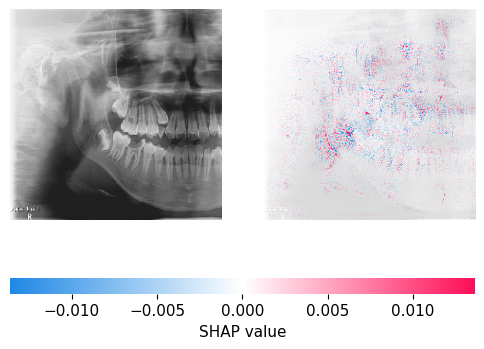

In [ ]:
shap_values_D79_11Y_F = explainer_layer1.shap_values(background_test_array[[119]])
%matplotlib inline
shap.image_plot(shap_values_D79_11Y_F, background_test_array[[119]])

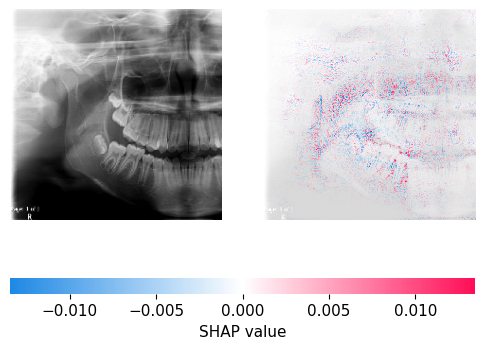

In [ ]:
shap_values_D89_11Y_F = explainer_layer1.shap_values(background_test_array[[121]])
%matplotlib inline
shap.image_plot(shap_values_D89_11Y_F, background_test_array[[121]])

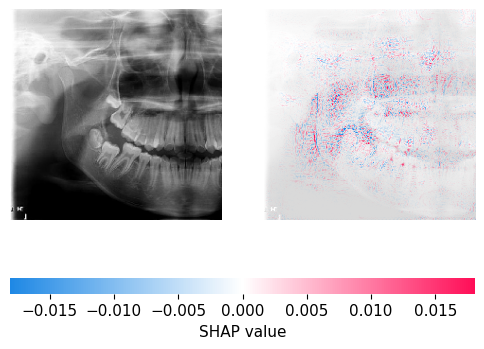

In [ ]:
shap_values_FlipD89_11Y_F = explainer_layer1.shap_values(background_test_array[[122]])
%matplotlib inline
shap.image_plot(shap_values_FlipD89_11Y_F, background_test_array[[122]])

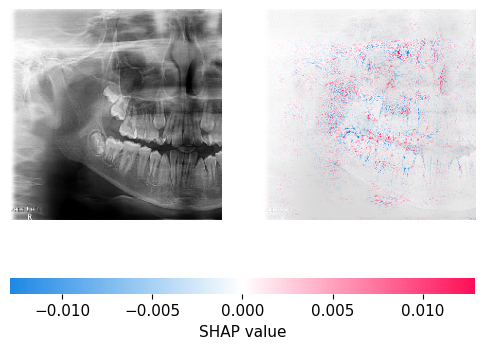

In [ ]:
shap_values_DD100_11Y_M = explainer_layer1.shap_values(background_test_array[[127]])
%matplotlib inline
shap.image_plot(shap_values_DD100_11Y_M, background_test_array[[127]])

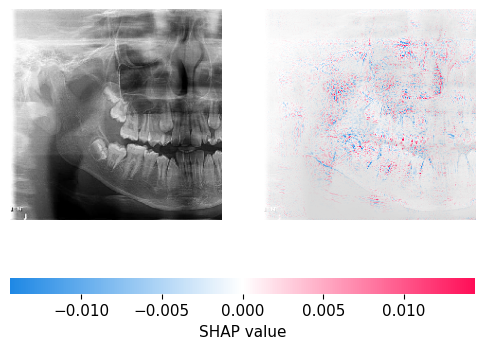

In [ ]:
shap_values_FlipDD100_11Y_M = explainer_layer1.shap_values(background_test_array[[128]])
%matplotlib inline
shap.image_plot(shap_values_FlipDD100_11Y_M, background_test_array[[128]])

#### convert shap value from RGB to grayscale image

In [ ]:
type(shap_values_FlipDD100_11Y_M)

list

#### D79_11Y_F

In [ ]:
#D79_11Y_F
data= [np.array(shap_values_D79_11Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

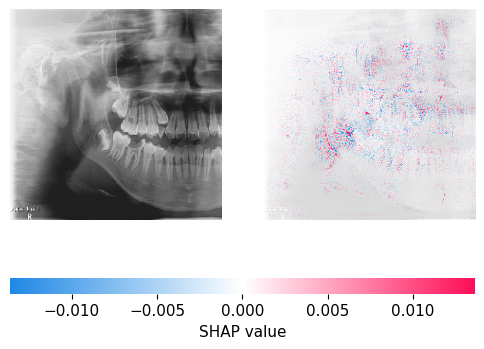

In [ ]:
shap.image_plot(shap_values_D79_11Y_F, background_test_array[[119]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

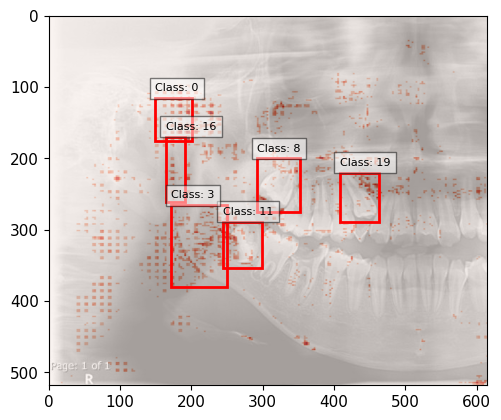

In [ ]:
selected_bboxes_D79_11Y_F_pos = plot_bboxes_on_image_pos(Image_D79_11Y_F_path, df_D79_11Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_D79_11Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,292.074378,200.049475,351.521435,274.607911,0.917697,8,Upper Second Molar
1,243.884361,288.901989,298.641261,353.311682,0.909301,11,Lower Third Molar
2,171.728158,265.614673,249.591666,379.576664,0.887919,3,Mandibular angle
3,149.491119,115.738542,200.905335,175.745022,0.844523,0,Condyle
4,163.766810,169.879999,190.385602,261.083737,0.806583,16,Posterior border of Ramus
5,408.094492,220.259335,462.501431,289.640184,0.765410,19,Upper Canine


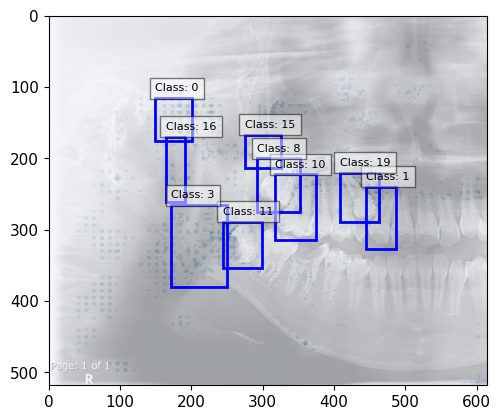

In [ ]:
selected_bboxes_D79_11Y_F_neg = plot_bboxes_on_image_neg(Image_D79_11Y_F_path, df_D79_11Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_D79_11Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,317.743672,222.420414,374.899613,314.547089,0.919195,10,Upper First Molar
1,292.074378,200.049475,351.521435,274.607911,0.917697,8,Upper Second Molar
2,243.884361,288.901989,298.641261,353.311682,0.909301,11,Lower Third Molar
3,171.728158,265.614673,249.591666,379.576664,0.887919,3,Mandibular angle
4,445.118468,239.857990,487.329189,326.580670,0.885705,1,Upper Lateral Incisor
5,275.004853,166.589629,325.825992,213.547945,0.863797,15,Upper Third Molar
6,149.491119,115.738542,200.905335,175.745022,0.844523,0,Condyle
7,163.766810,169.879999,190.385602,261.083737,0.806583,16,Posterior border of Ramus
8,408.094492,220.259335,462.501431,289.640184,0.765410,19,Upper Canine


#### D89_11Y_F

In [ ]:
#D89_11Y_F
data= [np.array(shap_values_D89_11Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

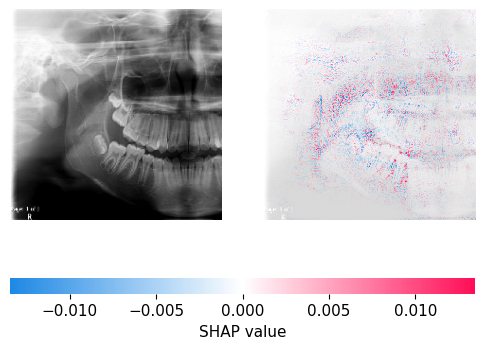

In [ ]:
shap.image_plot(shap_values_D89_11Y_F, background_test_array[[121]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

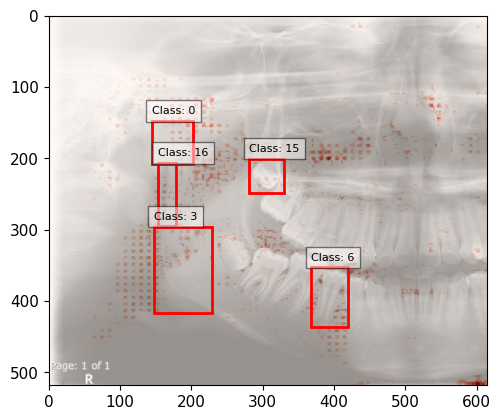

In [ ]:
selected_bboxes_D89_11Y_F_pos = plot_bboxes_on_image_pos(Image_D89_11Y_F_path, df_D89_11Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_D89_11Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,368.213881,352.755157,419.846053,436.535522,0.899107,6,Lower Second Premolar
1,144.778518,147.775606,202.893152,208.384515,0.885763,0,Condyle
2,280.876644,200.742840,329.081611,248.042019,0.879942,15,Upper Third Molar
3,147.355285,296.168067,228.810063,416.383707,0.843978,3,Mandibular angle
4,152.673570,206.630263,177.851262,294.180784,0.776731,16,Posterior border of Ramus


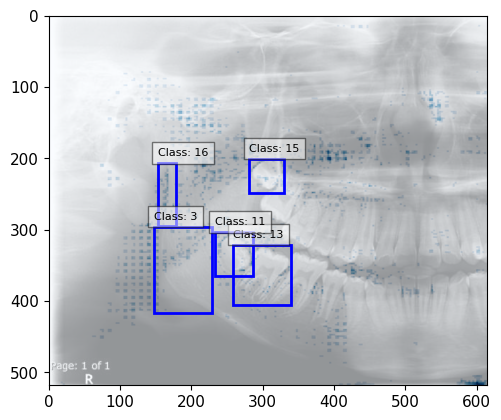

In [ ]:
selected_bboxes_D89_11Y_F_neg = plot_bboxes_on_image_neg(Image_D89_11Y_F_path, df_D89_11Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_D89_11Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,258.491020,321.270196,339.599441,405.607952,0.933225,13,Lower Second Molar
1,232.794680,303.337382,286.891054,364.981028,0.896978,11,Lower Third Molar
2,280.876644,200.742840,329.081611,248.042019,0.879942,15,Upper Third Molar
3,147.355285,296.168067,228.810063,416.383707,0.843978,3,Mandibular angle
4,152.673570,206.630263,177.851262,294.180784,0.776731,16,Posterior border of Ramus


#### FlipD89_11Y_F

In [ ]:
#FlipD89_11Y_F
data= [np.array(shap_values_FlipD89_11Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

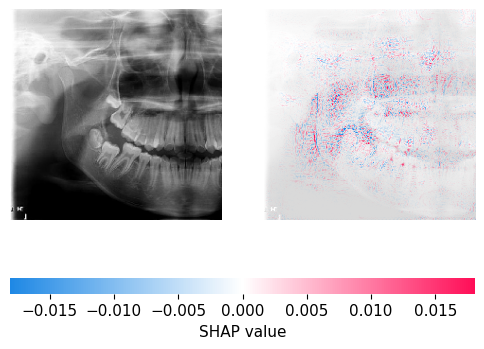

In [ ]:
shap.image_plot(shap_values_FlipD89_11Y_F, background_test_array[[122]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

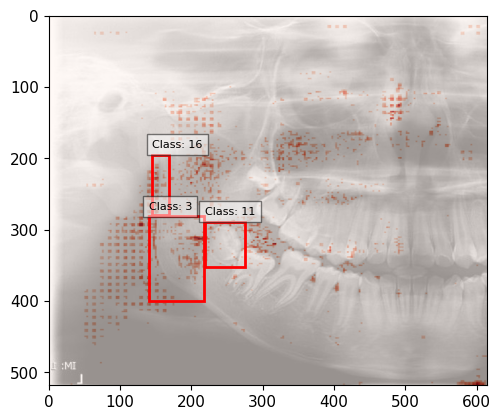

In [ ]:
selected_bboxes_FlipD89_11Y_F_pos = plot_bboxes_on_image_pos(Image_FlipD89_11Y_F_path, df_FlipD89_11Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_FlipD89_11Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,218.446984,288.945708,275.629677,352.636935,0.895415,11,Lower Third Molar
1,139.864093,281.372699,216.940366,399.879644,0.868784,3,Mandibular angle
2,144.994872,194.736809,169.085489,279.378593,0.777667,16,Posterior border of Ramus


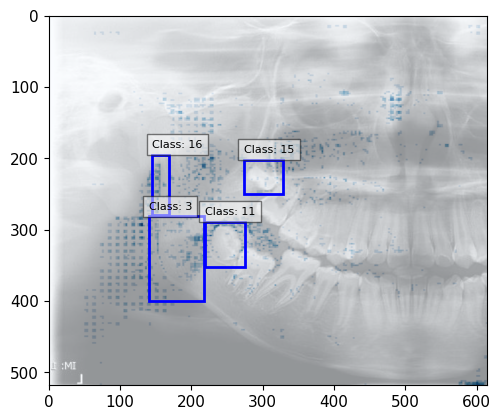

In [ ]:
selected_bboxes_FlipD89_11Y_F_neg = plot_bboxes_on_image_neg(Image_FlipD89_11Y_F_path, df_FlipD89_11Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_FlipD89_11Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,218.446984,288.945708,275.629677,352.636935,0.895415,11,Lower Third Molar
1,139.864093,281.372699,216.940366,399.879644,0.868784,3,Mandibular angle
2,273.697965,201.571638,328.873702,250.332743,0.865606,15,Upper Third Molar
3,144.994872,194.736809,169.085489,279.378593,0.777667,16,Posterior border of Ramus


#### DD100_11Y_M

In [ ]:
#DD100_11Y_M
data= [np.array(shap_values_DD100_11Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

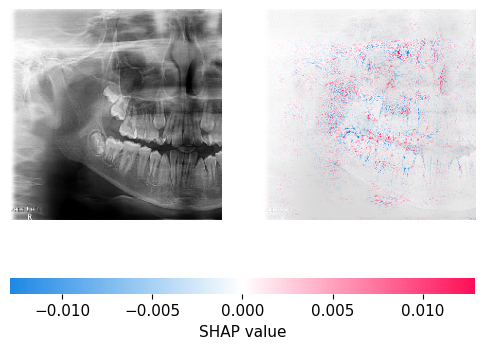

In [ ]:
shap.image_plot(shap_values_DD100_11Y_M, background_test_array[[127]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

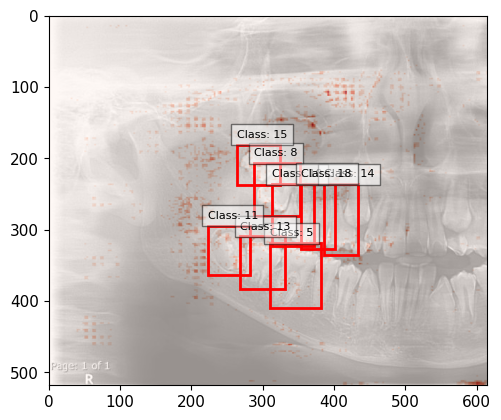

In [ ]:
selected_bboxes_DD100_11Y_M_pos = plot_bboxes_on_image_pos(Image_DD100_11Y_M_path, df_DD100_11Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_DD100_11Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,288.005587,206.910795,351.511005,280.424336,0.930531,8,Upper Second Molar
1,309.537214,319.024704,381.518446,409.000427,0.924092,5,Lower First Molar
2,263.819799,180.853294,324.350428,237.056404,0.916130,15,Upper Third Molar
3,268.589391,309.265206,330.539938,383.424672,0.915052,13,Lower Second Molar
4,222.530908,294.831016,281.496857,362.989577,0.912988,11,Lower Third Molar
5,312.671513,236.204465,372.022996,322.492792,0.902834,10,Upper First Molar
6,385.140476,236.233024,433.746018,334.893325,0.898752,14,Upper First Premolar
7,354.198963,235.603047,400.957662,326.986185,0.865663,18,Upper Second Premolar


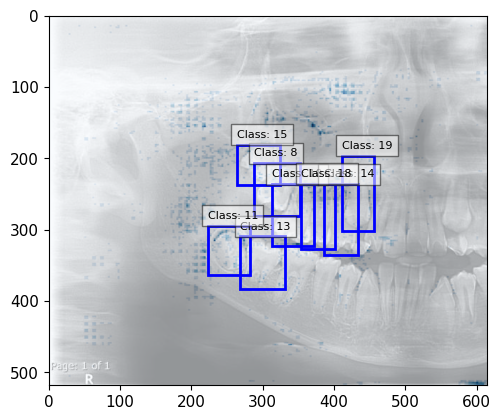

In [ ]:
selected_bboxes_DD100_11Y_M_neg = plot_bboxes_on_image_neg(Image_DD100_11Y_M_path, df_DD100_11Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_DD100_11Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,288.005587,206.910795,351.511005,280.424336,0.930531,8,Upper Second Molar
1,263.819799,180.853294,324.350428,237.056404,0.916130,15,Upper Third Molar
2,268.589391,309.265206,330.539938,383.424672,0.915052,13,Lower Second Molar
3,222.530908,294.831016,281.496857,362.989577,0.912988,11,Lower Third Molar
4,312.671513,236.204465,372.022996,322.492792,0.902834,10,Upper First Molar
5,385.140476,236.233024,433.746018,334.893325,0.898752,14,Upper First Premolar
6,410.854986,196.769679,455.953414,301.317249,0.884881,19,Upper Canine
7,354.198963,235.603047,400.957662,326.986185,0.865663,18,Upper Second Premolar


#### FlipDD100_11Y_M

In [ ]:
#FlipDD100_11Y_M
data= [np.array(shap_values_FlipDD100_11Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

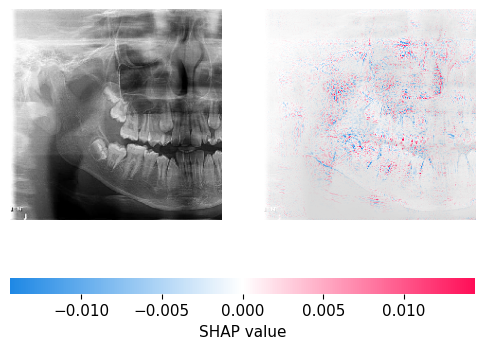

In [ ]:
shap.image_plot(shap_values_FlipDD100_11Y_M, background_test_array[[128]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

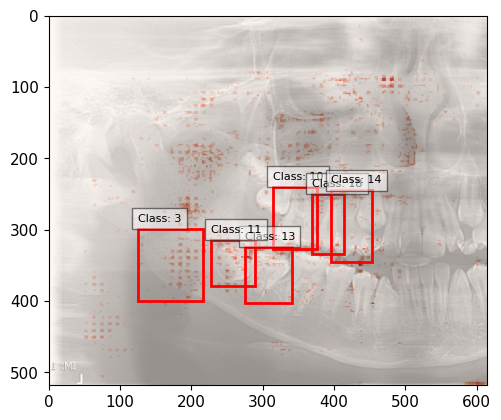

In [ ]:
selected_bboxes_FlipDD100_11Y_M_pos = plot_bboxes_on_image_pos(Image_FlipDD100_11Y_M_path, df_FlipDD100_11Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_FlipDD100_11Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,274.417265,324.009166,341.555418,401.999505,0.920288,13,Lower Second Molar
1,227.129883,314.408799,288.579158,378.256965,0.917766,11,Lower Third Molar
2,314.310411,239.554734,375.672840,327.106197,0.916369,10,Upper First Molar
3,368.707432,249.628958,413.236040,333.587674,0.885784,18,Upper Second Premolar
4,124.819978,298.565064,216.762119,399.728633,0.874086,3,Mandibular angle
5,395.941789,244.643631,452.480883,345.231147,0.870887,14,Upper First Premolar


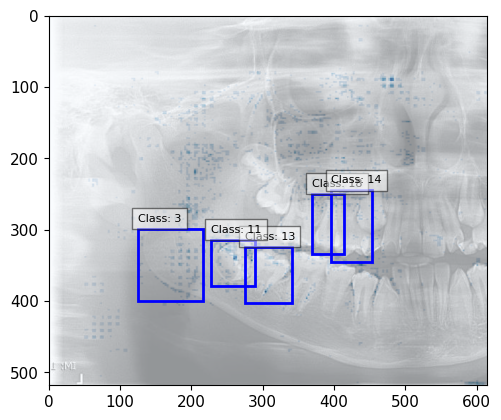

In [ ]:
selected_bboxes_FlipDD100_11Y_M_neg = plot_bboxes_on_image_neg(Image_FlipDD100_11Y_M_path, df_FlipDD100_11Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_FlipDD100_11Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,274.417265,324.009166,341.555418,401.999505,0.920288,13,Lower Second Molar
1,227.129883,314.408799,288.579158,378.256965,0.917766,11,Lower Third Molar
2,368.707432,249.628958,413.236040,333.587674,0.885784,18,Upper Second Premolar
3,124.819978,298.565064,216.762119,399.728633,0.874086,3,Mandibular angle
4,395.941789,244.643631,452.480883,345.231147,0.870887,14,Upper First Premolar


### 12 Year

#### เลือกรูปที่ต้องการหาค่า SHAP Value

In [ ]:
sdf_test

,Age(year),Gender,Folder_type,Folder_name,Path_Name,...,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.423399,7,0.005142,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.415316,7,0.046188,Female,0.0
2,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.492433,7,0.000020,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.343049,7,0.020910,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.095627,7,0.003455,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...
286,22,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.010904,22,0.999999,Male,1.0
287,22,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,21.844440,22,0.999998,Male,1.0
288,23,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.836693,23,0.999958,Male,1.0
289,25,F,Normal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,24.869873,25,1.000000,Male,1.0


In [ ]:
from PIL import Image
Image_O85_12Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/12Y/F/Both/O85.jpg')
Image_O85_12Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/12Y/F/Both/O85.jpg'

Image_O90_12Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/12Y/F/Both/O90.jpg')
Image_O90_12Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/12Y/F/Both/O90.jpg'

Image_FlipO90_12Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/12Y/F/Both/FlipO90.jpg')
Image_FlipO90_12Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/12Y/F/Both/FlipO90.jpg'

Image_OO97_12Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/12Y/M/Both/OO97.jpg')
Image_OO97_12Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/12Y/M/Both/OO97.jpg'

Image_OO103_12Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/12Y/M/Both/OO103.jpg')
Image_OO103_12Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/12Y/M/Both/OO103.jpg'

In [ ]:
sdf_test.reset_index().iloc[138]

index                                                               138
Age(year)                                                            12
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                        O85.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   11.933755
Age_predict_int                                                      12
Gender_predict                                                 0.993815
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[141]

index                                                               141
Age(year)                                                            12
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                        O90.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   11.828089
Age_predict_int                                                      12
Gender_predict                                                 0.000525
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[142] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               142
Age(year)                                                            12
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                    FlipO90.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   11.500506
Age_predict_int                                                      12
Gender_predict                                                  0.00008
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[148] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               148
Age(year)                                                            12
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                       OO97.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                   11.715975
Age_predict_int                                                      12
Gender_predict                                                 0.457828
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[149] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               149
Age(year)                                                            12
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                      OO103.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                   12.323533
Age_predict_int                                                      12
Gender_predict                                                 0.999974
Gender_predict_str                                                 Male
Gender_predict_int                                              

#### YOLO (detect ตห)

In [ ]:
# YOLO detect ตำแหน่ง
#ภาพ1
results_O85_12Y_F = yolo_model(Image_O85_12Y_F) # results = ผลจากการทำนาย
df_O85_12Y_F = results_O85_12Y_F.pandas().xyxyn[0] #.pandas ทำให้เป็น dataframe // .xyxy ตห.กล่อง ///  n normalization ค่าให้มีค่าอยู่ระหว่าง 0-1 //[0]= index
#ภาพ2
results_O90_12Y_F = yolo_model(Image_O90_12Y_F)
df_O90_12Y_F = results_O90_12Y_F.pandas().xyxyn[0]
#ภาพ3
results_FlipO90_12Y_F = yolo_model(Image_FlipO90_12Y_F)
df_FlipO90_12Y_F = results_FlipO90_12Y_F.pandas().xyxyn[0]
#ภาพ4
results_OO97_12Y_M = yolo_model(Image_OO97_12Y_M)
df_OO97_12Y_M = results_OO97_12Y_M.pandas().xyxyn[0]
#ภาพ5
results_OO103_12Y_M = yolo_model(Image_OO103_12Y_M)
df_OO103_12Y_M= results_OO103_12Y_M.pandas().xyxyn[0]

##### NMS

In [ ]:
df_O85_12Y_F_filtered_nms = nms_per_class(df_O85_12Y_F,iou_threshold=0.5)
df_O90_12Y_F_filtered_nms = nms_per_class(df_O90_12Y_F,iou_threshold=0.5)
df_FlipO90_12Y_F_filtered_nms = nms_per_class(df_FlipO90_12Y_F,iou_threshold=0.5)
df_OO97_12Y_M_filtered_nms = nms_per_class(df_OO97_12Y_M,iou_threshold=0.5)
df_OO103_12Y_M_filtered_nms = nms_per_class(df_OO103_12Y_M,iou_threshold=0.5)

#### SHAP values

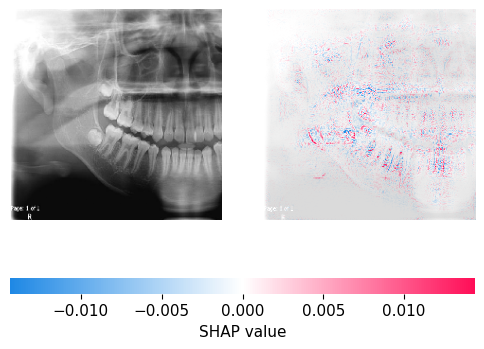

In [ ]:
shap_values_O85_12Y_F = explainer_layer1.shap_values(background_test_array[[138]])
%matplotlib inline
shap.image_plot(shap_values_O85_12Y_F, background_test_array[[138]])

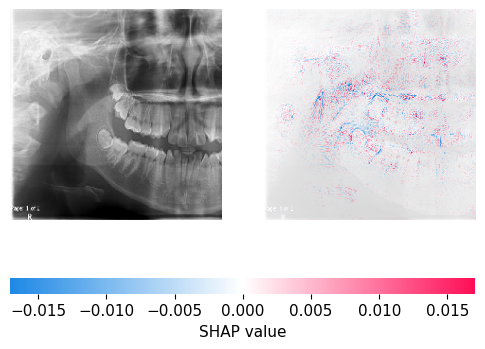

In [ ]:
shap_values_O90_12Y_F = explainer_layer1.shap_values(background_test_array[[141]])
%matplotlib inline
shap.image_plot(shap_values_O90_12Y_F, background_test_array[[141]])

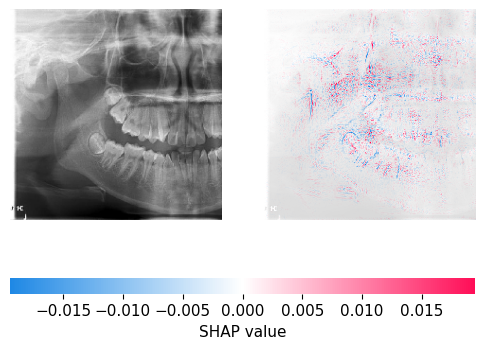

In [ ]:
shap_values_FlipO90_12Y_F = explainer_layer1.shap_values(background_test_array[[142]])
%matplotlib inline
shap.image_plot(shap_values_FlipO90_12Y_F, background_test_array[[142]])

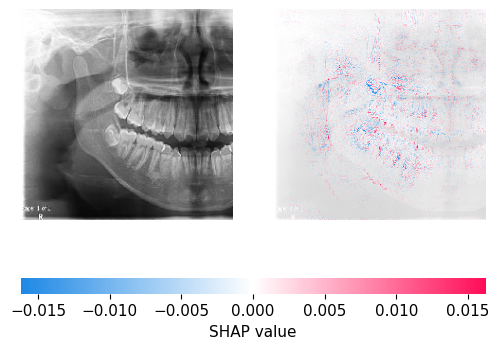

In [ ]:
shap_values_OO97_12Y_M = explainer_layer1.shap_values(background_test_array[[148]])
%matplotlib inline
shap.image_plot(shap_values_OO97_12Y_M, background_test_array[[148]])

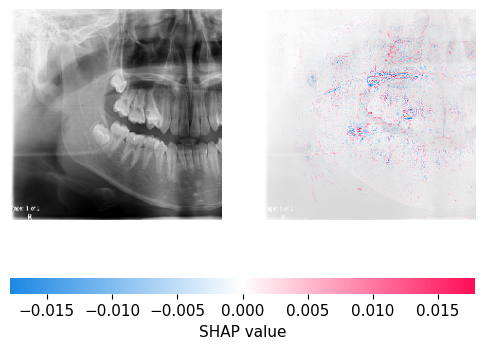

In [ ]:
shap_values_OO103_12Y_M = explainer_layer1.shap_values(background_test_array[[149]])
%matplotlib inline
shap.image_plot(shap_values_OO103_12Y_M, background_test_array[[149]])

#### convert shap value from RGB to grayscale image

In [ ]:
type(shap_values_OO103_12Y_M)

list

#### O85_12Y_F

In [ ]:
#O85_12Y_F
data= [np.array(shap_values_O85_12Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

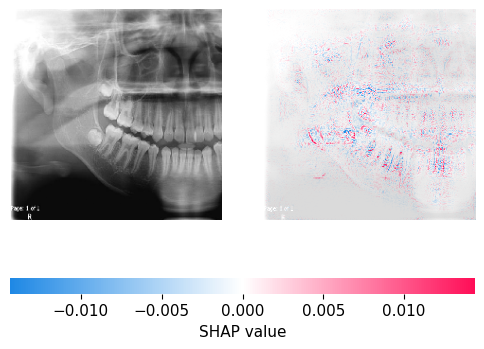

In [ ]:
shap.image_plot(shap_values_O85_12Y_F, background_test_array[[138]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

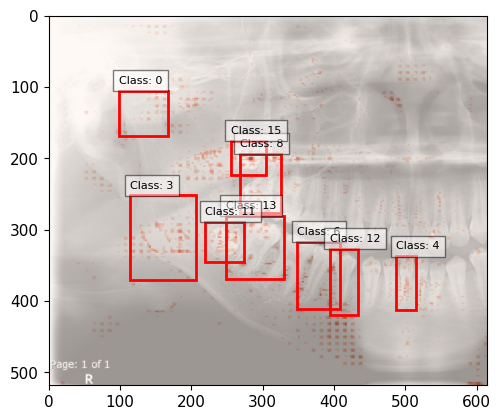

In [ ]:
selected_bboxes_O85_12Y_F_pos = plot_bboxes_on_image_pos(Image_O85_12Y_F_path, df_O85_12Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_O85_12Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,248.224868,280.129262,329.462588,368.419816,0.915451,13,Lower Second Molar
1,267.459176,193.943903,325.301590,277.144618,0.907766,8,Upper Second Molar
2,348.195111,317.022941,407.778694,411.126617,0.896068,6,Lower Second Premolar
3,219.719287,289.240288,273.975335,345.330287,0.893861,11,Lower Third Molar
4,393.694864,327.004308,433.712202,419.079514,0.880300,12,Lower First Premolar
5,486.989274,337.236877,514.645744,412.594795,0.865978,4,Lower Central Incisor
6,114.142958,251.941357,206.756193,370.774359,0.833370,3,Mandibular angle
7,254.988809,175.588192,303.828738,223.124415,0.825772,15,Upper Third Molar
8,98.339716,105.167065,166.795251,168.376145,0.795430,0,Condyle


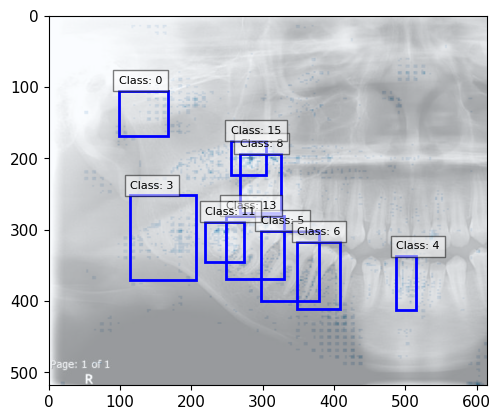

In [ ]:
selected_bboxes_O85_12Y_F_neg = plot_bboxes_on_image_neg(Image_O85_12Y_F_path, df_O85_12Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_O85_12Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,297.018795,301.556531,379.431707,399.221014,0.924209,5,Lower First Molar
1,248.224868,280.129262,329.462588,368.419816,0.915451,13,Lower Second Molar
2,267.459176,193.943903,325.301590,277.144618,0.907766,8,Upper Second Molar
3,348.195111,317.022941,407.778694,411.126617,0.896068,6,Lower Second Premolar
4,219.719287,289.240288,273.975335,345.330287,0.893861,11,Lower Third Molar
5,486.989274,337.236877,514.645744,412.594795,0.865978,4,Lower Central Incisor
6,114.142958,251.941357,206.756193,370.774359,0.833370,3,Mandibular angle
7,254.988809,175.588192,303.828738,223.124415,0.825772,15,Upper Third Molar
8,98.339716,105.167065,166.795251,168.376145,0.795430,0,Condyle


#### O90_12Y_F

In [ ]:
#O90_12Y_F
data= [np.array(shap_values_O90_12Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

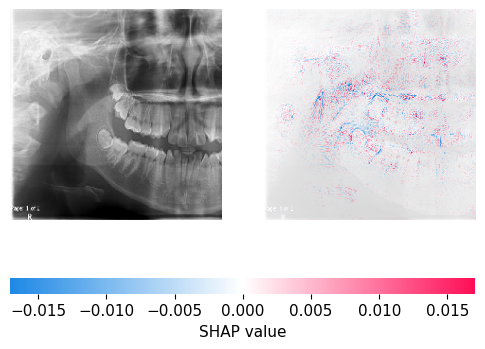

In [ ]:
shap.image_plot(shap_values_O90_12Y_F, background_test_array[[141]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

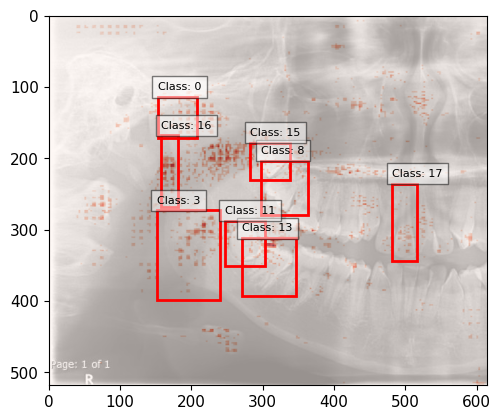

In [ ]:
selected_bboxes_O90_12Y_F_pos = plot_bboxes_on_image_pos(Image_O90_12Y_F_path, df_O90_12Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_O90_12Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,297.888693,203.275950,362.863143,278.676954,0.906270,8,Upper Second Molar
1,271.330049,311.965428,346.636288,393.002439,0.906154,13,Lower Second Molar
2,282.338192,178.168634,337.592668,230.771911,0.897214,15,Upper Third Molar
3,151.642882,273.004685,239.521548,399.150896,0.885285,3,Mandibular angle
4,247.057892,287.671982,303.632211,350.293631,0.877026,11,Lower Third Molar
5,152.602169,114.240161,207.426124,172.026829,0.872287,0,Condyle
6,481.609149,235.855359,516.206983,344.249994,0.856648,17,Upper Central Incisor
7,157.749673,167.703004,181.031527,268.811183,0.784964,16,Posterior border of Ramus


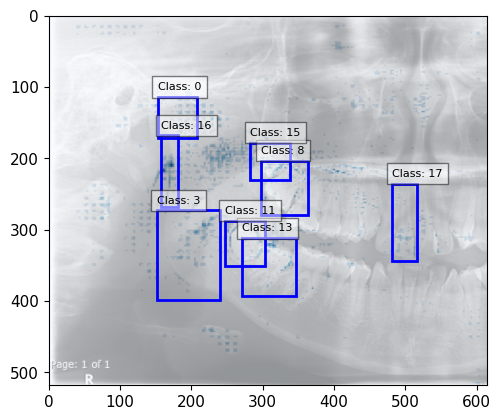

In [ ]:
selected_bboxes_O90_12Y_F_neg = plot_bboxes_on_image_neg(Image_O90_12Y_F_path, df_O90_12Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_O90_12Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,297.888693,203.275950,362.863143,278.676954,0.906270,8,Upper Second Molar
1,271.330049,311.965428,346.636288,393.002439,0.906154,13,Lower Second Molar
2,282.338192,178.168634,337.592668,230.771911,0.897214,15,Upper Third Molar
3,151.642882,273.004685,239.521548,399.150896,0.885285,3,Mandibular angle
4,247.057892,287.671982,303.632211,350.293631,0.877026,11,Lower Third Molar
5,152.602169,114.240161,207.426124,172.026829,0.872287,0,Condyle
6,481.609149,235.855359,516.206983,344.249994,0.856648,17,Upper Central Incisor
7,157.749673,167.703004,181.031527,268.811183,0.784964,16,Posterior border of Ramus


#### FlipO90_12Y_F

In [ ]:
#FlipO90_12Y_F
data= [np.array(shap_values_FlipO90_12Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

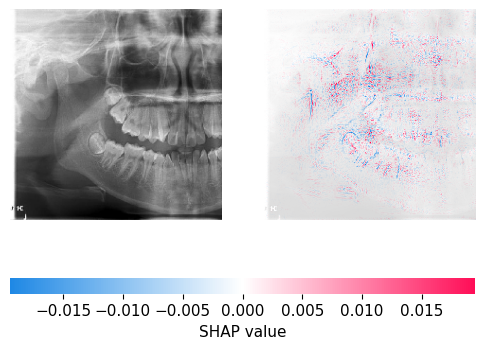

In [ ]:
shap.image_plot(shap_values_FlipO90_12Y_F, background_test_array[[142]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

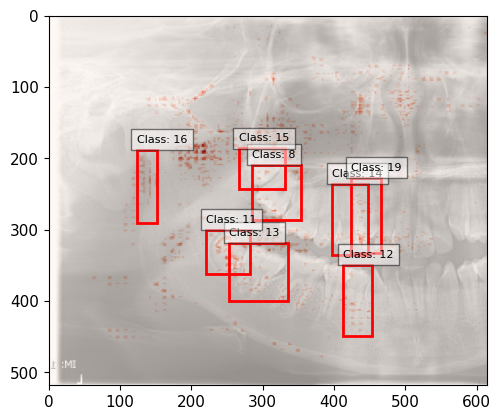

In [ ]:
selected_bboxes_FlipO90_12Y_F_pos = plot_bboxes_on_image_pos(Image_FlipO90_12Y_F_path, df_FlipO90_12Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_FlipO90_12Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,253.053418,318.543329,335.471784,399.644282,0.933540,13,Lower Second Molar
1,221.114155,300.202438,281.680795,362.664338,0.908909,11,Lower Third Molar
2,285.190179,209.323059,353.953359,286.842674,0.896078,8,Upper Second Molar
3,266.276792,185.835426,330.820017,242.885813,0.887473,15,Upper Third Molar
4,397.170834,235.221877,447.355694,335.619047,0.862800,14,Upper First Premolar
5,412.753395,348.914034,452.569595,449.409155,0.788041,12,Lower First Premolar
6,423.799288,227.029928,466.194642,332.438808,0.772314,19,Upper Canine
7,123.478378,188.301027,151.659954,291.244491,0.721533,16,Posterior border of Ramus


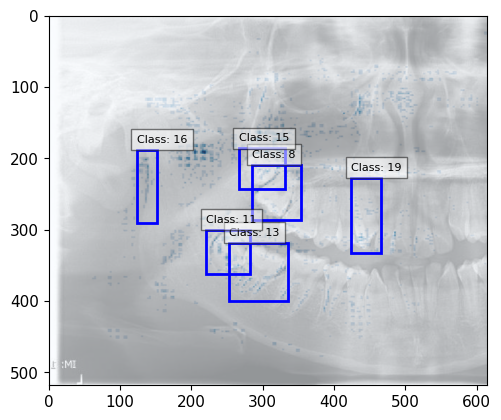

In [ ]:
selected_bboxes_FlipO90_12Y_F_neg = plot_bboxes_on_image_neg(Image_FlipO90_12Y_F_path, df_FlipO90_12Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_FlipO90_12Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,253.053418,318.543329,335.471784,399.644282,0.933540,13,Lower Second Molar
1,221.114155,300.202438,281.680795,362.664338,0.908909,11,Lower Third Molar
2,285.190179,209.323059,353.953359,286.842674,0.896078,8,Upper Second Molar
3,266.276792,185.835426,330.820017,242.885813,0.887473,15,Upper Third Molar
4,423.799288,227.029928,466.194642,332.438808,0.772314,19,Upper Canine
5,123.478378,188.301027,151.659954,291.244491,0.721533,16,Posterior border of Ramus


#### OO97_12Y_M

In [ ]:
#OO97_12Y_M
data= [np.array(shap_values_OO97_12Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

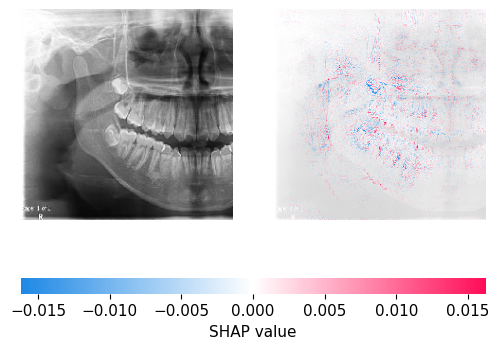

In [ ]:
shap.image_plot(shap_values_OO97_12Y_M, background_test_array[[148]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

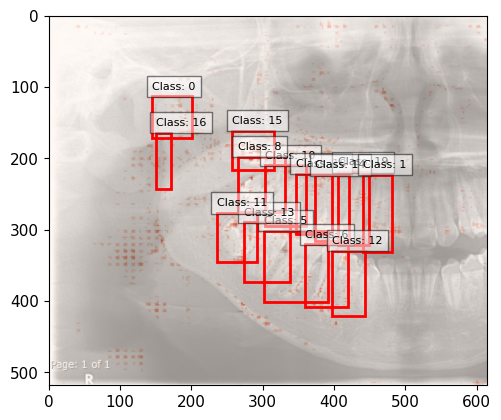

In [ ]:
selected_bboxes_OO97_12Y_M_pos = plot_bboxes_on_image_pos(Image_OO97_12Y_M_path, df_OO97_12Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_OO97_12Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,301.664340,301.740980,391.240579,401.496887,0.925717,5,Lower First Molar
1,273.249209,289.726388,337.778142,373.738811,0.924551,13,Lower Second Molar
2,303.531550,209.745247,360.916133,294.976902,0.919928,10,Upper First Molar
3,235.612046,276.802335,292.378849,345.349707,0.903671,11,Lower Third Molar
4,265.029759,197.578270,331.180353,275.840480,0.902030,8,Upper Second Molar
5,359.430138,320.487324,419.315429,408.356586,0.891267,6,Lower Second Premolar
6,346.359100,221.710316,396.909933,306.197291,0.886722,18,Upper Second Premolar
7,257.165687,161.472171,316.235390,215.719167,0.885025,15,Upper Third Molar
8,404.959791,219.472326,449.347536,321.663577,0.880413,19,Upper Canine
9,145.241272,113.266264,201.484871,171.165195,0.869047,0,Condyle


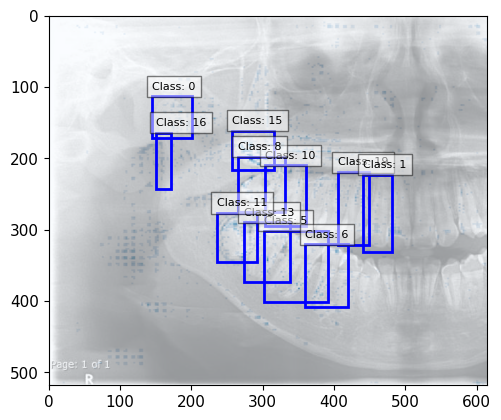

In [ ]:
selected_bboxes_OO97_12Y_M_neg = plot_bboxes_on_image_neg(Image_OO97_12Y_M_path, df_OO97_12Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_OO97_12Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,301.664340,301.740980,391.240579,401.496887,0.925717,5,Lower First Molar
1,273.249209,289.726388,337.778142,373.738811,0.924551,13,Lower Second Molar
2,303.531550,209.745247,360.916133,294.976902,0.919928,10,Upper First Molar
3,235.612046,276.802335,292.378849,345.349707,0.903671,11,Lower Third Molar
4,265.029759,197.578270,331.180353,275.840480,0.902030,8,Upper Second Molar
5,359.430138,320.487324,419.315429,408.356586,0.891267,6,Lower Second Premolar
6,257.165687,161.472171,316.235390,215.719167,0.885025,15,Upper Third Molar
7,404.959791,219.472326,449.347536,321.663577,0.880413,19,Upper Canine
8,145.241272,113.266264,201.484871,171.165195,0.869047,0,Condyle
9,150.001129,164.211466,171.326613,243.039464,0.803454,16,Posterior border of Ramus


#### OO103_12Y_M

In [ ]:
#OO103_12Y_M
data= [np.array(shap_values_OO103_12Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

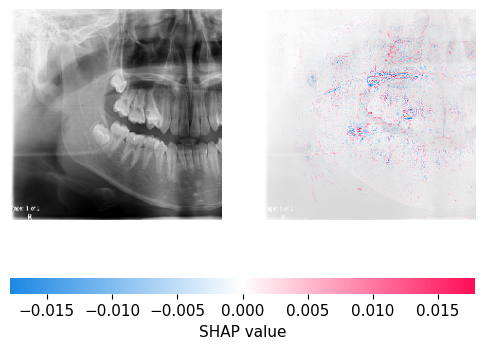

In [ ]:
shap.image_plot(shap_values_OO103_12Y_M, background_test_array[[149]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

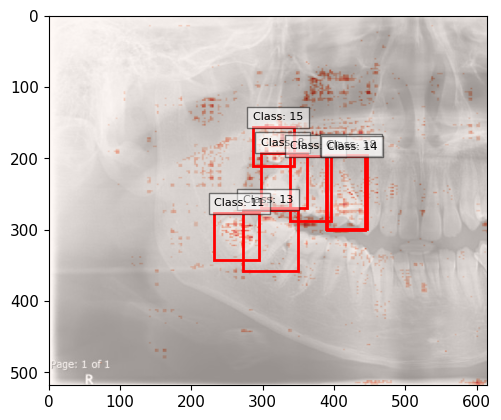

In [ ]:
selected_bboxes_OO103_12Y_M_pos = plot_bboxes_on_image_pos(Image_OO103_12Y_M_path, df_OO103_12Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_OO103_12Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,296.850777,191.953348,362.425147,270.049557,0.907974,8,Upper Second Molar
1,272.161923,272.007014,349.280769,358.389480,0.903866,13,Lower Second Molar
2,231.963227,276.836699,294.322822,341.780441,0.902665,11,Lower Third Molar
3,285.904228,156.337779,343.364310,211.197817,0.875243,15,Upper Third Molar
4,338.796022,196.805649,396.193395,288.438521,0.755059,10,Upper First Molar
5,388.306102,195.508242,445.612750,299.404746,0.692869,18,Upper Second Premolar
6,389.454816,197.341967,443.556168,300.512208,0.532832,14,Upper First Premolar


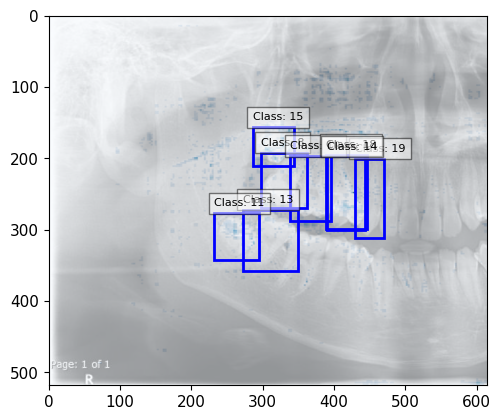

In [ ]:
selected_bboxes_OO103_12Y_M_neg = plot_bboxes_on_image_neg(Image_OO103_12Y_M_path, df_OO103_12Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_OO103_12Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,296.850777,191.953348,362.425147,270.049557,0.907974,8,Upper Second Molar
1,272.161923,272.007014,349.280769,358.389480,0.903866,13,Lower Second Molar
2,231.963227,276.836699,294.322822,341.780441,0.902665,11,Lower Third Molar
3,428.817686,200.316963,469.840826,311.509031,0.885666,19,Upper Canine
4,285.904228,156.337779,343.364310,211.197817,0.875243,15,Upper Third Molar
5,338.796022,196.805649,396.193395,288.438521,0.755059,10,Upper First Molar
6,388.306102,195.508242,445.612750,299.404746,0.692869,18,Upper Second Premolar
7,389.454816,197.341967,443.556168,300.512208,0.532832,14,Upper First Premolar


### 13 Year

#### เลือกรูปที่ต้องการหาค่า SHAP Value

In [ ]:
sdf_test

,Age(year),Gender,Folder_type,Folder_name,Path_Name,...,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.423399,7,0.005142,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.415316,7,0.046188,Female,0.0
2,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.492433,7,0.000020,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.343049,7,0.020910,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.095627,7,0.003455,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...
286,22,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.010904,22,0.999999,Male,1.0
287,22,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,21.844440,22,0.999998,Male,1.0
288,23,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.836693,23,0.999958,Male,1.0
289,25,F,Normal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,24.869873,25,1.000000,Male,1.0


In [ ]:
from PIL import Image
Image_G84_13Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/13Y/F/Both/G84.jpg')
Image_G84_13Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/13Y/F/Both/G84.jpg'

Image_G111_13Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/13Y/F/Both/G111.jpg')
Image_G111_13Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/13Y/F/Both/G111.jpg'

Image_FlipG111_13Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/13Y/F/Both/FlipG111.jpg')
Image_FlipG111_13Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/13Y/F/Both/FlipG111.jpg'

Image_GG117_13Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/13Y/M/Both/GG117.jpg')
Image_GG117_13Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/13Y/M/Both/GG117.jpg'

Image_FlipGG120_13Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/13Y/M/Both/FlipGG120.jpg')
Image_FlipGG120_13Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/13Y/M/Both/FlipGG120.jpg'

In [ ]:
sdf_test.reset_index().iloc[158]

index                                                               158
Age(year)                                                            13
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                        G84.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   12.874559
Age_predict_int                                                      13
Gender_predict                                                 0.000021
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[160]

index                                                               160
Age(year)                                                            13
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                       G111.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   13.081745
Age_predict_int                                                      13
Gender_predict                                                 0.789125
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[161] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               161
Age(year)                                                            13
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                   FlipG111.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   13.118301
Age_predict_int                                                      13
Gender_predict                                                  0.18678
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[167] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               167
Age(year)                                                            13
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                      GG117.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                   13.034389
Age_predict_int                                                      13
Gender_predict                                                 0.999254
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[168] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               168
Age(year)                                                            13
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                  FlipGG120.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                   12.576123
Age_predict_int                                                      13
Gender_predict                                                 0.999238
Gender_predict_str                                                 Male
Gender_predict_int                                              

#### YOLO (detect ตห)

In [ ]:
# YOLO detect ตำแหน่ง
#ภาพ1
results_G84_13Y_F = yolo_model(Image_G84_13Y_F) # results = ผลจากการทำนาย
df_G84_13Y_F = results_G84_13Y_F.pandas().xyxyn[0] #.pandas ทำให้เป็น dataframe // .xyxy ตห.กล่อง ///  n normalization ค่าให้มีค่าอยู่ระหว่าง 0-1 //[0]= index
#ภาพ2
results_G111_13Y_F = yolo_model(Image_G111_13Y_F)
df_G111_13Y_F = results_G111_13Y_F.pandas().xyxyn[0]
#ภาพ3
results_FlipG111_13Y_F = yolo_model(Image_FlipG111_13Y_F)
df_FlipG111_13Y_F = results_FlipG111_13Y_F.pandas().xyxyn[0]
#ภาพ4
results_GG117_13Y_M = yolo_model(Image_GG117_13Y_M)
df_GG117_13Y_M = results_GG117_13Y_M.pandas().xyxyn[0]
#ภาพ5
results_FlipGG120_13Y_M = yolo_model(Image_FlipGG120_13Y_M)
df_FlipGG120_13Y_M= results_FlipGG120_13Y_M.pandas().xyxyn[0]

##### NMS

In [ ]:
df_G84_13Y_F_filtered_nms = nms_per_class(df_G84_13Y_F,iou_threshold=0.5)
df_G111_13Y_F_filtered_nms = nms_per_class(df_G111_13Y_F,iou_threshold=0.5)
df_FlipG111_13Y_F_filtered_nms = nms_per_class(df_FlipG111_13Y_F,iou_threshold=0.5)
df_GG117_13Y_M_filtered_nms = nms_per_class(df_GG117_13Y_M,iou_threshold=0.5)
df_FlipGG120_13Y_M_filtered_nms = nms_per_class(df_FlipGG120_13Y_M,iou_threshold=0.5)

#### SHAP values

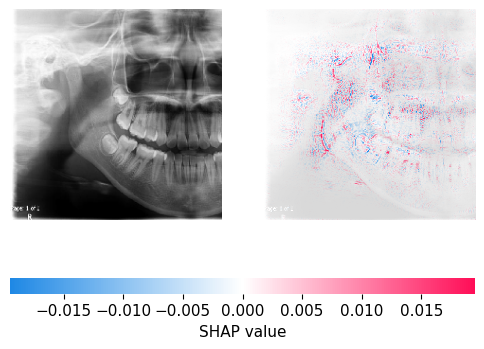

In [ ]:
shap_values_G84_13Y_F = explainer_layer1.shap_values(background_test_array[[158]])
%matplotlib inline
shap.image_plot(shap_values_G84_13Y_F, background_test_array[[158]])

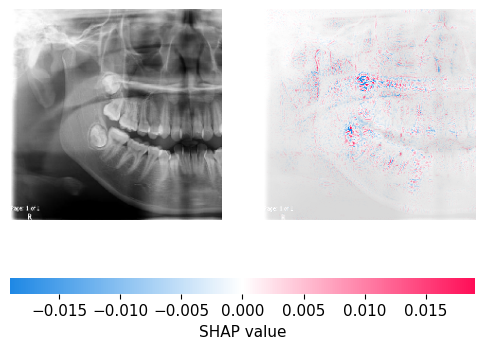

In [ ]:
shap_values_G111_13Y_F = explainer_layer1.shap_values(background_test_array[[160]])
%matplotlib inline
shap.image_plot(shap_values_G111_13Y_F, background_test_array[[160]])

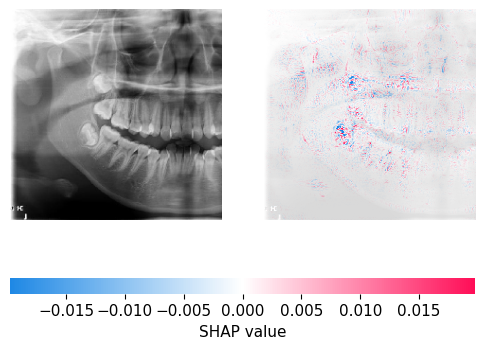

In [ ]:
shap_values_FlipG111_13Y_F = explainer_layer1.shap_values(background_test_array[[161]])
%matplotlib inline
shap.image_plot(shap_values_FlipG111_13Y_F, background_test_array[[161]])

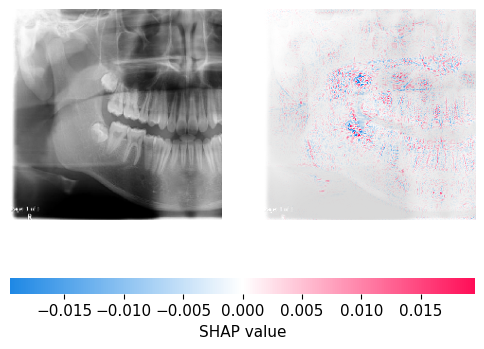

In [ ]:
shap_values_GG117_13Y_M = explainer_layer1.shap_values(background_test_array[[167]])
%matplotlib inline
shap.image_plot(shap_values_GG117_13Y_M, background_test_array[[167]])

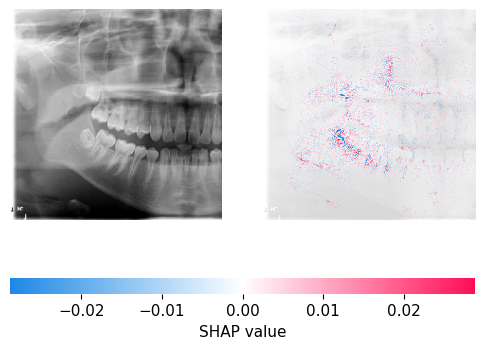

In [ ]:
shap_values_FlipGG120_13Y_M = explainer_layer1.shap_values(background_test_array[[168]])
%matplotlib inline
shap.image_plot(shap_values_FlipGG120_13Y_M, background_test_array[[168]])

#### convert shap value from RGB to grayscale image

In [ ]:
type(shap_values_FlipGG120_13Y_M)

list

#### G84_13Y_F

In [ ]:
#G84_13Y_F
data= [np.array(shap_values_G84_13Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

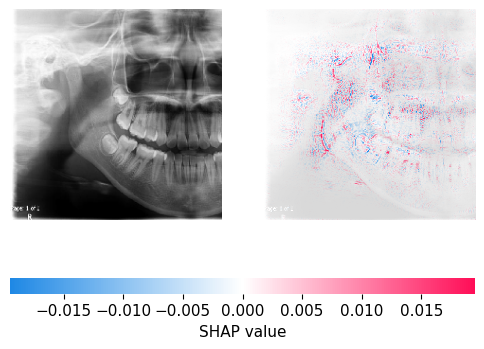

In [ ]:
shap.image_plot(shap_values_G84_13Y_F, background_test_array[[158]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

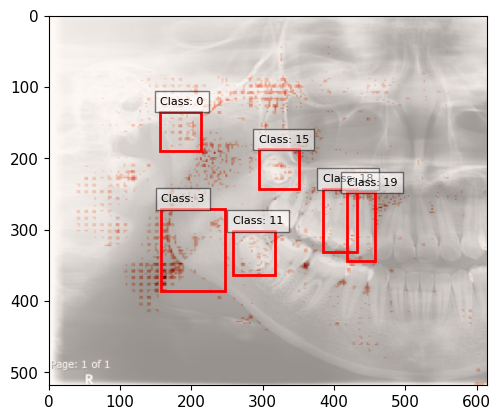

In [ ]:
selected_bboxes_G84_13Y_F_pos = plot_bboxes_on_image_pos(Image_G84_13Y_F_path, df_G84_13Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_G84_13Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,258.109402,301.952629,317.371112,363.813266,0.907485,11,Lower Third Molar
1,156.598031,134.706193,213.861000,190.056962,0.877165,0,Condyle
2,294.099084,187.365817,350.782830,242.891525,0.874137,15,Upper Third Molar
3,157.702554,271.165757,247.534736,385.804965,0.871465,3,Mandibular angle
4,383.713037,243.043971,431.726911,330.860869,0.865045,18,Upper Second Premolar
5,417.570801,247.725301,457.914404,343.412412,0.825382,19,Upper Canine


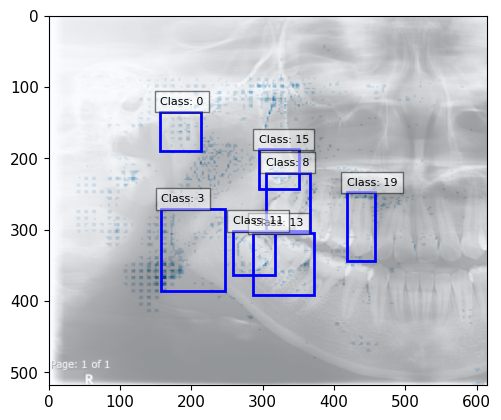

In [ ]:
selected_bboxes_G84_13Y_F_neg = plot_bboxes_on_image_neg(Image_G84_13Y_F_path, df_G84_13Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_G84_13Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,286.959784,304.986273,372.316470,391.195035,0.924135,13,Lower Second Molar
1,258.109402,301.952629,317.371112,363.813266,0.907485,11,Lower Third Molar
2,304.309169,220.543958,366.579521,302.398498,0.896281,8,Upper Second Molar
3,156.598031,134.706193,213.861000,190.056962,0.877165,0,Condyle
4,294.099084,187.365817,350.782830,242.891525,0.874137,15,Upper Third Molar
5,157.702554,271.165757,247.534736,385.804965,0.871465,3,Mandibular angle
6,417.570801,247.725301,457.914404,343.412412,0.825382,19,Upper Canine


#### G111_13Y_F

In [ ]:
#G111_13Y_F
data= [np.array(shap_values_G111_13Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

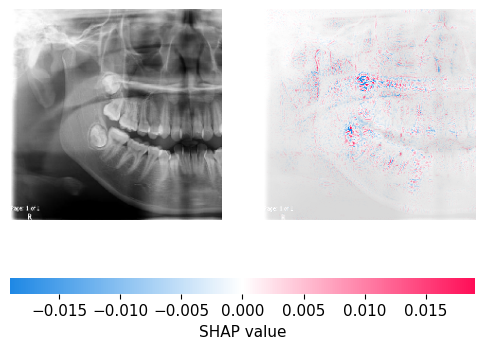

In [ ]:
shap.image_plot(shap_values_G111_13Y_F, background_test_array[[160]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

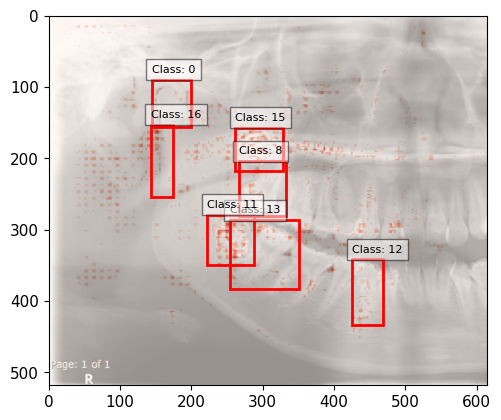

In [ ]:
selected_bboxes_G111_13Y_F_pos = plot_bboxes_on_image_pos(Image_G111_13Y_F_path, df_G111_13Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_G111_13Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,253.585433,286.650044,350.889108,382.705125,0.926858,13,Lower Second Molar
1,222.068758,279.381001,287.109613,349.216117,0.911521,11,Lower Third Molar
2,266.226251,204.107867,333.219589,280.585752,0.910667,8,Upper Second Molar
3,261.712182,156.796353,328.893903,217.102855,0.896568,15,Upper Third Molar
4,144.731234,90.191710,199.231981,155.836489,0.883607,0,Condyle
5,425.586478,341.649221,468.097955,433.704327,0.829551,12,Lower First Premolar
6,143.142163,153.033422,174.101965,254.187883,0.783269,16,Posterior border of Ramus


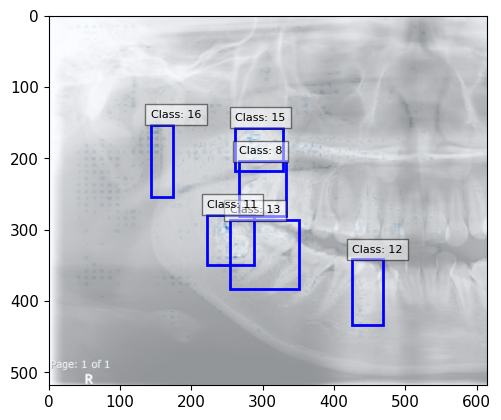

In [ ]:
selected_bboxes_G111_13Y_F_neg = plot_bboxes_on_image_neg(Image_G111_13Y_F_path, df_G111_13Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_G111_13Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,253.585433,286.650044,350.889108,382.705125,0.926858,13,Lower Second Molar
1,222.068758,279.381001,287.109613,349.216117,0.911521,11,Lower Third Molar
2,266.226251,204.107867,333.219589,280.585752,0.910667,8,Upper Second Molar
3,261.712182,156.796353,328.893903,217.102855,0.896568,15,Upper Third Molar
4,425.586478,341.649221,468.097955,433.704327,0.829551,12,Lower First Premolar
5,143.142163,153.033422,174.101965,254.187883,0.783269,16,Posterior border of Ramus


#### FlipG111_13Y_F

In [ ]:
#FlipG111_13Y_F
data= [np.array(shap_values_FlipG111_13Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

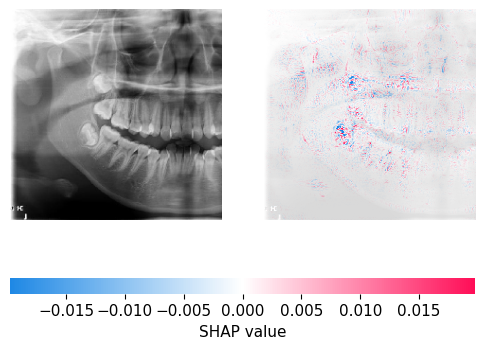

In [ ]:
shap.image_plot(shap_values_FlipG111_13Y_F, background_test_array[[161]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

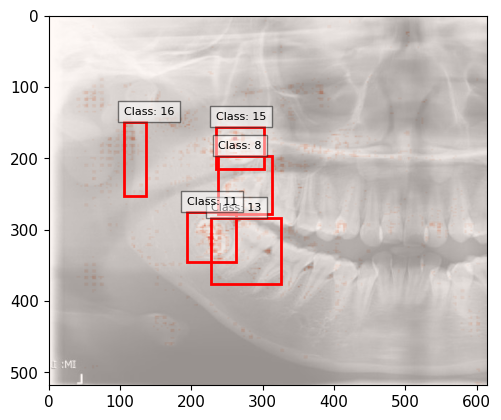

In [ ]:
selected_bboxes_FlipG111_13Y_F_pos = plot_bboxes_on_image_pos(Image_FlipG111_13Y_F_path, df_FlipG111_13Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_FlipG111_13Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,237.781641,196.649096,312.538372,278.349183,0.935171,8,Upper Second Molar
1,227.984557,282.986083,326.168579,376.087148,0.917623,13,Lower Second Molar
2,193.760893,274.769913,262.850740,345.863533,0.909176,11,Lower Third Molar
3,234.200692,156.002335,302.155823,214.950066,0.878124,15,Upper Third Molar
4,105.439546,149.007804,136.400327,252.192480,0.741355,16,Posterior border of Ramus


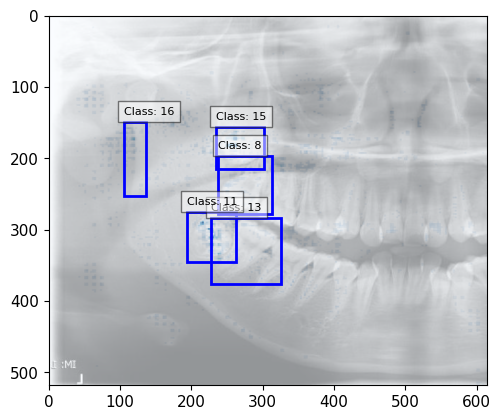

In [ ]:
selected_bboxes_FlipG111_13Y_F_neg = plot_bboxes_on_image_neg(Image_FlipG111_13Y_F_path, df_FlipG111_13Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_FlipG111_13Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,237.781641,196.649096,312.538372,278.349183,0.935171,8,Upper Second Molar
1,227.984557,282.986083,326.168579,376.087148,0.917623,13,Lower Second Molar
2,193.760893,274.769913,262.850740,345.863533,0.909176,11,Lower Third Molar
3,234.200692,156.002335,302.155823,214.950066,0.878124,15,Upper Third Molar
4,105.439546,149.007804,136.400327,252.192480,0.741355,16,Posterior border of Ramus


#### GG117_13Y_M

In [ ]:
#GG117_13Y_M
data= [np.array(shap_values_GG117_13Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

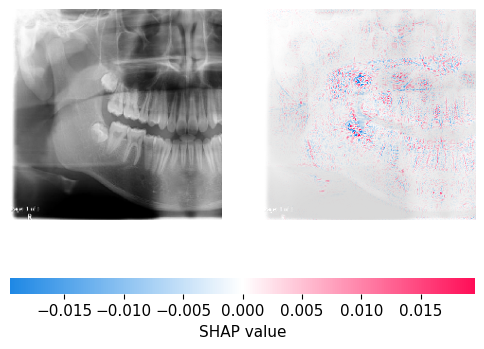

In [ ]:
shap.image_plot(shap_values_GG117_13Y_M, background_test_array[[167]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

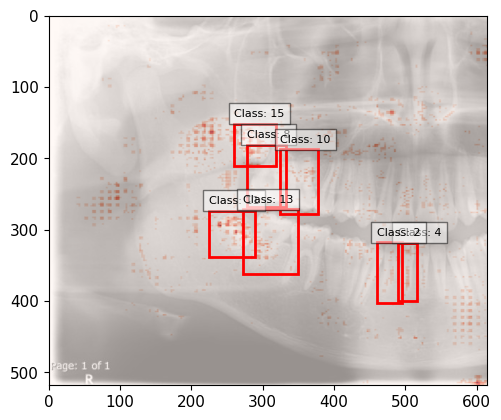

In [ ]:
selected_bboxes_GG117_13Y_M_pos = plot_bboxes_on_image_pos(Image_GG117_13Y_M_path, df_GG117_13Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_GG117_13Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,277.477418,180.978401,332.856288,268.793307,0.922747,8,Upper Second Molar
1,324.598850,187.521953,377.529346,277.896707,0.918990,10,Upper First Molar
2,224.466646,273.471827,289.159462,338.890367,0.914197,11,Lower Third Molar
3,271.885230,271.638889,348.989711,361.819932,0.910254,13,Lower Second Molar
4,260.243625,151.719327,317.834104,210.278060,0.896705,15,Upper Third Molar
5,489.083625,317.902112,516.403913,400.144769,0.831297,4,Lower Central Incisor
6,459.397874,317.719671,494.794736,402.223566,0.739845,2,Lower Lateral Incisor


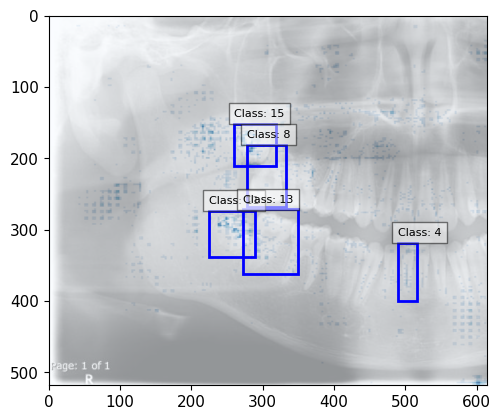

In [ ]:
selected_bboxes_GG117_13Y_M_neg = plot_bboxes_on_image_neg(Image_GG117_13Y_M_path, df_GG117_13Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_GG117_13Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,277.477418,180.978401,332.856288,268.793307,0.922747,8,Upper Second Molar
1,224.466646,273.471827,289.159462,338.890367,0.914197,11,Lower Third Molar
2,271.885230,271.638889,348.989711,361.819932,0.910254,13,Lower Second Molar
3,260.243625,151.719327,317.834104,210.278060,0.896705,15,Upper Third Molar
4,489.083625,317.902112,516.403913,400.144769,0.831297,4,Lower Central Incisor


#### FlipGG120_13Y_M

In [ ]:
#FlipGG120_13Y_M
data= [np.array(shap_values_FlipGG120_13Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

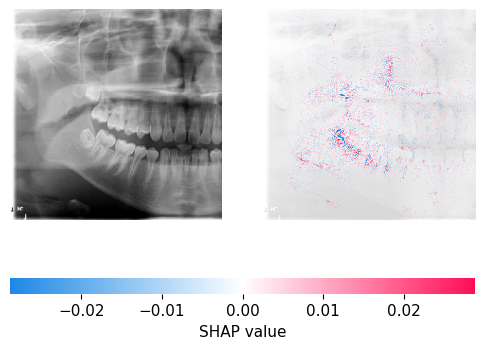

In [ ]:
shap.image_plot(shap_values_FlipGG120_13Y_M, background_test_array[[168]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

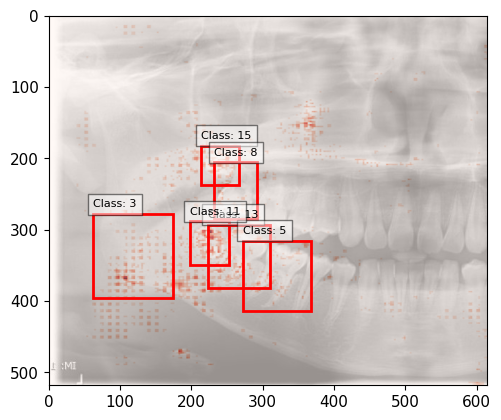

In [ ]:
selected_bboxes_FlipGG120_13Y_M_pos = plot_bboxes_on_image_pos(Image_FlipGG120_13Y_M_path, df_FlipGG120_13Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_FlipGG120_13Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,223.258388,293.120036,309.985567,381.391478,0.938943,13,Lower Second Molar
1,271.846931,315.196518,367.004122,413.449482,0.931111,5,Lower First Molar
2,197.450225,288.205629,253.158526,348.728227,0.902910,11,Lower Third Molar
3,213.569302,182.360360,267.211120,236.709522,0.878272,15,Upper Third Molar
4,232.204915,205.697137,292.399362,285.111254,0.860703,8,Upper Second Molar
5,62.470571,278.324328,174.373792,396.086254,0.849122,3,Mandibular angle


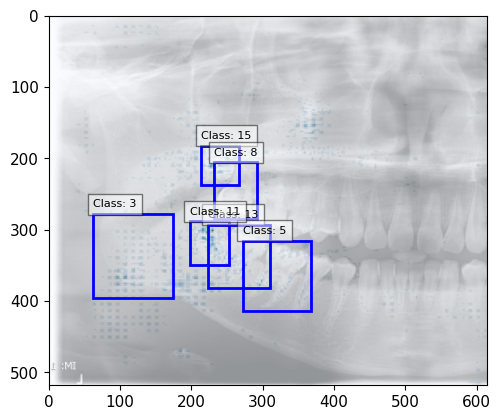

In [ ]:
selected_bboxes_FlipGG120_13Y_M_neg = plot_bboxes_on_image_neg(Image_FlipGG120_13Y_M_path, df_FlipGG120_13Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_FlipGG120_13Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,223.258388,293.120036,309.985567,381.391478,0.938943,13,Lower Second Molar
1,271.846931,315.196518,367.004122,413.449482,0.931111,5,Lower First Molar
2,197.450225,288.205629,253.158526,348.728227,0.902910,11,Lower Third Molar
3,213.569302,182.360360,267.211120,236.709522,0.878272,15,Upper Third Molar
4,232.204915,205.697137,292.399362,285.111254,0.860703,8,Upper Second Molar
5,62.470571,278.324328,174.373792,396.086254,0.849122,3,Mandibular angle


### 14 Year

#### เลือกรูปที่ต้องการหาค่า SHAP Value

In [ ]:
sdf_test

,Age(year),Gender,Folder_type,Folder_name,Path_Name,...,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.423399,7,0.005142,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.415316,7,0.046188,Female,0.0
2,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.492433,7,0.000020,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.343049,7,0.020910,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.095627,7,0.003455,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...
286,22,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.010904,22,0.999999,Male,1.0
287,22,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,21.844440,22,0.999998,Male,1.0
288,23,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.836693,23,0.999958,Male,1.0
289,25,F,Normal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,24.869873,25,1.000000,Male,1.0


In [ ]:
from PIL import Image
Image_Y96_14Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/14Y/F/Both/Y96.jpg')
Image_Y96_14Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/14Y/F/Both/Y96.jpg'

Image_FlipY96_14Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/14Y/F/Both/FlipY96.jpg')
Image_FlipY96_14Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/14Y/F/Both/FlipY96.jpg'

Image_Y98_14Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/14Y/F/Both/Y98.jpg')
Image_Y98_14Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/14Y/F/Both/Y98.jpg'

Image_Y236_14Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/14Y/M/Both/Y236.jpg')
Image_Y236_14Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/14Y/M/Both/Y236.jpg'

Image_Y278_14Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/14Y/M/Both/Y278.jpg')
Image_Y278_14Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/14Y/M/Both/Y278.jpg'

In [ ]:
sdf_test.reset_index().iloc[182]

index                                                               182
Age(year)                                                            14
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                        Y96.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   13.595289
Age_predict_int                                                      14
Gender_predict                                                 0.000004
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[183]

index                                                               183
Age(year)                                                            14
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                    FlipY96.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   13.565476
Age_predict_int                                                      14
Gender_predict                                                 0.000002
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[184] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               184
Age(year)                                                            14
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                        Y98.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   14.057829
Age_predict_int                                                      14
Gender_predict                                                 0.000036
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[192] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               192
Age(year)                                                            14
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                       Y236.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                    13.91926
Age_predict_int                                                      14
Gender_predict                                                 0.996221
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[193] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               193
Age(year)                                                            14
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                       Y278.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                   14.458672
Age_predict_int                                                      14
Gender_predict                                                 0.956216
Gender_predict_str                                                 Male
Gender_predict_int                                              

#### YOLO (detect ตห)

In [ ]:
# YOLO detect ตำแหน่ง
#ภาพ1
results_Y96_14Y_F = yolo_model(Image_Y96_14Y_F) # results = ผลจากการทำนาย
df_Y96_14Y_F = results_Y96_14Y_F.pandas().xyxyn[0] #.pandas ทำให้เป็น dataframe // .xyxy ตห.กล่อง ///  n normalization ค่าให้มีค่าอยู่ระหว่าง 0-1 //[0]= index
#ภาพ2
results_FlipY96_14Y_F = yolo_model(Image_FlipY96_14Y_F)
df_FlipY96_14Y_F = results_FlipY96_14Y_F.pandas().xyxyn[0]
#ภาพ3
results_Y98_14Y_F = yolo_model(Image_Y98_14Y_F)
df_Y98_14Y_F = results_Y98_14Y_F.pandas().xyxyn[0]
#ภาพ4
results_Y236_14Y_M= yolo_model(Image_Y236_14Y_M)
df_Y236_14Y_M= results_Y236_14Y_M.pandas().xyxyn[0]
#ภาพ5
results_Y278_14Y_M = yolo_model(Image_Y278_14Y_M)
df_Y278_14Y_M= results_Y278_14Y_M.pandas().xyxyn[0]

##### NMS

In [ ]:
df_Y96_14Y_F_filtered_nms = nms_per_class(df_Y96_14Y_F,iou_threshold=0.5)
df_FlipY96_14Y_F_filtered_nms = nms_per_class(df_FlipY96_14Y_F,iou_threshold=0.5)
df_Y98_14Y_F_filtered_nms = nms_per_class(df_Y98_14Y_F,iou_threshold=0.5)
df_Y236_14Y_M_filtered_nms = nms_per_class(df_Y236_14Y_M,iou_threshold=0.5)
df_Y278_14Y_M_filtered_nms = nms_per_class(df_Y278_14Y_M,iou_threshold=0.5)

#### SHAP values

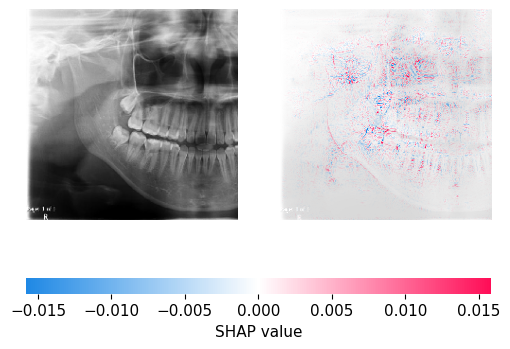

In [ ]:
shap_values_Y96_14Y_F = explainer_layer1.shap_values(background_test_array[[182]])
%matplotlib inline
shap.image_plot(shap_values_Y96_14Y_F, background_test_array[[182]])

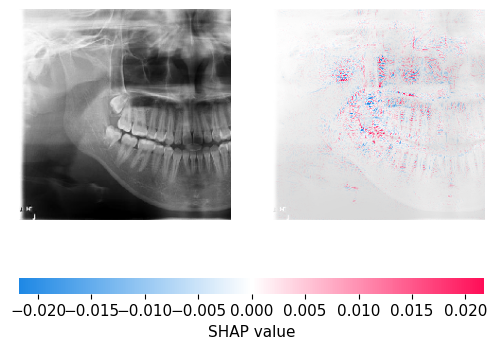

In [ ]:
shap_values_FlipY96_14Y_F = explainer_layer1.shap_values(background_test_array[[183]])
%matplotlib inline
shap.image_plot(shap_values_FlipY96_14Y_F, background_test_array[[183]])

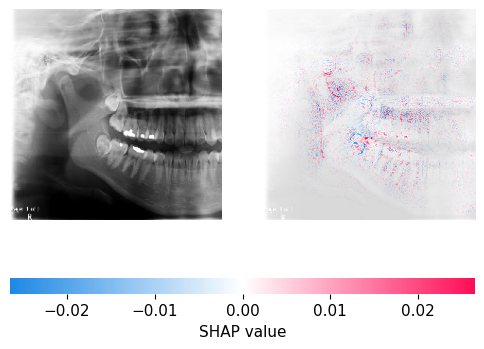

In [ ]:
shap_values_Y98_14Y_F = explainer_layer1.shap_values(background_test_array[[184]])
%matplotlib inline
shap.image_plot(shap_values_Y98_14Y_F, background_test_array[[184]])

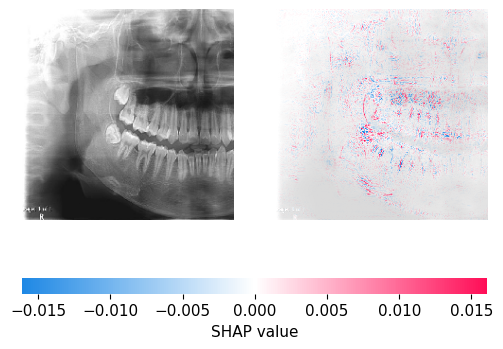

In [ ]:
shap_values_Y236_14Y_M= explainer_layer1.shap_values(background_test_array[[192]])
%matplotlib inline
shap.image_plot(shap_values_Y236_14Y_M, background_test_array[[192]])

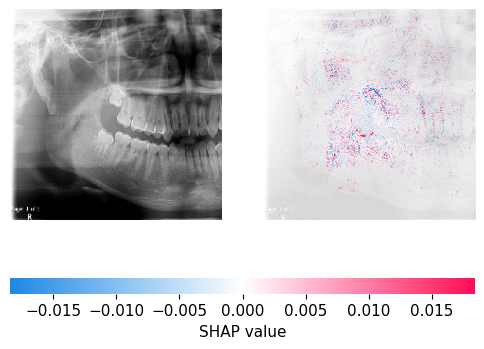

In [ ]:
shap_values_Y278_14Y_M = explainer_layer1.shap_values(background_test_array[[193]])
%matplotlib inline
shap.image_plot(shap_values_Y278_14Y_M, background_test_array[[193]])

#### convert shap value from RGB to grayscale image

In [ ]:
type(shap_values_Y278_14Y_M)

list

#### Y96_14Y_F

In [ ]:
#Y96_14Y_F
data= [np.array(shap_values_Y96_14Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

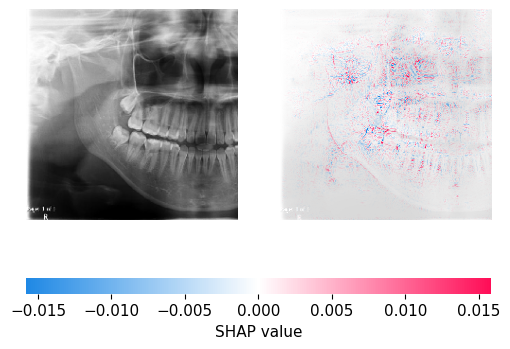

In [ ]:
shap.image_plot(shap_values_Y96_14Y_F, background_test_array[[182]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

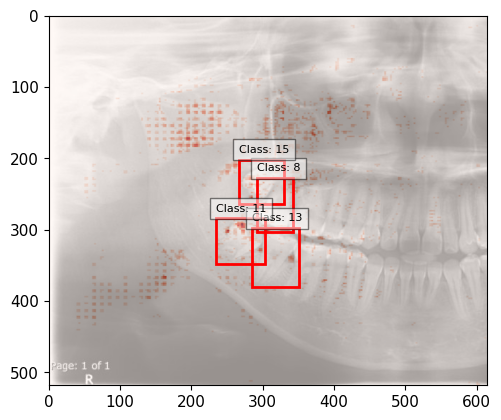

In [ ]:
selected_bboxes_Y96_14Y_F_pos = plot_bboxes_on_image_pos(Image_Y96_14Y_F_path, df_Y96_14Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_Y96_14Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,284.679025,297.926533,350.928230,379.765373,0.922662,13,Lower Second Molar
1,291.742953,227.888012,342.418930,303.032027,0.913537,8,Upper Second Molar
2,234.392626,284.243692,303.275168,348.619423,0.906770,11,Lower Third Molar
3,266.444206,202.098014,330.304581,263.548597,0.905799,15,Upper Third Molar


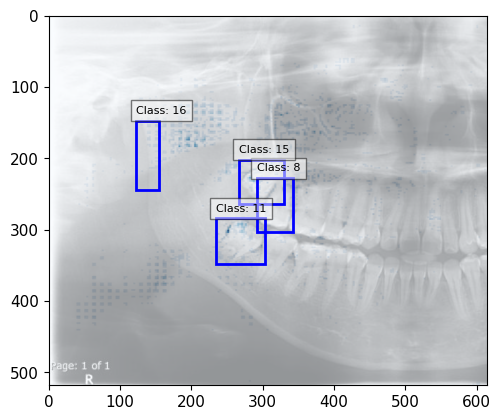

In [ ]:
selected_bboxes_Y96_14Y_F_neg = plot_bboxes_on_image_neg(Image_Y96_14Y_F_path, df_Y96_14Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_Y96_14Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,291.742953,227.888012,342.418930,303.032027,0.913537,8,Upper Second Molar
1,234.392626,284.243692,303.275168,348.619423,0.906770,11,Lower Third Molar
2,266.444206,202.098014,330.304581,263.548597,0.905799,15,Upper Third Molar
3,122.746213,147.490952,155.110206,243.942301,0.698900,16,Posterior border of Ramus


#### FlipY96_14Y_F

In [ ]:
#FlipY96_14Y_F
data= [np.array(shap_values_FlipY96_14Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

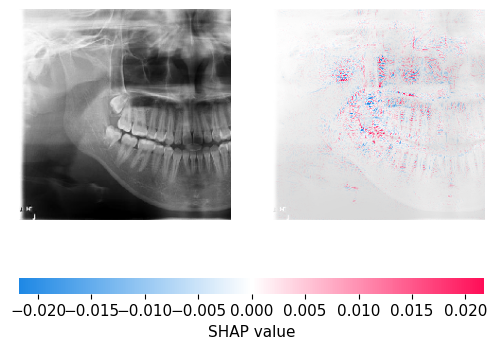

In [ ]:
shap.image_plot(shap_values_FlipY96_14Y_F, background_test_array[[183]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

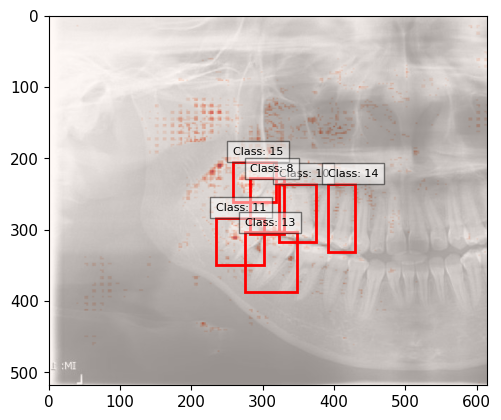

In [ ]:
selected_bboxes_FlipY96_14Y_F_pos = plot_bboxes_on_image_pos(Image_FlipY96_14Y_F_path, df_FlipY96_14Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_FlipY96_14Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,322.082533,235.342707,374.945323,317.685739,0.912389,10,Upper First Molar
1,258.305783,204.774617,318.310747,261.626739,0.906874,15,Upper Third Molar
2,282.499878,227.995905,329.576113,305.717830,0.900147,8,Upper Second Molar
3,234.277528,283.474899,302.024896,349.038183,0.899345,11,Lower Third Molar
4,275.026482,303.703192,347.821782,386.619947,0.895793,13,Lower Second Molar
5,390.940811,235.903848,428.914852,331.447220,0.821921,14,Upper First Premolar


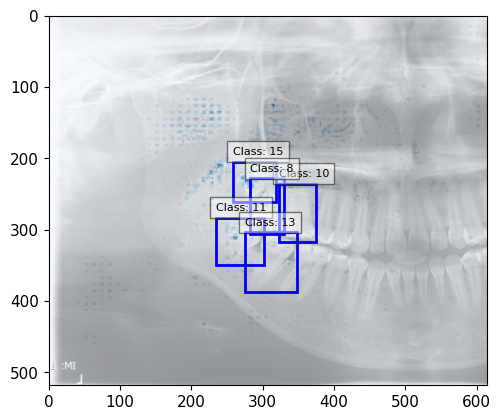

In [ ]:
selected_bboxes_FlipY96_14Y_F_neg = plot_bboxes_on_image_neg(Image_FlipY96_14Y_F_path, df_FlipY96_14Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_FlipY96_14Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,322.082533,235.342707,374.945323,317.685739,0.912389,10,Upper First Molar
1,258.305783,204.774617,318.310747,261.626739,0.906874,15,Upper Third Molar
2,282.499878,227.995905,329.576113,305.717830,0.900147,8,Upper Second Molar
3,234.277528,283.474899,302.024896,349.038183,0.899345,11,Lower Third Molar
4,275.026482,303.703192,347.821782,386.619947,0.895793,13,Lower Second Molar


#### Y98_14Y_F

In [ ]:
#Y98_14Y_F
data= [np.array(shap_values_Y98_14Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

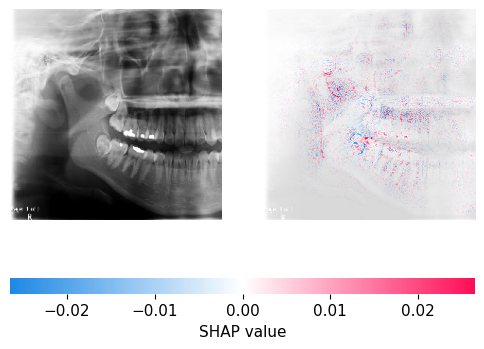

In [ ]:
shap.image_plot(shap_values_Y98_14Y_F, background_test_array[[184]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

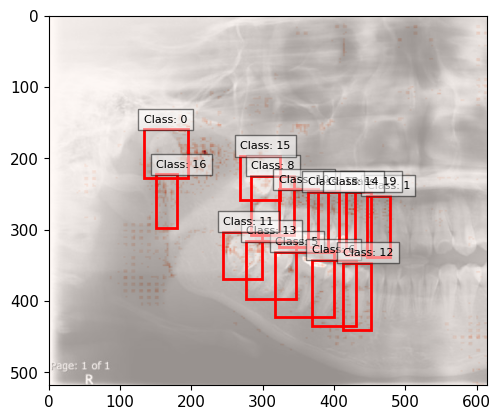

In [ ]:
selected_bboxes_Y98_14Y_F_pos = plot_bboxes_on_image_pos(Image_Y98_14Y_F_path, df_Y98_14Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_Y98_14Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,317.808266,331.112347,399.318105,421.902743,0.927631,5,Lower First Molar
1,276.611691,315.996896,346.344315,396.881569,0.916689,13,Lower Second Molar
2,244.607395,302.754767,299.026740,369.670015,0.912839,11,Lower Third Molar
3,133.462739,159.407809,195.506472,227.712193,0.894524,0,Condyle
4,368.634566,341.832342,431.162691,435.031282,0.892474,6,Lower Second Premolar
5,284.097257,224.560545,343.899765,306.785989,0.890402,8,Upper Second Molar
6,322.383728,243.363345,377.532164,323.687478,0.883718,10,Upper First Molar
7,268.344811,196.910192,323.533065,258.728885,0.873971,15,Upper Third Molar
8,445.419114,252.776145,478.589765,338.715614,0.866414,1,Upper Lateral Incisor
9,416.100324,246.948743,451.643245,335.116800,0.839013,19,Upper Canine


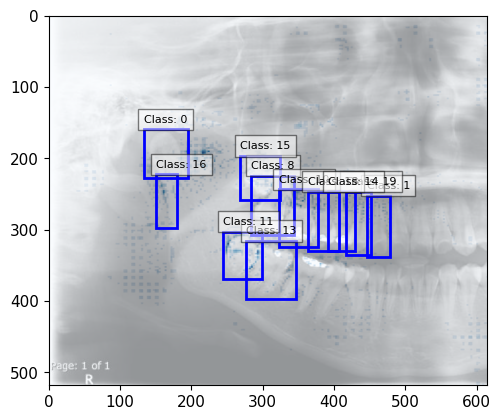

In [ ]:
selected_bboxes_Y98_14Y_F_neg = plot_bboxes_on_image_neg(Image_Y98_14Y_F_path, df_Y98_14Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_Y98_14Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,276.611691,315.996896,346.344315,396.881569,0.916689,13,Lower Second Molar
1,244.607395,302.754767,299.026740,369.670015,0.912839,11,Lower Third Molar
2,133.462739,159.407809,195.506472,227.712193,0.894524,0,Condyle
3,284.097257,224.560545,343.899765,306.785989,0.890402,8,Upper Second Molar
4,322.383728,243.363345,377.532164,323.687478,0.883718,10,Upper First Molar
5,268.344811,196.910192,323.533065,258.728885,0.873971,15,Upper Third Molar
6,445.419114,252.776145,478.589765,338.715614,0.866414,1,Upper Lateral Incisor
7,416.100324,246.948743,451.643245,335.116800,0.839013,19,Upper Canine
8,150.933087,222.556435,179.613640,298.061674,0.804841,16,Posterior border of Ramus
9,362.765538,246.946042,406.207721,329.221334,0.793907,18,Upper Second Premolar


#### Y236_14Y_M

In [ ]:
#Y236_14Y_M
data= [np.array(shap_values_Y236_14Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

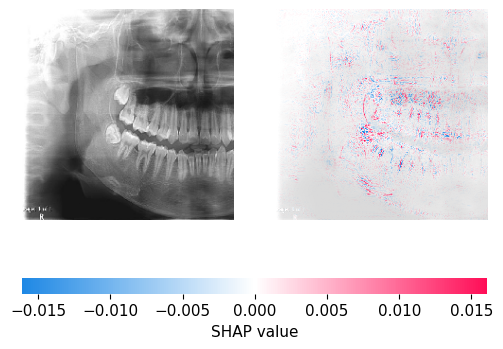

In [ ]:
shap.image_plot(shap_values_Y236_14Y_M, background_test_array[[192]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

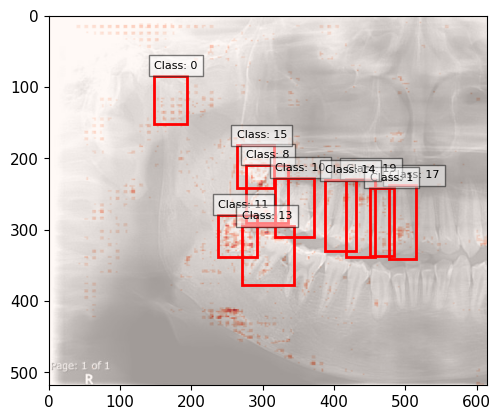

In [ ]:
selected_bboxes_Y236_14Y_M_pos = plot_bboxes_on_image_pos(Image_Y236_14Y_M_path, df_Y236_14Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_Y236_14Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,237.537098,278.720179,291.524468,338.147510,0.910361,11,Lower Third Molar
1,276.692132,208.782759,334.935305,290.364455,0.900538,8,Upper Second Molar
2,476.629543,237.598172,514.866572,341.331330,0.897651,17,Upper Central Incisor
3,416.542821,228.541671,456.845655,337.954633,0.882936,19,Upper Canine
4,449.998748,241.118455,484.604231,337.114920,0.878438,1,Upper Lateral Incisor
5,317.408844,227.587288,371.750676,309.797433,0.869735,10,Upper First Molar
6,263.233859,181.601185,315.846068,241.852065,0.867999,15,Upper Third Molar
7,387.614670,230.737686,431.317351,330.231817,0.854013,14,Upper First Premolar
8,148.204131,84.080789,193.449084,151.613054,0.849904,0,Condyle
9,270.563410,294.885418,343.636082,376.763470,0.771140,13,Lower Second Molar


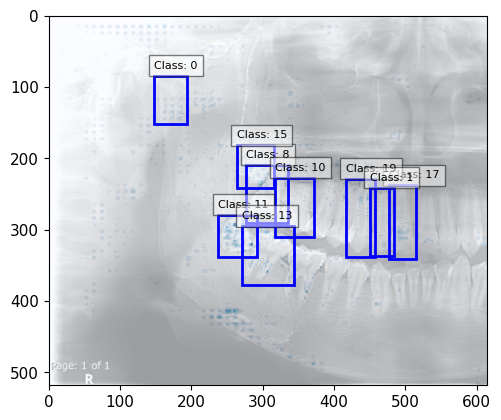

In [ ]:
selected_bboxes_Y236_14Y_M_neg = plot_bboxes_on_image_neg(Image_Y236_14Y_M_path, df_Y236_14Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_Y236_14Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,237.537098,278.720179,291.524468,338.147510,0.910361,11,Lower Third Molar
1,276.692132,208.782759,334.935305,290.364455,0.900538,8,Upper Second Molar
2,476.629543,237.598172,514.866572,341.331330,0.897651,17,Upper Central Incisor
3,416.542821,228.541671,456.845655,337.954633,0.882936,19,Upper Canine
4,449.998748,241.118455,484.604231,337.114920,0.878438,1,Upper Lateral Incisor
5,317.408844,227.587288,371.750676,309.797433,0.869735,10,Upper First Molar
6,263.233859,181.601185,315.846068,241.852065,0.867999,15,Upper Third Molar
7,148.204131,84.080789,193.449084,151.613054,0.849904,0,Condyle
8,270.563410,294.885418,343.636082,376.763470,0.771140,13,Lower Second Molar


#### Y278_14Y_M

In [ ]:
#Y278_14Y_M
data= [np.array(shap_values_Y278_14Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

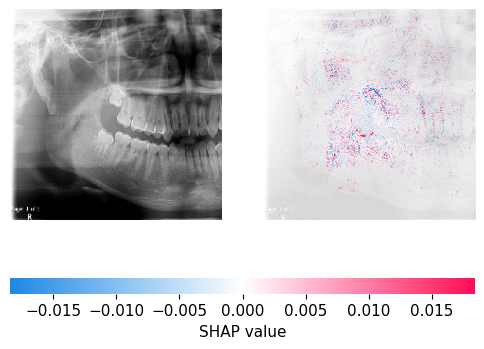

In [ ]:
shap.image_plot(shap_values_Y278_14Y_M, background_test_array[[193]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

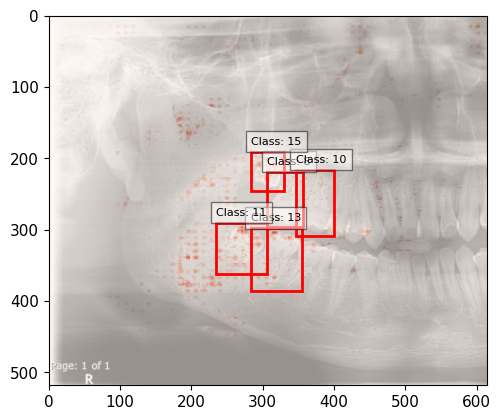

In [ ]:
selected_bboxes_Y278_14Y_M_pos = plot_bboxes_on_image_pos(Image_Y278_14Y_M_path, df_Y278_14Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_Y278_14Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,282.858001,297.718404,354.801501,386.182044,0.917718,13,Lower Second Molar
1,306.012021,218.914133,355.680676,296.557681,0.915441,8,Upper Second Molar
2,346.631127,216.203537,400.321858,309.303368,0.911650,10,Upper First Molar
3,234.964019,290.583051,305.421634,361.954671,0.906008,11,Lower Third Molar
4,283.658785,190.754000,329.240004,245.283782,0.842094,15,Upper Third Molar


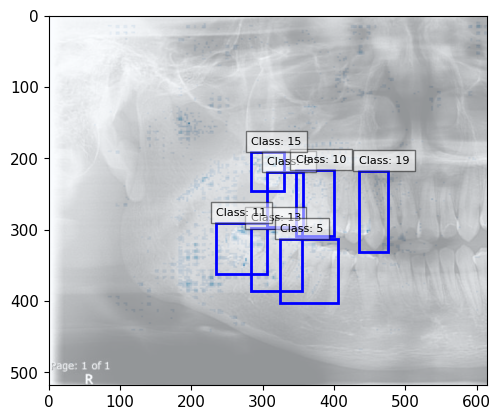

In [ ]:
selected_bboxes_Y278_14Y_M_neg = plot_bboxes_on_image_neg(Image_Y278_14Y_M_path, df_Y278_14Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_Y278_14Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,282.858001,297.718404,354.801501,386.182044,0.917718,13,Lower Second Molar
1,324.271670,312.555762,405.809652,403.351314,0.917663,5,Lower First Molar
2,306.012021,218.914133,355.680676,296.557681,0.915441,8,Upper Second Molar
3,346.631127,216.203537,400.321858,309.303368,0.911650,10,Upper First Molar
4,234.964019,290.583051,305.421634,361.954671,0.906008,11,Lower Third Molar
5,283.658785,190.754000,329.240004,245.283782,0.842094,15,Upper Third Molar
6,434.873909,217.497409,474.943911,330.896591,0.806386,19,Upper Canine


### 15 Year

#### เลือกรูปที่ต้องการหาค่า SHAP Value

In [ ]:
sdf_test

,Age(year),Gender,Folder_type,Folder_name,Path_Name,...,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.423399,7,0.005142,Female,0.0
1,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.415316,7,0.046188,Female,0.0
2,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.492433,7,0.000020,Female,0.0
3,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.343049,7,0.020910,Female,0.0
4,7,F,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,7.095627,7,0.003455,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...
286,22,M,Normal,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.010904,22,0.999999,Male,1.0
287,22,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,21.844440,22,0.999998,Male,1.0
288,23,M,Normal,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,22.836693,23,0.999958,Male,1.0
289,25,F,Normal,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,...,24.869873,25,1.000000,Male,1.0


In [ ]:
from PIL import Image
Image_B153_15Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/15Y/F/Both/B153.jpg')
Image_B153_15Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/15Y/F/Both/B153.jpg'

Image_B157_15Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/15Y/F/Both/B157.jpg')
Image_B157_15Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/15Y/F/Both/B157.jpg'

Image_B162_15Y_F = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/15Y/F/Both/B162.jpg')
Image_B162_15Y_F_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/15Y/F/Both/B162.jpg'

Image_FlipB300_15Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/15Y/M/Both/FlipB300.jpg')
Image_FlipB300_15Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/15Y/M/Both/FlipB300.jpg'

Image_B332_15Y_M = Image.open('/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/15Y/M/Rt/B332.jpg')
Image_B332_15Y_M_path = '/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Data_Cut_images/Test/Normal/15Y/M/Rt/B332.jpg'

In [ ]:
sdf_test.reset_index().iloc[198]

index                                                               198
Age(year)                                                            15
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                       B153.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   15.182503
Age_predict_int                                                      15
Gender_predict                                                 0.672907
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[199]

index                                                               199
Age(year)                                                            15
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                       B157.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   15.056389
Age_predict_int                                                      15
Gender_predict                                                 0.000009
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[201] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               201
Age(year)                                                            15
Gender                                                                F
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                       B162.jpg
Gender_Class                                                          0
Gender_Predict                                                   Female
Age_predict                                                   14.523476
Age_predict_int                                                      15
Gender_predict                                                 0.042212
Gender_predict_str                                               Female
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[205] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               205
Age(year)                                                            15
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                        Both
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                   FlipB300.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                   15.243172
Age_predict_int                                                      15
Gender_predict                                                 0.999869
Gender_predict_str                                                 Male
Gender_predict_int                                              

In [ ]:
sdf_test.reset_index().iloc[208] # check ว่า ตรงไหนจากภาพที่เลทอกมา

index                                                               208
Age(year)                                                            15
Gender                                                                M
Folder_type                                                      Normal
Folder_name                                                          Rt
Path_Name             /content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...
Filename                                                       B332.jpg
Gender_Class                                                          1
Gender_Predict                                                     Male
Age_predict                                                   15.050741
Age_predict_int                                                      15
Gender_predict                                                 0.998153
Gender_predict_str                                                 Male
Gender_predict_int                                              

#### YOLO (detect ตห)

In [ ]:
# YOLO detect ตำแหน่ง
#ภาพ1
results_B153_15Y_F = yolo_model(Image_B153_15Y_F) # results = ผลจากการทำนาย
df_B153_15Y_F = results_B153_15Y_F.pandas().xyxyn[0] #.pandas ทำให้เป็น dataframe // .xyxy ตห.กล่อง ///  n normalization ค่าให้มีค่าอยู่ระหว่าง 0-1 //[0]= index
#ภาพ2
results_B157_15Y_F = yolo_model(Image_B157_15Y_F)
df_B157_15Y_F = results_B157_15Y_F.pandas().xyxyn[0]
#ภาพ3
results_B162_15Y_F = yolo_model(Image_B162_15Y_F)
df_B162_15Y_F = results_B162_15Y_F.pandas().xyxyn[0]
#ภาพ4
results_FlipB300_15Y_M= yolo_model(Image_FlipB300_15Y_M)
df_FlipB300_15Y_M= results_FlipB300_15Y_M.pandas().xyxyn[0]
#ภาพ5
results_B332_15Y_M = yolo_model(Image_B332_15Y_M)
df_B332_15Y_M= results_B332_15Y_M.pandas().xyxyn[0]

##### NMS

In [ ]:
df_B153_15Y_F_filtered_nms = nms_per_class(df_B153_15Y_F,iou_threshold=0.5)
df_B157_15Y_F_filtered_nms = nms_per_class(df_B157_15Y_F,iou_threshold=0.5)
df_B162_15Y_F_filtered_nms = nms_per_class(df_B162_15Y_F,iou_threshold=0.5)
df_FlipB300_15Y_M_filtered_nms = nms_per_class(df_FlipB300_15Y_M,iou_threshold=0.5)
df_B332_15Y_M_filtered_nms = nms_per_class(df_B332_15Y_M,iou_threshold=0.5)

#### SHAP values

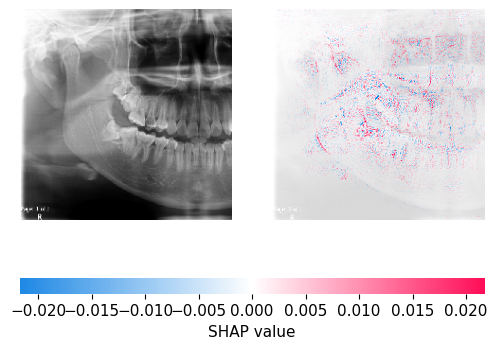

In [ ]:
shap_values_B153_15Y_F = explainer_layer1.shap_values(background_test_array[[198]])
%matplotlib inline
shap.image_plot(shap_values_B153_15Y_F, background_test_array[[198]])

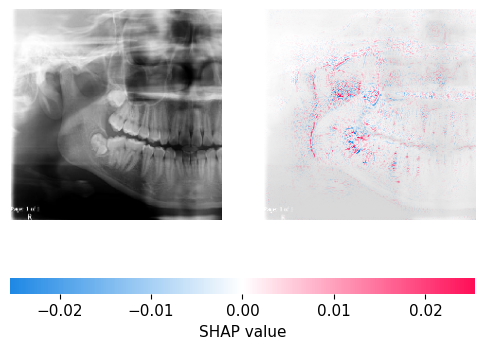

In [ ]:
shap_values_B157_15Y_F = explainer_layer1.shap_values(background_test_array[[199]])
%matplotlib inline
shap.image_plot(shap_values_B157_15Y_F, background_test_array[[199]])

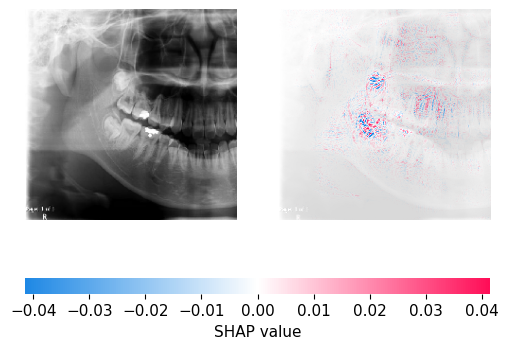

In [ ]:
shap_values_B162_15Y_F = explainer_layer1.shap_values(background_test_array[[201]])
%matplotlib inline
shap.image_plot(shap_values_B162_15Y_F, background_test_array[[201]])

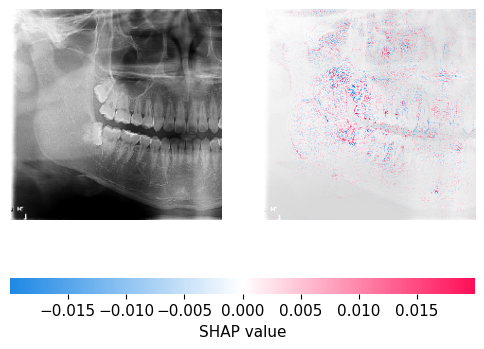

In [ ]:
shap_values_FlipB300_15Y_M= explainer_layer1.shap_values(background_test_array[[205]])
%matplotlib inline
shap.image_plot(shap_values_FlipB300_15Y_M, background_test_array[[205]])

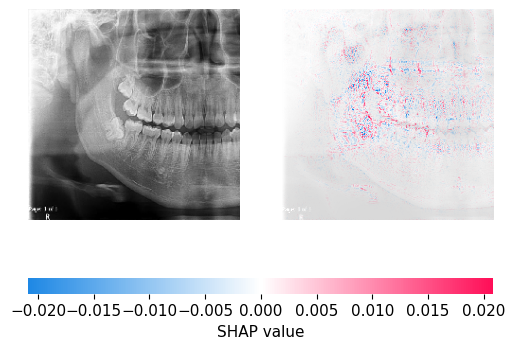

In [ ]:
shap_values_B332_15Y_M = explainer_layer1.shap_values(background_test_array[[208]])
%matplotlib inline
shap.image_plot(shap_values_B332_15Y_M, background_test_array[[208]])

#### convert shap value from RGB to grayscale image

In [ ]:
type(shap_values_B332_15Y_M)

list

#### B153_15Y_F

In [ ]:
#B153_15Y_F
data= [np.array(shap_values_B153_15Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

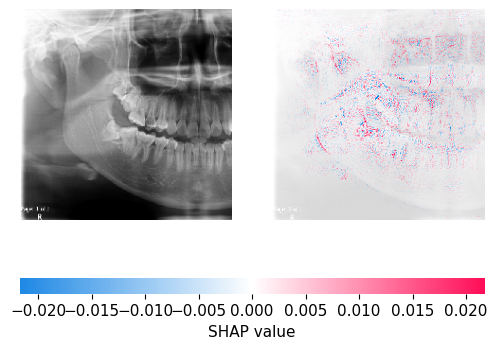

In [ ]:
shap.image_plot(shap_values_B153_15Y_F, background_test_array[[198]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

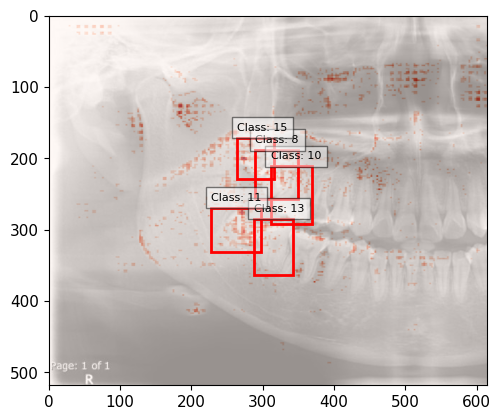

In [ ]:
selected_bboxes_B153_15Y_F_pos = plot_bboxes_on_image_pos(Image_B153_15Y_F_path, df_B153_15Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_B153_15Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,287.248994,284.660260,343.010452,363.586457,0.912712,13,Lower Second Molar
1,227.571959,269.148063,296.940861,330.946949,0.906974,11,Lower Third Molar
2,311.192215,211.011470,369.493211,291.841771,0.905241,10,Upper First Molar
3,289.752685,188.501037,349.751848,256.885434,0.875139,8,Upper Second Molar
4,264.362280,171.465518,315.899793,229.058615,0.854998,15,Upper Third Molar


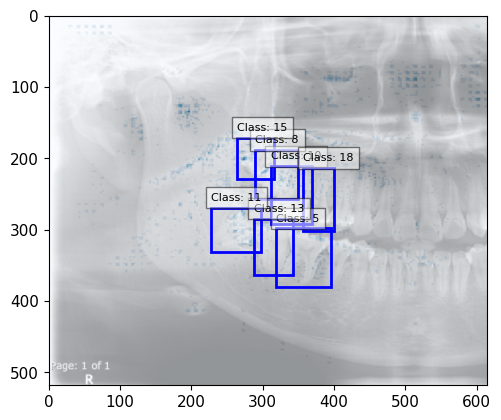

In [ ]:
selected_bboxes_B153_15Y_F_neg = plot_bboxes_on_image_neg(Image_B153_15Y_F_path, df_B153_15Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_B153_15Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,319.225532,298.216668,395.957196,380.035377,0.932650,5,Lower First Molar
1,287.248994,284.660260,343.010452,363.586457,0.912712,13,Lower Second Molar
2,227.571959,269.148063,296.940861,330.946949,0.906974,11,Lower Third Molar
3,311.192215,211.011470,369.493211,291.841771,0.905241,10,Upper First Molar
4,289.752685,188.501037,349.751848,256.885434,0.875139,8,Upper Second Molar
5,356.960409,213.662971,399.711928,302.014195,0.874846,18,Upper Second Premolar
6,264.362280,171.465518,315.899793,229.058615,0.854998,15,Upper Third Molar


#### B157_15Y_F

In [ ]:
#B157_15Y_F
data= [np.array(shap_values_B157_15Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

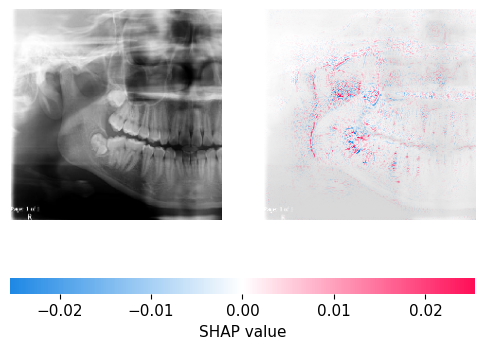

In [ ]:
shap.image_plot(shap_values_B157_15Y_F, background_test_array[[199]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

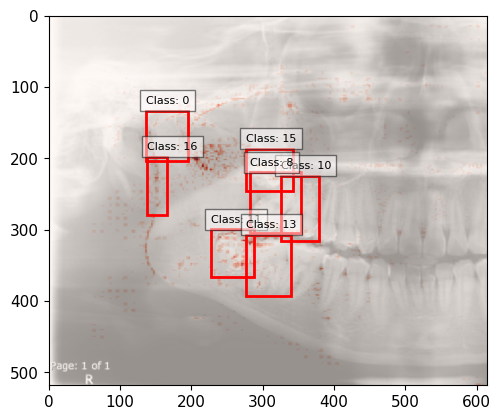

In [ ]:
selected_bboxes_B157_15Y_F_pos = plot_bboxes_on_image_pos(Image_B157_15Y_F_path, df_B157_15Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_B157_15Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,227.044520,299.653291,288.317926,366.925240,0.915220,11,Lower Third Molar
1,324.893531,224.403405,378.918650,316.037065,0.905876,10,Upper First Molar
2,281.883782,219.650229,354.181763,305.007515,0.901912,8,Upper Second Molar
3,276.506987,186.459105,341.765999,246.361512,0.883686,15,Upper Third Molar
4,136.334443,132.959644,194.952609,203.533974,0.882221,0,Condyle
5,276.877223,307.380799,340.098664,393.169782,0.875391,13,Lower Second Molar
6,137.977230,197.829440,166.093590,279.468316,0.786932,16,Posterior border of Ramus


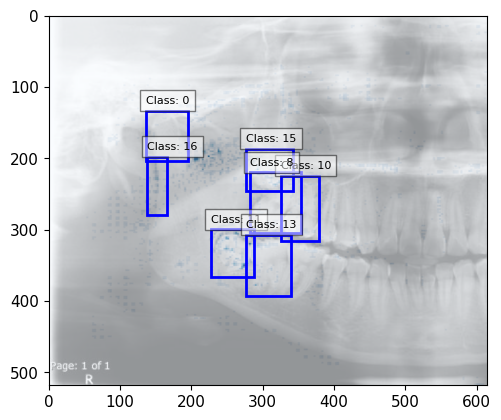

In [ ]:
selected_bboxes_B157_15Y_F_neg = plot_bboxes_on_image_neg(Image_B157_15Y_F_path, df_B157_15Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_B157_15Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,227.044520,299.653291,288.317926,366.925240,0.915220,11,Lower Third Molar
1,324.893531,224.403405,378.918650,316.037065,0.905876,10,Upper First Molar
2,281.883782,219.650229,354.181763,305.007515,0.901912,8,Upper Second Molar
3,276.506987,186.459105,341.765999,246.361512,0.883686,15,Upper Third Molar
4,136.334443,132.959644,194.952609,203.533974,0.882221,0,Condyle
5,276.877223,307.380799,340.098664,393.169782,0.875391,13,Lower Second Molar
6,137.977230,197.829440,166.093590,279.468316,0.786932,16,Posterior border of Ramus


#### B162_15Y_F

In [ ]:
#B162_15Y_F
data= [np.array(shap_values_B162_15Y_F)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

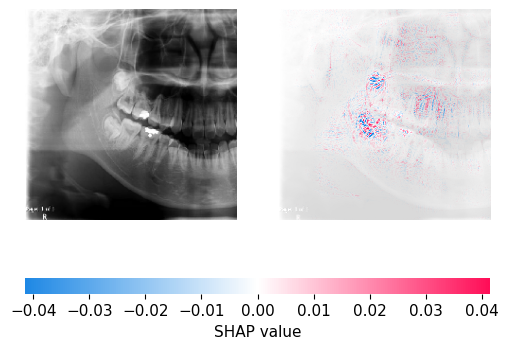

In [ ]:
shap.image_plot(shap_values_B162_15Y_F, background_test_array[[201]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

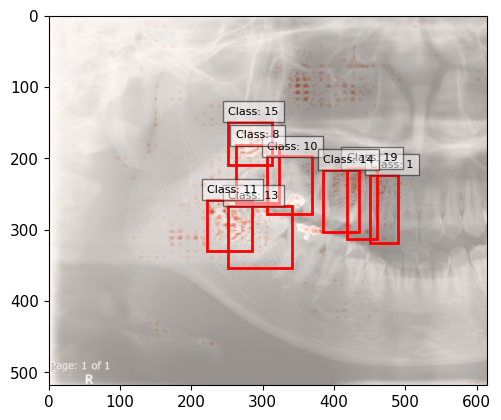

In [ ]:
selected_bboxes_B162_15Y_F_pos = plot_bboxes_on_image_pos(Image_B162_15Y_F_path, df_B162_15Y_F_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_B162_15Y_F_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,251.547295,266.709909,340.492121,353.602835,0.931193,13,Lower Second Molar
1,222.236977,258.278199,284.622867,329.855109,0.906067,11,Lower Third Molar
2,251.380576,149.051647,313.467832,208.838859,0.896689,15,Upper Third Molar
3,306.410821,197.301999,369.145903,277.328665,0.890498,10,Upper First Molar
4,262.094367,181.540052,322.378678,262.521070,0.888044,8,Upper Second Molar
5,450.786174,223.053032,489.800785,318.601806,0.869892,1,Upper Lateral Incisor
6,417.573839,213.690759,460.600935,312.412254,0.865394,19,Upper Canine
7,384.937983,215.618190,434.576556,303.666944,0.862307,14,Upper First Premolar


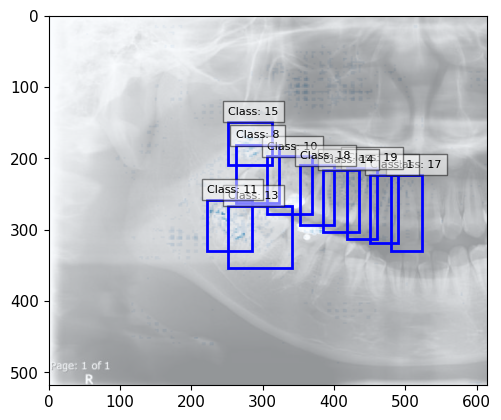

In [ ]:
selected_bboxes_B162_15Y_F_neg = plot_bboxes_on_image_neg(Image_B162_15Y_F_path, df_B162_15Y_F_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_B162_15Y_F_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,251.547295,266.709909,340.492121,353.602835,0.931193,13,Lower Second Molar
1,222.236977,258.278199,284.622867,329.855109,0.906067,11,Lower Third Molar
2,251.380576,149.051647,313.467832,208.838859,0.896689,15,Upper Third Molar
3,479.971238,223.232417,523.156142,329.432304,0.896572,17,Upper Central Incisor
4,306.410821,197.301999,369.145903,277.328665,0.890498,10,Upper First Molar
5,262.094367,181.540052,322.378678,262.521070,0.888044,8,Upper Second Molar
6,450.786174,223.053032,489.800785,318.601806,0.869892,1,Upper Lateral Incisor
7,417.573839,213.690759,460.600935,312.412254,0.865394,19,Upper Canine
8,384.937983,215.618190,434.576556,303.666944,0.862307,14,Upper First Premolar
9,352.708174,209.758971,399.628193,293.538951,0.860772,18,Upper Second Premolar


#### FlipB300_15Y_M

In [ ]:
#FlipB300_15Y_M
data= [np.array(shap_values_FlipB300_15Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

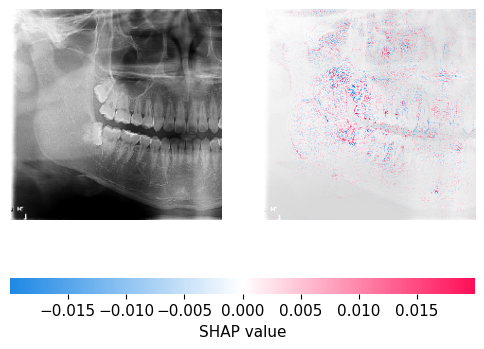

In [ ]:
shap.image_plot(shap_values_FlipB300_15Y_M, background_test_array[[205]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

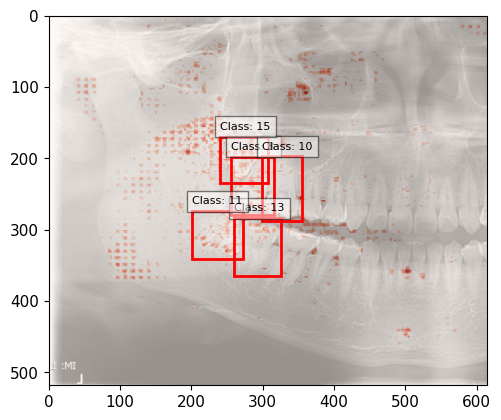

In [ ]:
selected_bboxes_FlipB300_15Y_M_pos = plot_bboxes_on_image_pos(Image_FlipB300_15Y_M_path, df_FlipB300_15Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_FlipB300_15Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,256.153407,198.093222,316.108507,278.778873,0.916297,8,Upper Second Molar
1,299.298639,197.345672,354.299789,288.140946,0.910801,10,Upper First Molar
2,259.962284,283.916569,326.193282,365.437827,0.905293,13,Lower Second Molar
3,201.165121,274.108195,272.770115,341.320987,0.894554,11,Lower Third Molar
4,240.746092,169.774452,306.899284,234.389512,0.884244,15,Upper Third Molar


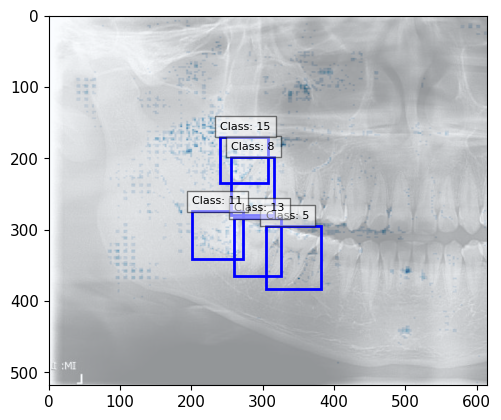

In [ ]:
selected_bboxes_FlipB300_15Y_M_neg = plot_bboxes_on_image_neg(Image_FlipB300_15Y_M_path, df_FlipB300_15Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_FlipB300_15Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,304.496162,294.608128,381.924273,382.533058,0.926907,5,Lower First Molar
1,256.153407,198.093222,316.108507,278.778873,0.916297,8,Upper Second Molar
2,259.962284,283.916569,326.193282,365.437827,0.905293,13,Lower Second Molar
3,201.165121,274.108195,272.770115,341.320987,0.894554,11,Lower Third Molar
4,240.746092,169.774452,306.899284,234.389512,0.884244,15,Upper Third Molar


#### B332_15Y_M

In [ ]:
#B332_15Y_M
data= [np.array(shap_values_B332_15Y_M)] # change list to array
image_array = data[0] # index ใน list ที่ เก็บ array
positive =np.where(image_array >= 0, image_array, 0) #แยก positve กับ negative ค่าที่เป็น negative จะเติม 0
negative = np.where(image_array < 0, image_array, 0)#แยก negative  กับ positve ค่าที่เป็น positve จะเติม 0
negative_aps =  np.abs(negative)

flattened_array_pos = positive.flatten()
flattened_array_neg = negative_aps.flatten()

normalized_array_pos = (flattened_array_pos - np.min(flattened_array_pos)) / (np.max(flattened_array_pos) - np.min(flattened_array_pos))
normalized_array_neg = (flattened_array_neg - np.min(flattened_array_neg)) / (np.max(flattened_array_neg) - np.min(flattened_array_neg))

normalized_positive = normalized_array_pos.reshape(positive.shape)
normalized_neg = normalized_array_neg.reshape(negative_aps.shape)


grayscale_image_pos = normalized_positive/ 3.0
grayscale_image_neg = normalized_neg/ 3.0

grayscale_image_positive = np.mean(grayscale_image_pos, axis=4)
grayscale_image_negative = np.mean(grayscale_image_neg, axis=4)

grayscale_image_positive = grayscale_image_positive.squeeze()
grayscale_image_negative = grayscale_image_negative.squeeze()

##### more than 95 percentaile

In [ ]:
percentile_95_pos = np.percentile(grayscale_image_positive, 95) # เลือกค่า grayscale_image ที่มี percentaile more than 95
percentile_95_neg = np.percentile(grayscale_image_negative, 95)

grayscale_pos_thresholded = grayscale_image_positive
grayscale_neg_thresholded = grayscale_image_negative


grayscale_pos_thresholded[grayscale_pos_thresholded < percentile_95_pos] = 0 #ถ้ามีค่าน้อยกว่า 95 จะให้เป็น 0
grayscale_neg_thresholded[grayscale_neg_thresholded < percentile_95_neg] = 0

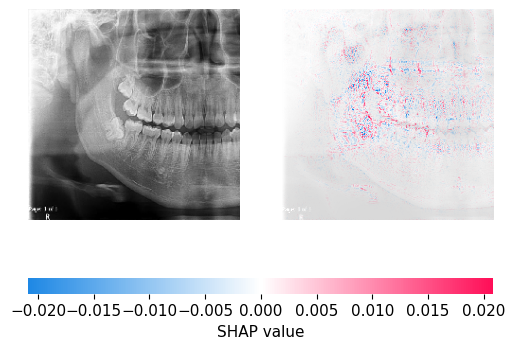

In [ ]:
shap.image_plot(shap_values_B332_15Y_M, background_test_array[[208]])

plot_bboxes_on_image_pos(image_path, img_nms, grayscale_thresholded_>95)

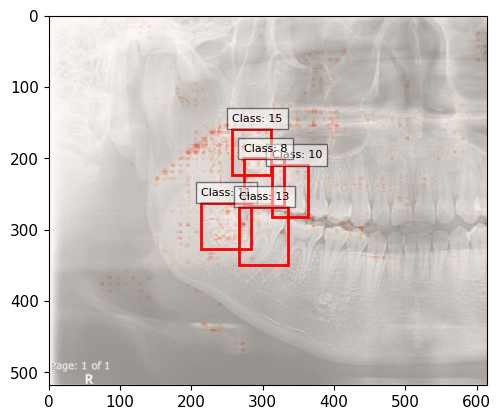

In [ ]:
selected_bboxes_B332_15Y_M_pos = plot_bboxes_on_image_pos(Image_B332_15Y_M_path, df_B332_15Y_M_filtered_nms, grayscale_pos_thresholded)
%matplotlib inline

In [ ]:
pd.DataFrame(selected_bboxes_B332_15Y_M_pos)

,xmin,ymin,xmax,ymax,confidence,class,name
0,213.941533,262.475498,283.055937,327.102337,0.922360,11,Lower Third Molar
1,267.056918,267.538507,335.708055,349.758100,0.921462,13,Lower Second Molar
2,312.274213,209.512818,363.214660,282.438944,0.908933,10,Upper First Molar
3,272.992644,199.955229,329.942707,267.254641,0.903136,8,Upper Second Molar
4,257.442801,158.435641,311.608655,223.343321,0.879103,15,Upper Third Molar


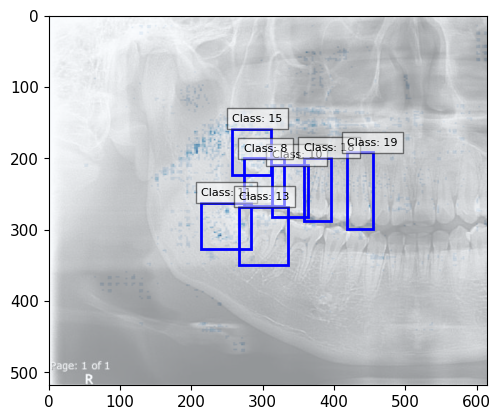

In [ ]:
selected_bboxes_B332_15Y_M_neg = plot_bboxes_on_image_neg(Image_B332_15Y_M_path, df_B332_15Y_M_filtered_nms, grayscale_neg_thresholded)

In [ ]:
pd.DataFrame(selected_bboxes_B332_15Y_M_neg)

,xmin,ymin,xmax,ymax,confidence,class,name
0,213.941533,262.475498,283.055937,327.102337,0.922360,11,Lower Third Molar
1,267.056918,267.538507,335.708055,349.758100,0.921462,13,Lower Second Molar
2,312.274213,209.512818,363.214660,282.438944,0.908933,10,Upper First Molar
3,272.992644,199.955229,329.942707,267.254641,0.903136,8,Upper Second Molar
4,357.786848,199.468188,395.605607,287.899872,0.879794,18,Upper Second Premolar
5,257.442801,158.435641,311.608655,223.343321,0.879103,15,Upper Third Molar
6,418.621508,191.575559,454.988600,299.111493,0.866833,19,Upper Canine
